# Preliminary analysis of MFI atlas (scRNA-seq + snRNA-seq)

Here I:

- predict labels from Vento-Tormo, Efremova et al., 2018 using logistic regression
- caluclate preliminary manifold with no batch correction (to see the effect of batch)
- assign souporcell cluster labels to deconvolute individuals in multiplexed data and M/F origin in samples that are not multiplexed (where applicable)
- label all doublets to be excluded later on: inter-individual doublets (by souporcell) and GEX doublets (by scrublet, playing with the cutoff fot `bh_pval`)
- save this all to then proceed to notebook M1 (prep for scVI: CCG calculation and figuring out number of optimal PCs / latent variables)

11.2021

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import glob
import anndata
import bbknn
import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [4]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202111_MFI_sc_sn_new_scVI_analysis/'

## Reading in raw filtered test data

As produced in M0 notebook

In [5]:
# takes a few minutes
adata = sc.read(save_path + 'adata_raw_filtered.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_cells-18', 'gene_ids-19', 'feature_types-1

In [7]:
# raw counts in .X
adata.obs['dataset'].value_counts()

Ashley_collection_sn          168507
HDBR_new                      109182
Vento_Nature                  100329
samples_MFI_new_sc_batch_2     41576
samples_MFI_new_sc_batch_1     10542
Name: dataset, dtype: int64

### As for training data, let's use annotations from Vento-Tormo data on the corresponding data subset of the 10X samples from Vento-Tormo we're using here (for consistency of genomes, cellranger versions etc.)

In [8]:
# reading in filtered and annotated data from Vento-Tormo
# provided by Krzysztof Polanski in 2019

adata_VT = sc.read('/home/jovyan/notebooks/Vento_Lab/Data_integration_Suryawanshi_Vento_July2019/Roser_10X_annotated_filtered.h5ad')

In [9]:
# annotation is in 'annot' here
adata_VT

AnnData object with n_obs × n_vars = 64734 × 24466
    obs: 'batch', 'n_genes', 'percent_mito', 'n_counts', 'loc', 'annot'
    var: 'n_cells-0', 'n_cells-1', 'n_cells-2', 'n_cells-3', 'n_cells-4', 'n_cells-5', 'n_cells-6', 'n_cells-7', 'n_cells-8', 'n_cells-9', 'n_cells-10', 'n_cells-11', 'n_cells-12', 'n_cells-13', 'n_cells-14', 'n_cells-15', 'n_cells-16', 'n_cells-17', 'n_cells-18', 'n_cells-19', 'n_cells-20', 'n_cells-21', 'n_cells-22', 'n_cells-23', 'n_cells-24'

In [10]:
adata_VT.obs['annot'].value_counts()

0_dS1              7090
1_VCT              7063
2_dNK2             5412
3_dS2              4599
4_Tcells           3967
5_dNK1             3803
6_dM2              2791
7_dM1              2574
9_VCT              2279
12_F1              2176
11_dNK3            1987
13_EVT             1950
10_Tcells          1760
15_Tcells          1591
16_EVT             1553
8_Tcells           1456
17_NK              1454
18_HB              1302
20_SCT             1238
14.1_PV1           1033
21_dS3              895
22_M3               887
23_MO               887
19.1_Endo (m)       844
14.2_PV2            805
24_dNKp             730
19.2_Endo L         345
26_Plasma           340
27_DC1              324
28_DC2              316
30_Granulocytes     245
31_NK CD16          230
25.1_Epi1           219
32_ILC3             186
25.2_Epi2           175
33_F2               112
19.3_Endo (f)        98
29_MO                18
Name: annot, dtype: int64

In [11]:
adata_VT.obs

,batch,n_genes,percent_mito,n_counts,loc,annot
index,,,,,,
FCA7167219_AAACGGGAGCTAGTTC,0,617,0.189297,1252.0,Decidua,2_dNK2
FCA7167219_AAACGGGCATTGGCGC,0,2127,0.083197,6707.0,Decidua,5_dNK1
FCA7167219_AAACGGGTCGCGATCG,0,1486,0.010730,4194.0,Decidua,8_Tcells
FCA7167219_AAAGATGAGCAATATG,0,1800,0.020222,5489.0,Decidua,10_Tcells
FCA7167219_AAAGATGAGTTCGCGC,0,2384,0.043327,8309.0,Decidua,5_dNK1
...,...,...,...,...,...,...
FCA7511884_TTTGGTTGTTAAAGAC,24,2222,0.029508,6439.0,Placenta,12_F1
FCA7511884_TTTGGTTTCCATGCTC,24,5331,0.044874,45260.0,Placenta,9_VCT
FCA7511884_TTTGTCACACCGAAAG,24,2671,0.004605,13899.0,Placenta,16_EVT


In [12]:
adata.obs['sample_barcode'] = [elem.split('_')[1] + '_' + elem.split('_')[0] for elem in adata.obs.index]
# get rid of '-1'
adata.obs['sample_barcode'] = [elem.split('-1')[0] for elem in adata.obs['sample_barcode']]

In [13]:
# is a bit less than len(adata_VT) since we filtered cells differently in preprocessing
len(set(adata.obs['sample_barcode']) & set(adata_VT.obs.index))

64693

In [14]:
adata.obs['barcode_sample_copy'] = adata.obs.index

In [15]:
idx_for_training = list(adata.obs.set_index('sample_barcode').loc[list(set(adata.obs['sample_barcode']) & set(adata_VT.obs.index)),:]['barcode_sample_copy'])

In [16]:
len(idx_for_training)

64693

In [17]:
# training dataset before HVG calculation
adata_VT_to_use = adata[idx_for_training,:].copy()

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [18]:
# assigning cell type labels from Vento-Tormo dataset
# raw counts in .X
adata_VT_to_use.obs['annot_Vento-Tormo'] = [adata_VT.obs.loc[sample_barcode,'annot'] for sample_barcode in adata_VT_to_use.obs['sample_barcode']]

In [19]:
adata_VT_to_use.obs['annot_Vento-Tormo'].value_counts()

0_dS1              7090
1_VCT              7061
2_dNK2             5409
3_dS2              4599
4_Tcells           3962
5_dNK1             3788
6_dM2              2788
7_dM1              2571
9_VCT              2279
12_F1              2176
11_dNK3            1987
13_EVT             1950
10_Tcells          1759
15_Tcells          1590
16_EVT             1552
8_Tcells           1456
17_NK              1451
18_HB              1301
20_SCT             1238
14.1_PV1           1033
21_dS3              894
22_M3               887
23_MO               885
19.1_Endo (m)       844
14.2_PV2            805
24_dNKp             730
19.2_Endo L         345
26_Plasma           340
27_DC1              324
28_DC2              316
30_Granulocytes     245
31_NK CD16          230
25.1_Epi1           219
32_ILC3             186
25.2_Epi2           175
33_F2               112
19.3_Endo (f)        98
29_MO                18
Name: annot_Vento-Tormo, dtype: int64

In [20]:
# save also to use in label transfer to ATAC data
adata_VT_to_use.write(save_path + 'adata_Vento_Tormo_for_logreg_training.h5ad')


... storing 'annot_Vento-Tormo' as categorical


# LOGISTIC REGRESSION

### Predicting cell type labels from annotated 10X data from Vento-Tormo, Efremova et al., Nature 2018 onto joint sc + sn object

#### Using HVGs of the training object

### Subsetting both datasets' copies to common genes only

I will train logreg on the subsetted data and tranfer the annotation onto the corresponding subsetted new data and then transfer that onto the full (with all genes) new dataset

normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:12)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


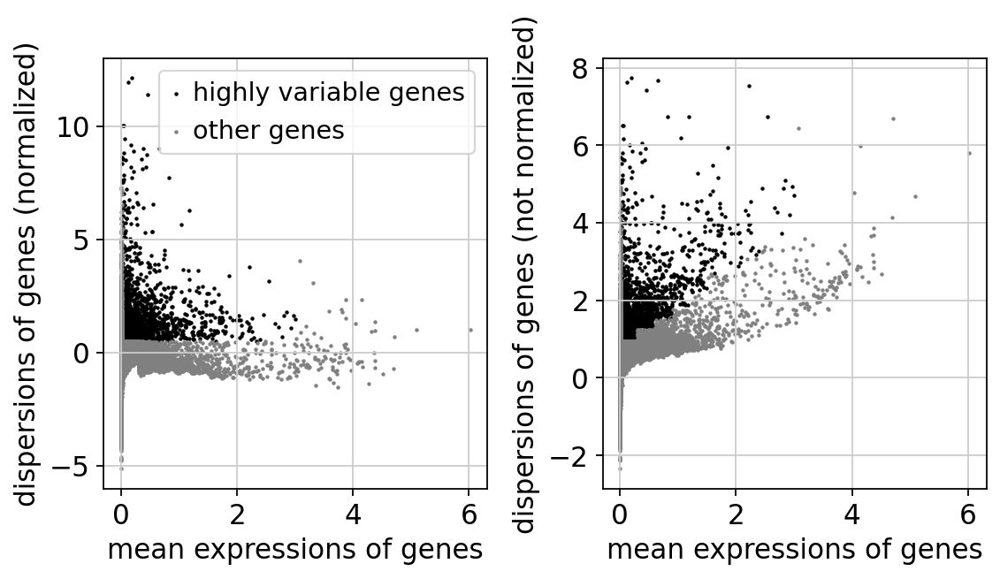

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [20]:
# get training object to normlog, HVG-subsetted and scaled state

adata_train = adata_VT_to_use.copy()

# normalise and log transform
sc.pp.normalize_per_cell(adata_train, counts_per_cell_after=1e4)
sc.pp.log1p(adata_train)

# saving the raw attribute
adata_train.raw = adata_train.copy()

adata_train.var_names_make_unique()
adata_train.obs_names_make_unique()

sc.pp.highly_variable_genes(adata_train, min_mean=0.0125, max_mean=3, min_disp=0.5)

sc.pl.highly_variable_genes(adata_train)

adata_train = adata_train[:, adata_train.var['highly_variable']]

sc.pp.scale(adata_train, max_value=10)

In [21]:
# now in adata_train.X data is normalised. log tr, scaled and HVG-subsetted
adata_train

AnnData object with n_obs × n_vars = 64693 × 3116
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy', 'annot_Vento-Tormo'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18'

In [22]:
adata_test = adata.copy()

# normalise, log transform and scale
# normalise and log transform
sc.pp.normalize_per_cell(adata_test, counts_per_cell_after=1e4)
sc.pp.log1p(adata_test)
# saving the raw attribute
adata_test.raw = adata_test.copy()
adata_test.var_names_make_unique()
adata_test.obs_names_make_unique()

# to reduce memory consumption, let's subset to the overlap b/w HVGs of the adata_train and all filtered genes of adata_test
adata_test = adata_test[:,list(set(adata_test.var_names) & set(adata_train.var_names))].copy()

sc.pp.scale(adata_test, max_value=10)

# now in adata_test.X data is normalised. log tr and scaled
adata_test

AnnData object with n_obs × n_vars = 430136 × 3116
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_ce

In [23]:
adata_train.obs['annot_Vento-Tormo'].value_counts()

0_dS1              7090
1_VCT              7061
2_dNK2             5409
3_dS2              4599
4_Tcells           3962
5_dNK1             3788
6_dM2              2788
7_dM1              2571
9_VCT              2279
12_F1              2176
11_dNK3            1987
13_EVT             1950
10_Tcells          1759
15_Tcells          1590
16_EVT             1552
8_Tcells           1456
17_NK              1451
18_HB              1301
20_SCT             1238
14.1_PV1           1033
21_dS3              894
22_M3               887
23_MO               885
19.1_Endo (m)       844
14.2_PV2            805
24_dNKp             730
19.2_Endo L         345
26_Plasma           340
27_DC1              324
28_DC2              316
30_Granulocytes     245
31_NK CD16          230
25.1_Epi1           219
32_ILC3             186
25.2_Epi2           175
33_F2               112
19.3_Endo (f)        98
29_MO                18
Name: annot_Vento-Tormo, dtype: int64

___________

In [24]:
adata_train.obs.columns

Index(['n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset', 'run', 'number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score',
       'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy',
       'annot_Vento-Tormo'],
      dtype='object')

In [25]:
# list of genes shared between blood and bone marrow data
# doing sorted on the overall list is VERY important for consistent ordering of the genes
common_genes = sorted(list(set(adata_train.var_names) & set(adata_test.var_names)))
print(len(common_genes),"genes are shared between annotated train and our joint data \n",
      len(set(adata_train.var_names)), 'genes in training data \n',
      len((set(adata_test.var_names))), 'genes in test joint data \n')

3116 genes are shared between annotated train and our joint data 
 3116 genes in training data 
 3116 genes in test joint data 



Going to copy a joint dataset with only common genes, but then transfer annotation from logreg onto the full dataset

In [26]:
adata_train_copy = adata_train[:,common_genes]

In [27]:
adata_train_copy.var_names

Index(['A2M', 'A2M-AS1', 'ABCA1', 'ABCA2', 'ABCA7', 'ABCB1', 'ABCG1', 'ABHD15',
       'ABHD17B', 'ABHD2',
       ...
       'ZNF792', 'ZNF81', 'ZNF827', 'ZNF831', 'ZNF836', 'ZNFX1', 'ZRSR2',
       'ZSCAN16', 'ZSWIM4', 'ZSWIM6'],
      dtype='object', length=3116)

In [28]:
adata_test_copy = adata_test[:,common_genes]
adata_test_copy.var_names

Index(['A2M', 'A2M-AS1', 'ABCA1', 'ABCA2', 'ABCA7', 'ABCB1', 'ABCG1', 'ABHD15',
       'ABHD17B', 'ABHD2',
       ...
       'ZNF792', 'ZNF81', 'ZNF827', 'ZNF831', 'ZNF836', 'ZNFX1', 'ZRSR2',
       'ZSCAN16', 'ZSWIM4', 'ZSWIM6'],
      dtype='object', length=3116)

In [29]:
# checking gene correspondence - important!
list(adata_test_copy.var_names) == list(adata_train_copy.var_names)

True

In [30]:
adata_train_copy

View of AnnData object with n_obs × n_vars = 64693 × 3116
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy', 'annot_Vento-Tormo'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_t

In [31]:
np.unique(adata_train_copy.obs['annot_Vento-Tormo'],return_counts=True)

(array(['0_dS1', '10_Tcells', '11_dNK3', '12_F1', '13_EVT', '14.1_PV1',
        '14.2_PV2', '15_Tcells', '16_EVT', '17_NK', '18_HB',
        '19.1_Endo (m)', '19.2_Endo L', '19.3_Endo (f)', '1_VCT', '20_SCT',
        '21_dS3', '22_M3', '23_MO', '24_dNKp', '25.1_Epi1', '25.2_Epi2',
        '26_Plasma', '27_DC1', '28_DC2', '29_MO', '2_dNK2',
        '30_Granulocytes', '31_NK CD16', '32_ILC3', '33_F2', '3_dS2',
        '4_Tcells', '5_dNK1', '6_dM2', '7_dM1', '8_Tcells', '9_VCT'],
       dtype=object),
 array([7090, 1759, 1987, 2176, 1950, 1033,  805, 1590, 1552, 1451, 1301,
         844,  345,   98, 7061, 1238,  894,  887,  885,  730,  219,  175,
         340,  324,  316,   18, 5409,  245,  230,  186,  112, 4599, 3962,
        3788, 2788, 2571, 1456, 2279]))

## Training a logistic regression model on previously annotated 10X data from Roser+Suryawanshi

In [32]:
adata_train_copy.obs['annot_Vento-Tormo'].head()

barcode_sample
GGCTGGTCAAGCTGGA-1_FCA7474064      13_EVT
GCTCCTACAACACCCG-1_FCA7167226       3_dS2
AGCTTGAAGGATCGCA-1_FCA7474068      16_EVT
CCACGGAGTATCACCA-1_FCA7196224    8_Tcells
GCTGCAGAGGGCATGT-1_FCA7196224     24_dNKp
Name: annot_Vento-Tormo, dtype: object

In [33]:
celltypes_train = adata_train_copy.obs['annot_Vento-Tormo']

In [34]:
adata_train_copy.X.shape

(64693, 3116)

Using ONLY COMMON GENES

In [35]:
%time
# training a logistic regression model on annotated 10X scRNA-seq data from Vento-Tormo
# takes about an hour - hour ten
logisticRegr_sc = LogisticRegression(max_iter = 10000, n_jobs = -1, random_state = 0, C=0.2)
logisticRegr_sc.fit(adata_train_copy.X, celltypes_train)

CPU times: user 2 µs, sys: 0 ns, total: 2 µs
Wall time: 4.77 µs


LogisticRegression(C=0.2, max_iter=10000, n_jobs=-1, random_state=0)

In [35]:
# Load model (scRNA-seq) from file

pkl_filename = "./logreg_models/logreg_from_VT_to_all_data_HVGs.pkl"

with open(pkl_filename, 'rb') as file:  
    logisticRegr_sc = pickle.load(file)

In [36]:
adata_train_copy

View of AnnData object with n_obs × n_vars = 64693 × 3116
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy', 'annot_Vento-Tormo'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_t

In [37]:
adata_test_copy

View of AnnData object with n_obs × n_vars = 430136 × 3116
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'sample_barcode', 'barcode_sample_copy'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18

In [38]:
logisticRegr_sc

LogisticRegression(C=0.2, max_iter=10000, n_jobs=-1, random_state=0)

In [39]:
%%time
predictions = logisticRegr_sc.predict(adata_test_copy.X)
adata_test_copy.obs['celltype_predictions'] = predictions

Trying to set attribute `.obs` of view, copying.


CPU times: user 7.03 s, sys: 3.99 s, total: 11 s
Wall time: 11 s


In [40]:
%%time
# probabilities
probabilities = logisticRegr_sc.predict_proba(adata_test_copy.X)
probs_adata = []
for i,clus in enumerate(adata_test_copy.obs['celltype_predictions']):
    probs_adata.append(probabilities[i,logisticRegr_sc.classes_==clus][0])


CPU times: user 4.4 s, sys: 580 ms, total: 4.98 s
Wall time: 4.98 s


In [42]:
list(adata_test_copy.obs.index) == list(adata.obs.index)

True

In [43]:
adata_test_copy.obs['celltype_predictions']

barcode_sample
AAACGGGCATTGGCGC-1_FCA7167219            5_dNK1
AAACGGGTCGCGATCG-1_FCA7167219          8_Tcells
AAAGATGAGCAATATG-1_FCA7167219            2_dNK2
AAAGATGAGTTCGCGC-1_FCA7167219            5_dNK1
AAAGATGCATGTCGAT-1_FCA7167219          8_Tcells
                                         ...   
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920       0_dS1
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920      20_SCT
TTTGTTGGTCACAGCG-1_Pla_Camb10714920       18_HB
TTTGTTGGTTTACTTG-1_Pla_Camb10714920      16_EVT
TTTGTTGGTTTGAGCA-1_Pla_Camb10714920      16_EVT
Name: celltype_predictions, Length: 430136, dtype: object

In [44]:
predictions_probs_df = pd.DataFrame(index = adata_test_copy.obs_names)

In [45]:
predictions_probs_df['probabilities'] = probs_adata
predictions_probs_df['celltype_predictions'] = adata_test_copy.obs['celltype_predictions']


In [46]:
predictions_probs_df

,probabilities,celltype_predictions
barcode_sample,,
AAACGGGCATTGGCGC-1_FCA7167219,1.000000,5_dNK1
AAACGGGTCGCGATCG-1_FCA7167219,1.000000,8_Tcells
AAAGATGAGCAATATG-1_FCA7167219,0.999998,2_dNK2
AAAGATGAGTTCGCGC-1_FCA7167219,1.000000,5_dNK1
AAAGATGCATGTCGAT-1_FCA7167219,1.000000,8_Tcells
...,...,...
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,0.957605,0_dS1
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,1.000000,20_SCT
TTTGTTGGTCACAGCG-1_Pla_Camb10714920,0.989358,18_HB


In [47]:
predictions_probs_df.to_csv(save_path + 'predictions_probs_df_from_VT_to_all_MFI_data_20211111.csv')

In [8]:
# read in predictions table and assign them here
predictions_probs_df = pd.read_csv(save_path + 'predictions_probs_df_from_VT_to_all_MFI_data_20211111.csv', index_col=0)

adata.obs['celltype_predictions'] = predictions_probs_df.loc[adata.obs_names,'celltype_predictions']
adata.obs['probabilities'] = predictions_probs_df.loc[adata.obs_names,'probabilities']

# Adding souporcell results

M/F deconvolution or R0/R1 deconvolution for Pla_HDBR8768477, Pla_HDBR8715512 and Pla_HDBR8715514 (multiplexed samples)

In [9]:
samples = list(np.unique(adata.obs['sample']))
samples

['FCA7167219',
 'FCA7167221',
 'FCA7167222',
 'FCA7167223',
 'FCA7167224',
 'FCA7167226',
 'FCA7167230',
 'FCA7167231',
 'FCA7167232',
 'FCA7196218',
 'FCA7196219',
 'FCA7196220',
 'FCA7196224',
 'FCA7196225',
 'FCA7196226',
 'FCA7196229',
 'FCA7196231',
 'FCA7474062',
 'FCA7474063',
 'FCA7474064',
 'FCA7474065',
 'FCA7474066',
 'FCA7474068',
 'FCA7474069',
 'FCA7511881',
 'FCA7511882',
 'FCA7511883',
 'FCA7511884',
 'FCA7511885',
 'FCA7511886',
 'Pla_Camb10691970',
 'Pla_Camb10691971',
 'Pla_Camb10691972',
 'Pla_Camb10691975',
 'Pla_Camb10714918',
 'Pla_Camb10714919',
 'Pla_Camb10714920',
 'Pla_HDBR10142767',
 'Pla_HDBR10142768',
 'Pla_HDBR10142769',
 'Pla_HDBR10142770',
 'Pla_HDBR10142863',
 'Pla_HDBR10142864',
 'Pla_HDBR10142865',
 'Pla_HDBR10701666',
 'Pla_HDBR10701667',
 'Pla_HDBR10701668',
 'Pla_HDBR10917730',
 'Pla_HDBR10917731',
 'Pla_HDBR10917733',
 'Pla_HDBR8624430',
 'Pla_HDBR8624431',
 'Pla_HDBR8715512',
 'Pla_HDBR8715514',
 'Pla_HDBR8768477',
 'WSSS_PLA8764121',
 'WSSS_PLA

In [10]:
# the sample IDs are separated into groups according to their location

samples_P13_sn = ['WSSS_PLA8764121','WSSS_PLA8764122'] # /nfs/team292/aa22/202007_snRNA-seq_MFI/202005_snRNA-seq_cellranger/snRNA_seq_data_MFI_blocks_from_prof_Moffett/

samples_P13_sn_paired_Visium = ['WSSS_PLA8810750','WSSS_PLA8810751'] # /nfs/team292/aa22/202007_snRNA-seq_MFI/202006_snRNA-seq_MFI_paired_to_Visium_cellranger/ 

samples_P13_sn_new = ['Pla_Camb10691970','Pla_Camb10691971'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109/

samples_P13_multiome = ['Pla_Camb10714919','Pla_Camb10714920'] # /lustre/scratch117/cellgen/team292/aa22/data/202107_multiome_MFI/


samples_P14_sn_paired_Visium = ['WSSS_PLA8811068','WSSS_PLA8811069','WSSS_PLA8811070'] # /nfs/team292/aa22/202007_snRNA-seq_MFI/202006_snRNA-seq_MFI_paired_to_Visium_cellranger/

samples_P14_sn_new = ['Pla_Camb10691972'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109/

samples_P14_multiome = ['Pla_Camb10714918'] # /lustre/scratch117/cellgen/team292/aa22/data/202107_multiome_MFI/

samples_Hrv43_sn = ['Pla_HDBR10701666'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109

samples_Hrv43_multiome = ['Pla_HDBR10142863','Pla_HDBR10142864','Pla_HDBR10142865'] # /lustre/scratch117/cellgen/team292/aa22/data/202107_multiome_MFI/

samples_P34_sn = ['Pla_Camb10691975'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109/

samples_Vento_sc = ['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
       'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
       'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
       'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
       'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
       'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
       'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
       'FCA7511885', 'FCA7511886'] # /nfs/team292/aa22/202006_scRNA-seq_MFI_cellranger/scRNA_seq_Roser_cellranger

# samples from Regina and Elias
samples_MFI_new_sc_batch_1 = ['Pla_HDBR8624430', 'Pla_HDBR8624431',
                      'Pla_HDBR8768477', 'Pla_HDBR8715512', 'Pla_HDBR8715514'] # 
samples_MFI_new_sc_batch_2 = ['Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733'] # 


samples_Hrv43_sc = ['Pla_HDBR10142767','Pla_HDBR10142768'] # /lustre/scratch117/cellgen/team292/aa22/data/scRNA-seq_MFI_new_samples_202105/
# + 1 extra sample
samples_Hrv43_sc_new = ['Pla_HDBR10701667'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109/

samples_Hrv46_sc = ['Pla_HDBR10142769','Pla_HDBR10142770'] # /lustre/scratch117/cellgen/team292/aa22/data/scRNA-seq_MFI_new_samples_202105/
# + 1 extra sample
samples_Hrv46_sc_new = ['Pla_HDBR10701668'] # /lustre/scratch117/cellgen/team292/aa22/data/sc_sn_RNA-seq_MFI_samples_202109/


In [11]:
souporcell_dir = {}

for sample in samples:
    
    if sample in samples_P13_sn:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_snRNA-seq_MFI_20200507/souporcell_result_33883_' + sample + '_20200507/')[0]
    if sample in samples_P13_sn_paired_Visium + samples_P14_sn_paired_Visium:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_snRNA-seq_paired_to_Visium_20200623/souporcell_result_34149_' + sample + '_20200623/')[0]
    if sample in samples_P13_sn_new + samples_P14_sn_new + samples_Hrv43_sn + samples_P34_sn + samples_Hrv43_sc_new + samples_Hrv46_sc_new:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_sc_sn_RNA-seq_202109/' + sample + '/')[0]
    if sample in samples_P13_multiome + samples_P14_multiome + samples_Hrv43_multiome:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_snRNA-seq_from_multiome_MFI_202107/' + sample + '_and_*/')[0]
    if sample in samples_Vento_sc:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_scRNA-seq_MFI_Roser_Suryawanshi_20200724/souporcell_result_*' + sample + '_20200724/')[0]
    if sample in samples_MFI_new_sc_batch_1:
        # in Regina's donor H2 samples there should be very little trophoblast
        # Regina's donors H7+H9, here we did not succeed in separating M/F, only donors H7 from H9 (under code names, exact correspondence is unknown)
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_scRNA-seq_MFI_Regina_HDBR_202107/running-3-samples-no-barcode-separation/souporcell/' + sample + '/soc2/')[0]
        
    if sample in samples_MFI_new_sc_batch_2:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_scRNA-seq_MFI_Regina_Elias_202111/souporcell/' + sample + '/')[0]
    if sample in samples_Hrv43_sc + samples_Hrv46_sc:
        path = glob.glob('/lustre/scratch117/cellgen/team292/aa22/souporcell_analyses/souporcell_scRNA-seq_MFI_Regina_HDBR_202107/running-3-samples-no-barcode-separation/souporcell/' + sample + '/soc2/')[0]
        
    #print(path)
        
    souporcell_dir[sample] = path

In [12]:
holder = []

for sample in list(souporcell_dir.keys()):
    print('sample ', sample)
    curr_table = pd.read_csv(souporcell_dir[sample]+'clusters.tsv', sep='\t', index_col=0)
    curr_table['barcode_sample'] = [i+'_'+sample for i in curr_table.index]
    #print('shape of curr_table', curr_table.shape)
    holder.append(curr_table)
    

sample  FCA7167219
sample  FCA7167221
sample  FCA7167222
sample  FCA7167223
sample  FCA7167224
sample  FCA7167226
sample  FCA7167230
sample  FCA7167231
sample  FCA7167232
sample  FCA7196218
sample  FCA7196219
sample  FCA7196220
sample  FCA7196224
sample  FCA7196225
sample  FCA7196226
sample  FCA7196229
sample  FCA7196231
sample  FCA7474062
sample  FCA7474063
sample  FCA7474064
sample  FCA7474065
sample  FCA7474066
sample  FCA7474068
sample  FCA7474069
sample  FCA7511881
sample  FCA7511882
sample  FCA7511883
sample  FCA7511884
sample  FCA7511885
sample  FCA7511886
sample  Pla_Camb10691970
sample  Pla_Camb10691971
sample  Pla_Camb10691972
sample  Pla_Camb10691975
sample  Pla_Camb10714918
sample  Pla_Camb10714919
sample  Pla_Camb10714920
sample  Pla_HDBR10142767
sample  Pla_HDBR10142768
sample  Pla_HDBR10142769
sample  Pla_HDBR10142770
sample  Pla_HDBR10142863
sample  Pla_HDBR10142864
sample  Pla_HDBR10142865
sample  Pla_HDBR10701666
sample  Pla_HDBR10701667
sample  Pla_HDBR10701668
sampl

In [13]:
souporcell_meta_table = pd.concat(holder,join='outer')

In [14]:
souporcell_meta_table

,status,assignment,log_prob_singleton,log_prob_doublet,cluster0,cluster1,barcode_sample
barcode,,,,,,,
AAACGGGAGCTAGTTC-1,singlet,0,-143.262142,-152.261343,-143.262142,-226.237507,AAACGGGAGCTAGTTC-1_FCA7167219
AAACGGGCATTGGCGC-1,singlet,0,-424.370118,-437.475584,-424.370118,-717.469869,AAACGGGCATTGGCGC-1_FCA7167219
AAACGGGTCGCGATCG-1,singlet,0,-328.168883,-332.556571,-328.168883,-537.996509,AAACGGGTCGCGATCG-1_FCA7167219
AAAGATGAGCAATATG-1,singlet,0,-317.679327,-345.441101,-317.679327,-571.440892,AAAGATGAGCAATATG-1_FCA7167219
AAAGATGAGTTCGCGC-1,singlet,0,-432.484001,-454.988759,-432.484001,-775.608406,AAAGATGAGTTCGCGC-1_FCA7167219
...,...,...,...,...,...,...,...
TTTGTTGGTGACCGAA-1,singlet,0,-122.767420,-136.618468,-122.767420,-393.750583,TTTGTTGGTGACCGAA-1_WSSS_PLA8811070
TTTGTTGGTGTGTGGA-1,singlet,0,-281.654687,-313.754439,-281.654687,-871.634326,TTTGTTGGTGTGTGGA-1_WSSS_PLA8811070
TTTGTTGTCGAAGCAG-1,singlet,0,-464.124532,-507.625200,-464.124532,-1380.176843,TTTGTTGTCGAAGCAG-1_WSSS_PLA8811070


In [15]:
souporcell_meta_table.set_index('barcode_sample', inplace=True, drop=False)

In [16]:
souporcell_meta_table.index

Index(['AAACGGGAGCTAGTTC-1_FCA7167219', 'AAACGGGCATTGGCGC-1_FCA7167219',
       'AAACGGGTCGCGATCG-1_FCA7167219', 'AAAGATGAGCAATATG-1_FCA7167219',
       'AAAGATGAGTTCGCGC-1_FCA7167219', 'AAAGATGCACGGTTTA-1_FCA7167219',
       'AAAGATGCATGTCGAT-1_FCA7167219', 'AAAGATGGTCTCGTTC-1_FCA7167219',
       'AAAGCAATCATAACCG-1_FCA7167219', 'AAAGTAGTCCACGCAG-1_FCA7167219',
       ...
       'TTTGGTTTCGTGGGTC-1_WSSS_PLA8811070',
       'TTTGGTTTCGTTATCT-1_WSSS_PLA8811070',
       'TTTGTTGAGTCTCGTA-1_WSSS_PLA8811070',
       'TTTGTTGCACTCCACT-1_WSSS_PLA8811070',
       'TTTGTTGGTACGAGTG-1_WSSS_PLA8811070',
       'TTTGTTGGTGACCGAA-1_WSSS_PLA8811070',
       'TTTGTTGGTGTGTGGA-1_WSSS_PLA8811070',
       'TTTGTTGTCGAAGCAG-1_WSSS_PLA8811070',
       'TTTGTTGTCGTGGAAG-1_WSSS_PLA8811070',
       'TTTGTTGTCTCTGCCA-1_WSSS_PLA8811070'],
      dtype='object', name='barcode_sample', length=463372)

In [17]:
len(set(adata.obs.index) & set(souporcell_meta_table.index))

430136

In [18]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_c

In [19]:
def add_souporcell(adata_obj, barcode_sample):
        
    curr_sample = adata_obj.obs.loc[barcode_sample,'sample']
    
    if curr_sample in samples:
        assignment = curr_sample + '_' + souporcell_meta_table.loc[barcode_sample,'assignment']
    
    # other results that are not assigned
    else:
        assignment = 'not_assigned'
    
    return(assignment)

In [20]:
adata.obs['barcode_sample_copy'] = adata.obs.index

In [21]:
adata.obs['souporcell_assignment'] = adata.obs['barcode_sample_copy'].apply(lambda x: add_souporcell(adata,x))

In [22]:
np.unique(adata.obs['souporcell_assignment'], return_counts=True)

(array(['FCA7167219_0', 'FCA7167219_0/1', 'FCA7167219_1', 'FCA7167219_1/0',
        'FCA7167221_0', 'FCA7167221_0/1', 'FCA7167221_1', 'FCA7167221_1/0',
        'FCA7167222_0', 'FCA7167222_0/1', 'FCA7167222_1', 'FCA7167222_1/0',
        'FCA7167223_0', 'FCA7167223_0/1', 'FCA7167223_1', 'FCA7167223_1/0',
        'FCA7167224_0', 'FCA7167224_0/1', 'FCA7167224_1', 'FCA7167224_1/0',
        'FCA7167226_0', 'FCA7167226_0/1', 'FCA7167226_1', 'FCA7167226_1/0',
        'FCA7167230_0', 'FCA7167230_0/1', 'FCA7167230_1', 'FCA7167230_1/0',
        'FCA7167231_0', 'FCA7167231_0/1', 'FCA7167231_1', 'FCA7167232_0',
        'FCA7167232_0/1', 'FCA7167232_1', 'FCA7167232_1/0', 'FCA7196218_0',
        'FCA7196218_0/1', 'FCA7196218_1', 'FCA7196218_1/0', 'FCA7196219_0',
        'FCA7196219_0/1', 'FCA7196219_1', 'FCA7196219_1/0', 'FCA7196220_0',
        'FCA7196220_0/1', 'FCA7196220_1', 'FCA7196220_1/0', 'FCA7196224_0',
        'FCA7196224_0/1', 'FCA7196224_1', 'FCA7196224_1/0', 'FCA7196225_0',
        'FCA71

In [23]:
np.unique(adata.obs['sample'])

array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
       'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
       'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
       'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
       'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
       'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
       'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
       'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
       'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
       'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
       'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
       'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
       'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
       'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
       'Pla_HDBR87

In [24]:
# flagging inter-individual doublets
adata.obs['inter_ind_doublet'] = [True if '/' in elem else False for elem in adata.obs['souporcell_assignment']]


In [25]:
# chacking if it all adds up
np.unique(adata.obs['inter_ind_doublet'], return_counts=True)

(array([False,  True]), array([384987,  45149]))

In [26]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17

## Calculating a preliminary manifold (no batch correction) to assess the degree of batch effects and assign M/F origin of cells/nuclei

In [27]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17

____________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [28]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving the raw attribute
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
    finished (0:00:19): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [29]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17

_____________________________________________________________________________________________________________________________________________________________

### Filter Cell cycle genes 
Per genes analysis: identify genes behaving like known cell cycle genes

extracting highly variable genes
    finished (0:00:04)


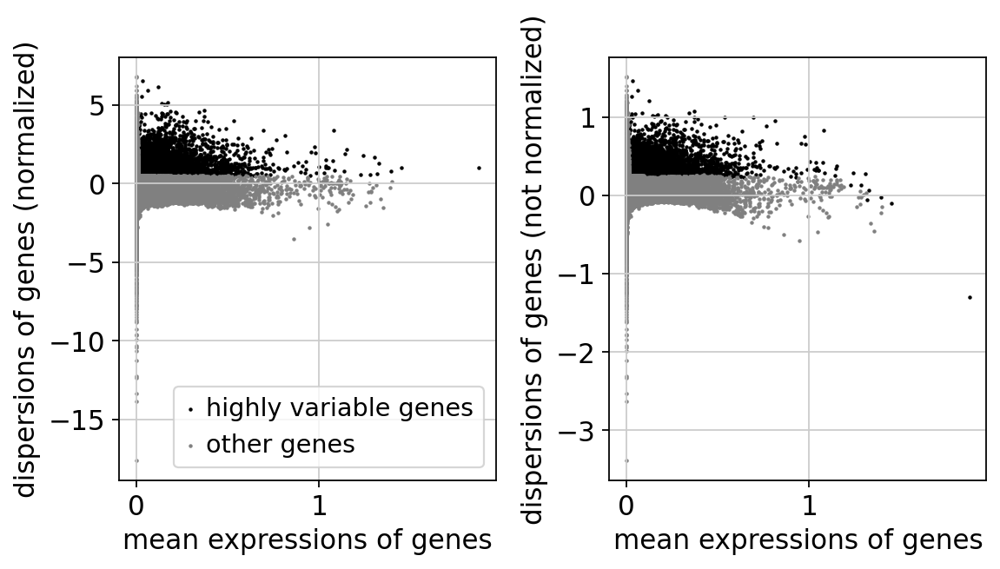

In [30]:
cellcycle_adata = adata.copy()
# Extract highly variable genes
filter_result = sc.pp.filter_genes_dispersion(
    cellcycle_adata.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.filter_genes_dispersion(filter_result,save='_ccg_identification.pdf')

In [31]:
# Traspose matrix for a GENE-centered analysis
cellcycle_adata = cellcycle_adata.T
cellcycle_adata = cellcycle_adata[filter_result.gene_subset,:]


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [32]:
# Scale data to unit variance and zero mean
sc.pp.scale(cellcycle_adata, max_value=10)
# PCA
sc.tl.pca(cellcycle_adata, svd_solver='arpack')

/opt/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:02:06)


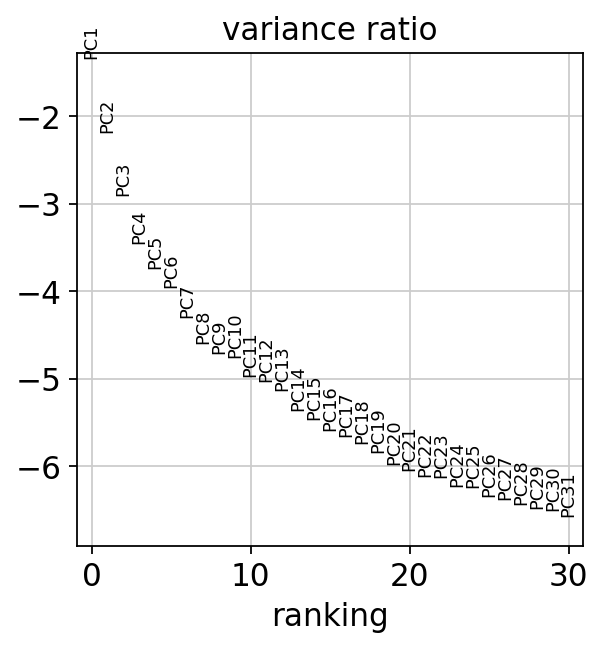

In [33]:
# Plot the variance ratio
sc.pl.pca_variance_ratio(cellcycle_adata, log=True, save='_ccg_identification.pdf')

computing neighbors
    using 'X_pca' with n_pcs = 8
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
... storing 'celltype_predictions' as categorical
... storing 'souporcell_assignment' as categorical


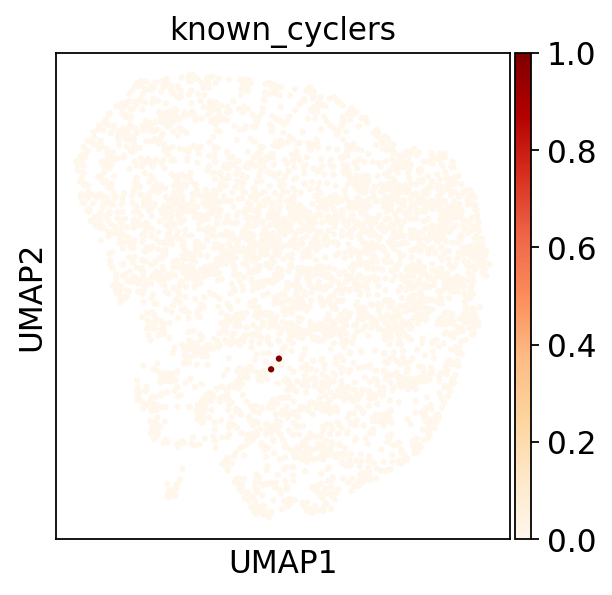

In [34]:
# Identify genes behaving like cc genes
num_pcs = 8
# Compute a neighborhood graph of observations
sc.pp.neighbors(cellcycle_adata,n_pcs=num_pcs)
# Embed the neighborhood graph using UMAP
sc.tl.umap(cellcycle_adata)
cellcycle_adata.obs['known_cyclers'] = [1 if gene in ['CDK1','MKI67','CCNB2','PCNA'] else 0 for gene in cellcycle_adata.obs_names]
# Scatter plot in UMAP basis
sc.pl.umap(cellcycle_adata,color=['known_cyclers'],color_map='OrRd',save='_ccg_identification.pdf')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 17 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


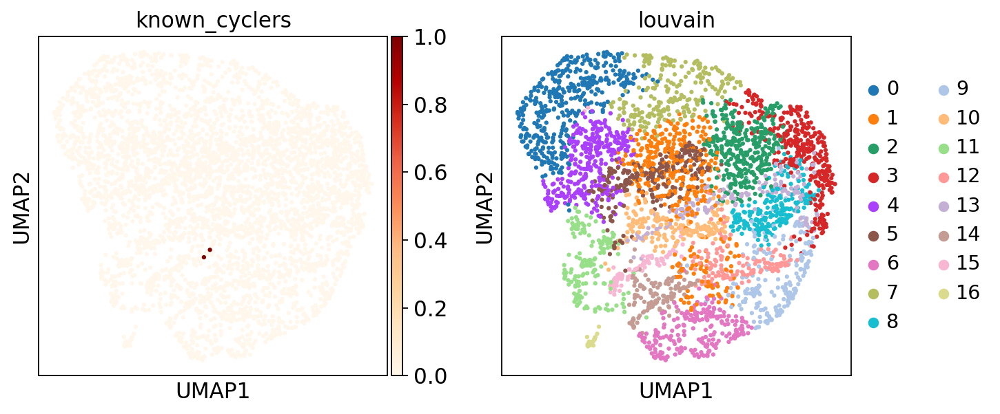

In [35]:
# Cluster GENES into subgroups using louvain
sc.tl.louvain(cellcycle_adata, resolution=1.0)
# Scatter plot in UMAP basis
sc.pl.umap(cellcycle_adata,color=['known_cyclers',
                                  'louvain'],color_map='OrRd',save='_ccg_identification.pdf')

In [36]:
for gene in ['CDK1','MKI67','CCNB2','PCNA']:
    print(gene, 'in current features:', gene in cellcycle_adata.obs_names)

CDK1 in current features: True
MKI67 in current features: True
CCNB2 in current features: False
PCNA in current features: False


In [37]:
# Locate genes of interests' cluster
print(cellcycle_adata.obs.loc[['CDK1','MKI67',
                               #'CCNB2','PCNA',
                              ],'louvain'])


CDK1     15
MKI67    15
Name: louvain, dtype: category
Categories (17, object): ['0', '1', '2', '3', ..., '13', '14', '15', '16']


In [38]:
cellcycle_adata.obs['louvain'].value_counts()

0     400
1     386
2     342
3     339
4     318
5     235
6     221
7     221
8     216
9     198
10    169
11    162
12    151
13    147
14    127
15     80
16     22
Name: louvain, dtype: int64

In [39]:
adata

AnnData object with n_obs × n_vars = 430136 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17

So removing genes from cluster 15 by filtering the main matrix

In [40]:
# Add unstructured dict-like annotation for ccgs
adata.uns['ccgs'] = list(cellcycle_adata.obs[(cellcycle_adata.obs['louvain']=='15')].index)
# Remove cc genes
adata = adata[:,[i not in adata.uns['ccgs'] for i in adata.var_names]]


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [41]:
adata

View of AnnData object with n_obs × n_vars = 430136 × 30720
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'g

In [42]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
Trying to set attribute `.obs` of view, copying.
    finished: added
    'S_score', score of gene set (adata.obs).
    488 total control genes are used. (0:00:39)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    450 total control genes are used. (0:00:21)
-->     'phase', cell cycle phase (adata.obs)


In [43]:
adata

AnnData object with n_obs × n_vars = 430136 × 30720
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17

# Subsetting to HVGs & scaling

In [44]:
%%time
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:01:20)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


CPU times: user 1min 19s, sys: 1.37 s, total: 1min 20s
Wall time: 1min 20s


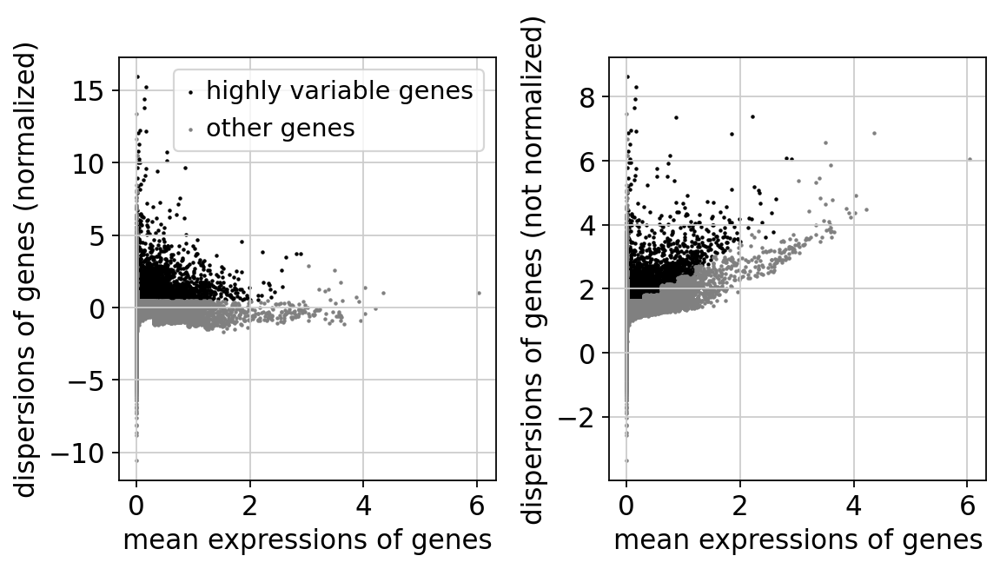

CPU times: user 398 ms, sys: 21.6 ms, total: 419 ms
Wall time: 422 ms


In [45]:
%%time
sc.pl.highly_variable_genes(adata)

In [46]:
adata_hvg = adata[:, adata.var['highly_variable']]

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [47]:
adata_hvg

View of AnnData object with n_obs × n_vars = 430136 × 3316
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene

In [48]:
%%time
sc.pp.scale(adata_hvg, max_value=10)

/opt/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


CPU times: user 17.9 s, sys: 7.73 s, total: 25.6 s
Wall time: 25.6 s


________

### PCA

In [49]:
%%time
sc.tl.pca(adata_hvg, svd_solver='arpack', n_comps=50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:02:59)


CPU times: user 20min 20s, sys: 2min 3s, total: 22min 24s
Wall time: 2min 59s


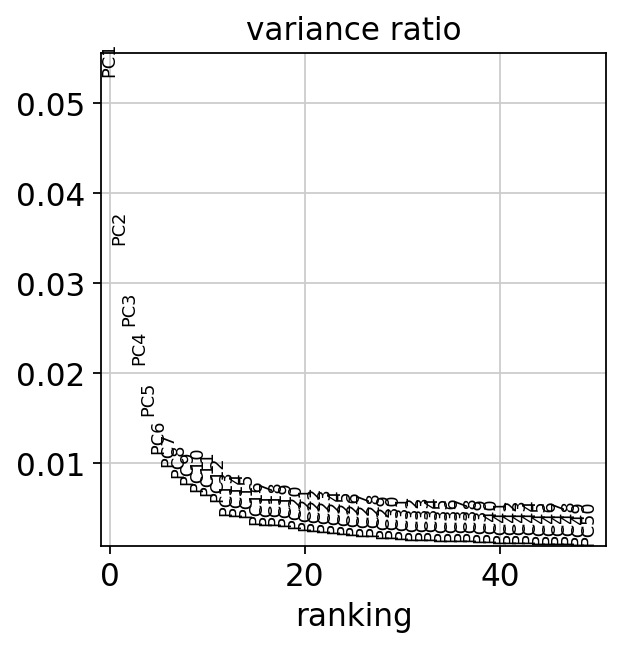

In [50]:
sc.pl.pca_variance_ratio(adata_hvg, n_pcs=50)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [51]:
%%time
sc.pp.neighbors(adata_hvg, n_neighbors=10, n_pcs=16)

computing neighbors
    using 'X_pca' with n_pcs = 16
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:22)


CPU times: user 2min 21s, sys: 7min 8s, total: 9min 29s
Wall time: 1min 22s


__________________________________________________________________________________________________________________________________________________________________

In [52]:
%%time
sc.tl.umap(adata_hvg, random_state=0)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:22:06)


CPU times: user 2h 34min 9s, sys: 47min 16s, total: 3h 21min 26s
Wall time: 22min 6s


In [53]:
# save this file with preliminary analysis
adata_hvg.write(save_path + 'adata_hvg_prelim_analysis.h5ad')

... storing 'celltype_predictions' as categorical
... storing 'souporcell_assignment' as categorical
... storing 'phase' as categorical


# Plotting

In [54]:
# to better distinguish predictions from Vento-Tormo dataset
colors_VT = ['#C1B4A7','#E8D6E0','#40ab5d','#F4BF73','#F7B5A4',
                 '#d8e7a4','#2ECCFA','#39728C','#FA5858','#E9A1C7',
                 '#B40486','#004529','#C49A6C','#9255a0', '#58595B', '#A3A8AD',
                 '#F6D8CE','#633A6D','#C7E0BD','#49ABC8', '#E7C949', '#F7F297', '#af9e56',
                 '#ED1B64','#E59C24','#C2E8F6','#677EB2','#73FDD6', '#BC3122', '#771A15',
                 '#E6C6F7','#CEE3F6','#CECEF6','#677EB2','#6363A5','#63A585',
                 '#246D66','#9B8579']

In [55]:
len(colors_VT)

38

In [58]:
print(len(np.unique(adata_hvg.obs['celltype_predictions'])))

np.unique(adata_hvg.obs['celltype_predictions'])

38


array(['0_dS1', '10_Tcells', '11_dNK3', '12_F1', '13_EVT', '14.1_PV1',
       '14.2_PV2', '15_Tcells', '16_EVT', '17_NK', '18_HB',
       '19.1_Endo (m)', '19.2_Endo L', '19.3_Endo (f)', '1_VCT', '20_SCT',
       '21_dS3', '22_M3', '23_MO', '24_dNKp', '25.1_Epi1', '25.2_Epi2',
       '26_Plasma', '27_DC1', '28_DC2', '29_MO', '2_dNK2',
       '30_Granulocytes', '31_NK CD16', '32_ILC3', '33_F2', '3_dS2',
       '4_Tcells', '5_dNK1', '6_dM2', '7_dM1', '8_Tcells', '9_VCT'],
      dtype=object)

In [59]:
adata_hvg

AnnData object with n_obs × n_vars = 430136 × 3316
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17'

### No batch correction

16 PCs

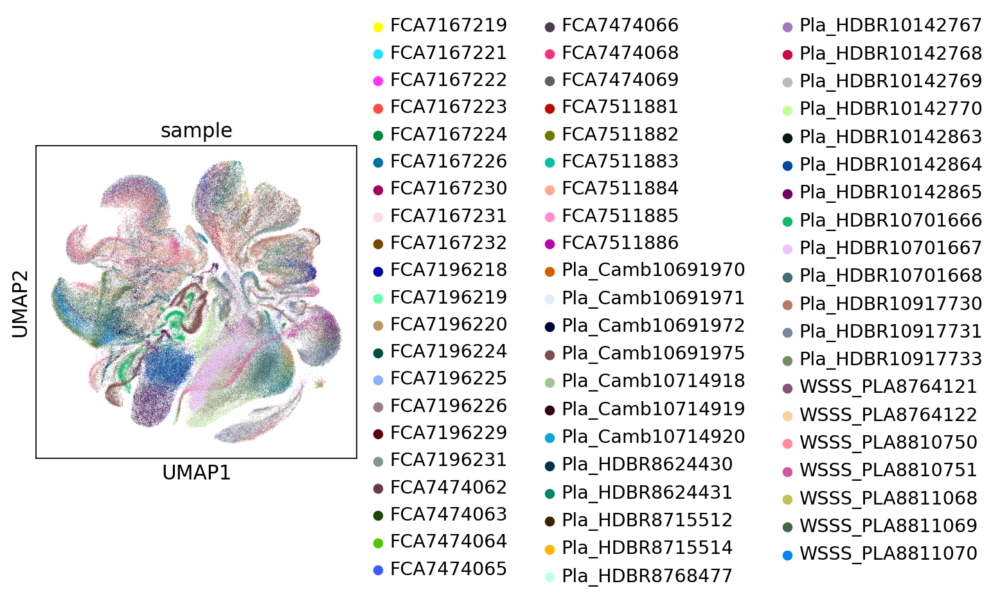

In [60]:
sc.pl.umap(adata_hvg, color=['sample'])

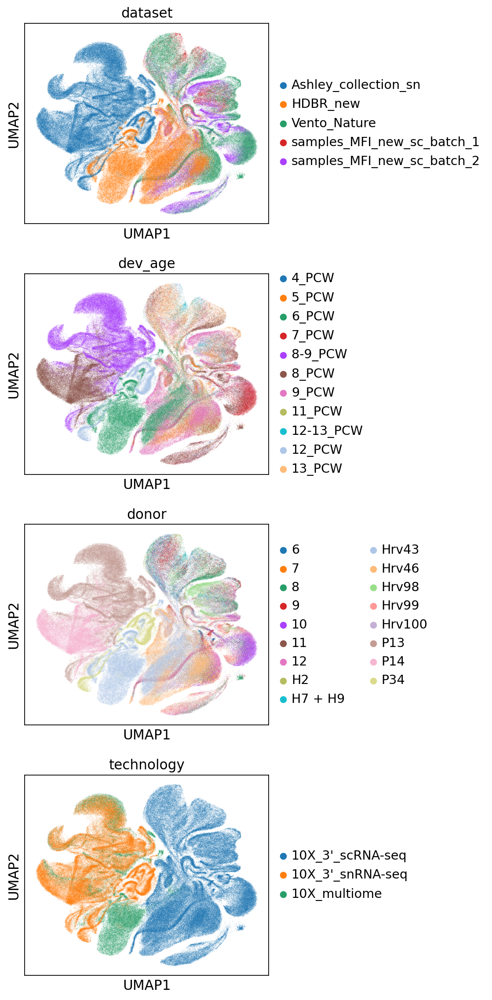

In [64]:
sc.pl.umap(adata_hvg, color=['dataset','dev_age','donor','technology'], ncols=1)

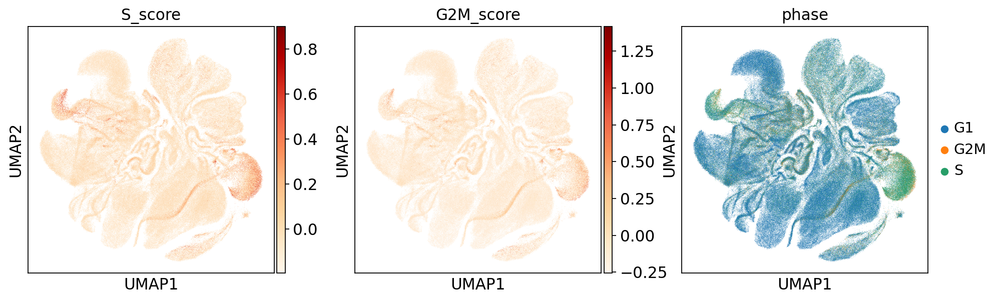

In [62]:
sc.pl.umap(adata_hvg, color=['S_score','G2M_score','phase'], cmap='OrRd')

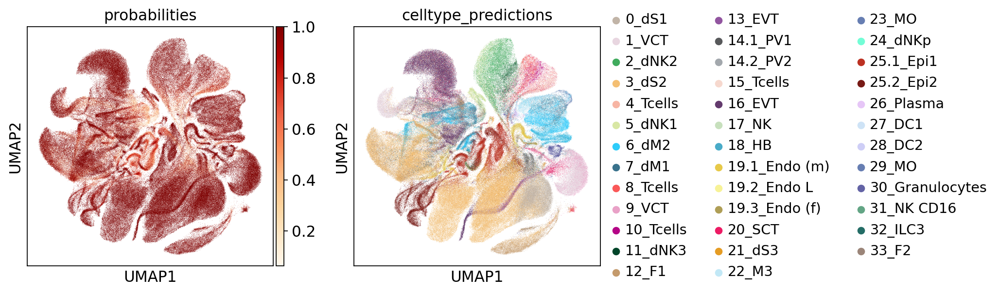

In [63]:
sc.pl.umap(adata_hvg, color=['probabilities',
                             'celltype_predictions'], palette=colors_VT, cmap='OrRd')

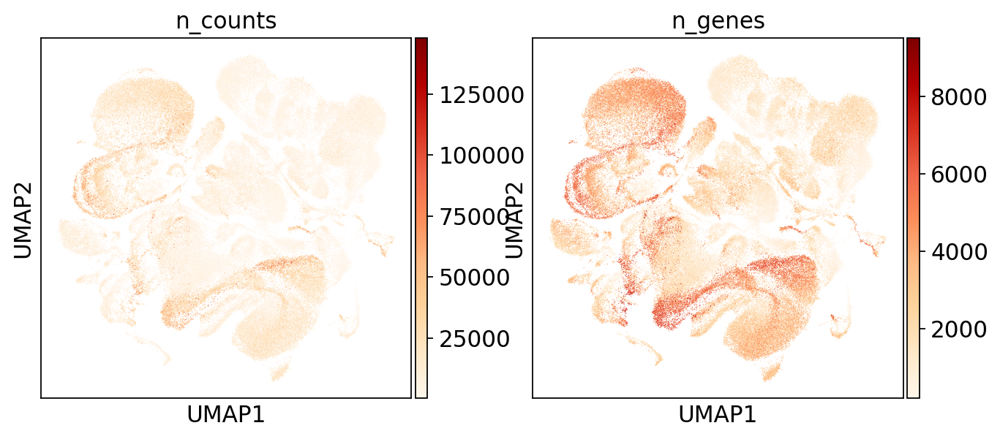

In [79]:
sc.pl.umap(adata_hvg, color=['n_counts',
                             'n_genes'], cmap='OrRd')

# Labelling M/F origin of cells/nuclei 

In [72]:
adata_hvg.obs['inter_ind_doublet'] = [1 if value else 0 for value in adata_hvg.obs['inter_ind_doublet']]
np.unique(adata_hvg.obs['inter_ind_doublet'], return_counts=True)

(array([0, 1]), array([384987,  45149]))

In [65]:
np.unique(adata_hvg.obs['sample'])

array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
       'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
       'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
       'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
       'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
       'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
       'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
       'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
       'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
       'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
       'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
       'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
       'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
       'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
       'Pla_HDBR87

In [66]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167219'].obs['souporcell_assignment'])

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


array(['FCA7167219_0', 'FCA7167219_0/1', 'FCA7167219_1', 'FCA7167219_1/0'],
      dtype=object)

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


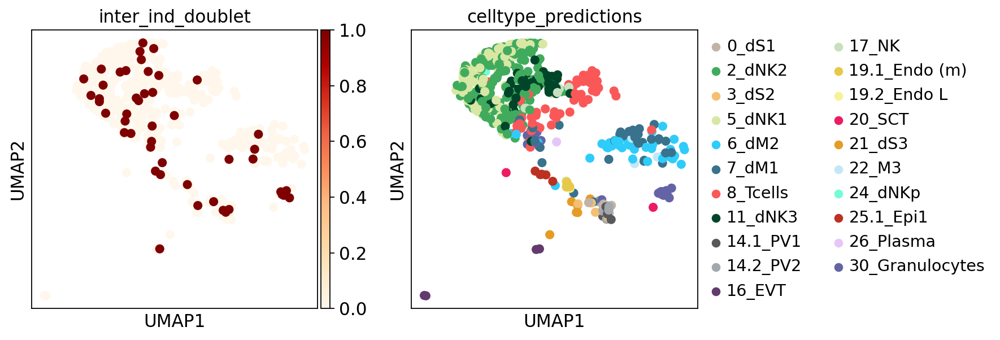

In [73]:
sc.pl.umap(adata_hvg[(adata_hvg.obs['sample'] == 'FCA7167219')], 
           color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


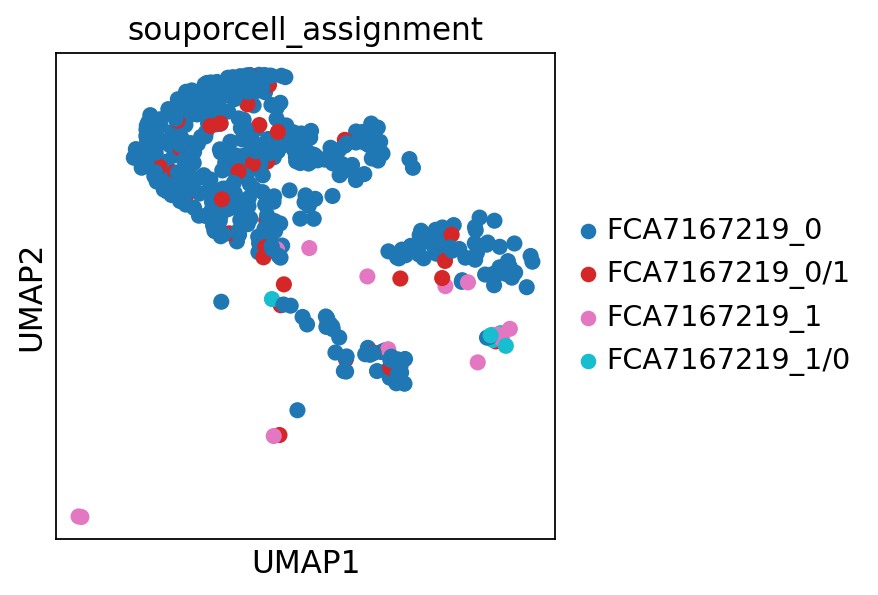

In [68]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167219'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167219:

- 0 --> M
- 1 --> F

In [74]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167221'].obs['souporcell_assignment'])

array(['FCA7167221_0', 'FCA7167221_0/1', 'FCA7167221_1', 'FCA7167221_1/0'],
      dtype=object)

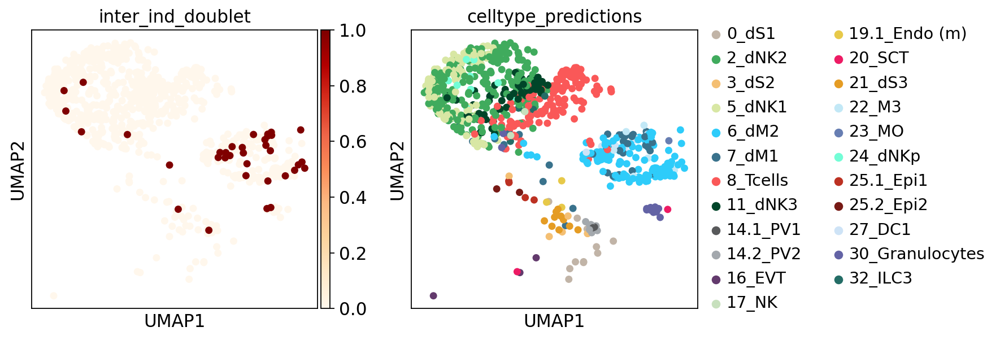

In [75]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167221'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


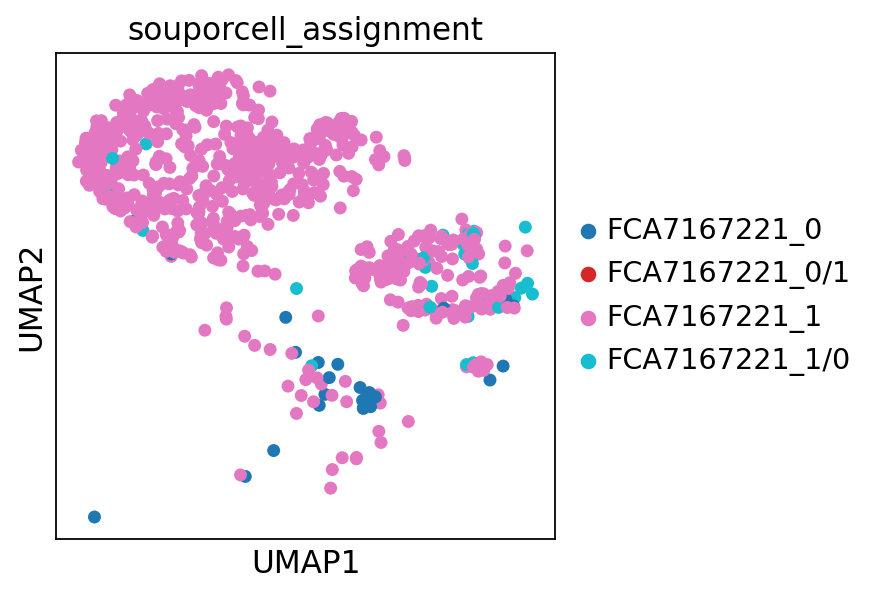

In [76]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167221'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167221:

- 0 --> F
- 1 --> M

In [77]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167222'].obs['souporcell_assignment'])

array(['FCA7167222_0', 'FCA7167222_0/1', 'FCA7167222_1', 'FCA7167222_1/0'],
      dtype=object)

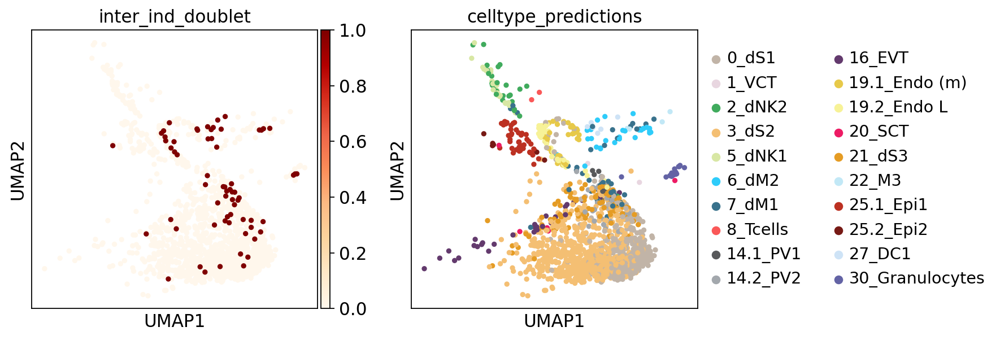

In [78]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167222'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


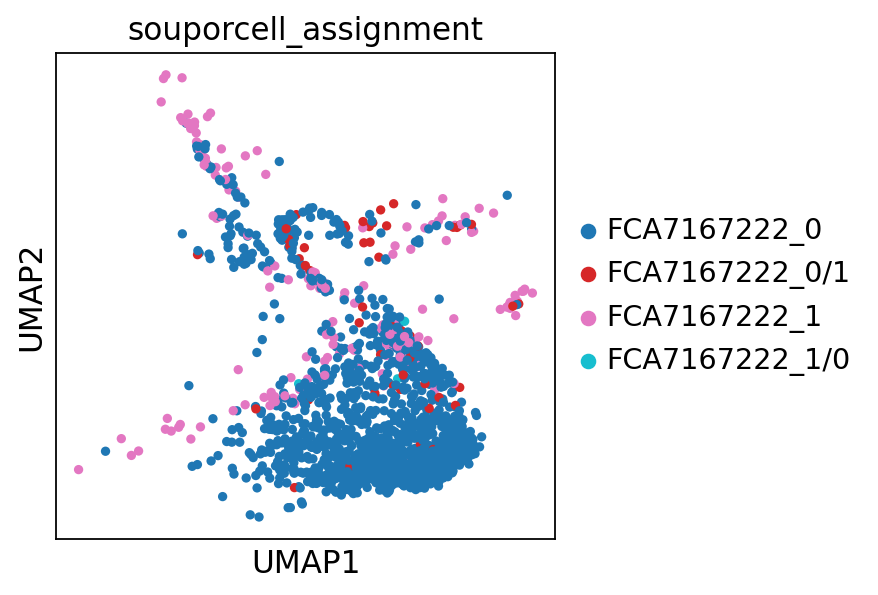

In [79]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167222'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167222:

- 1 --> F
- 0 --> M

In [80]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167223'].obs['souporcell_assignment'])

array(['FCA7167223_0', 'FCA7167223_0/1', 'FCA7167223_1', 'FCA7167223_1/0'],
      dtype=object)

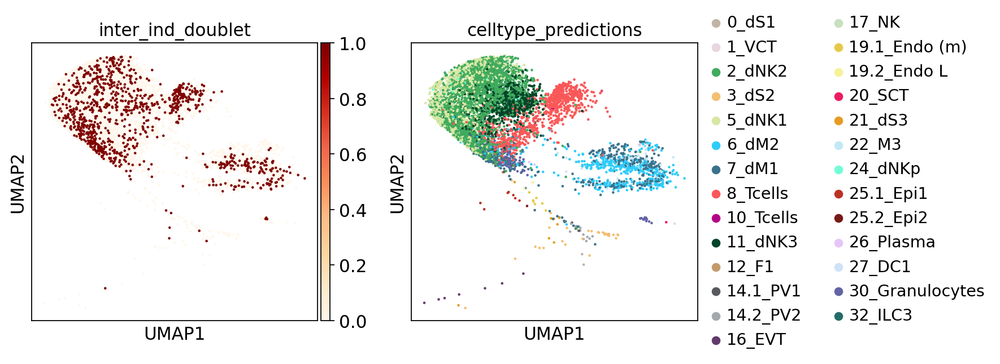

In [81]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167223'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


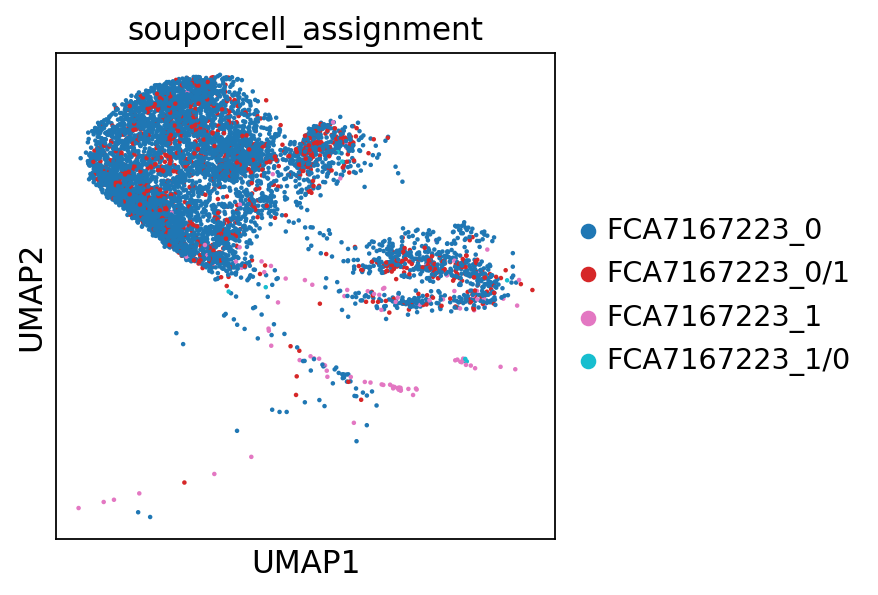

In [82]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167223'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167223:

- 1 --> F
- 0 --> M

In [83]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167224'].obs['souporcell_assignment'])

array(['FCA7167224_0', 'FCA7167224_0/1', 'FCA7167224_1', 'FCA7167224_1/0'],
      dtype=object)

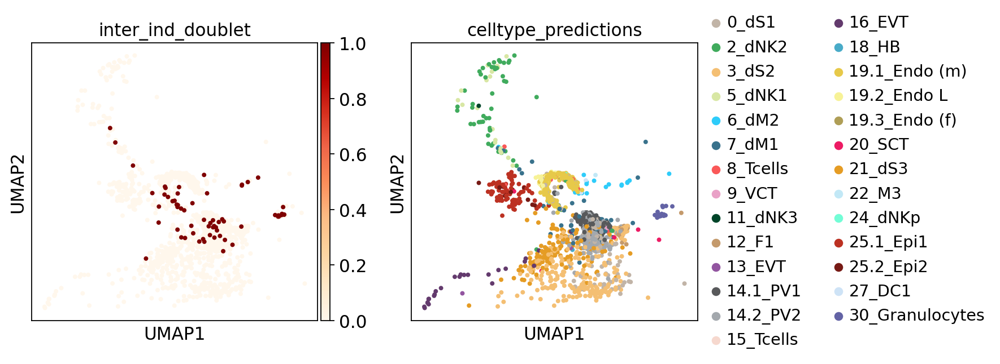

In [84]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167224'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


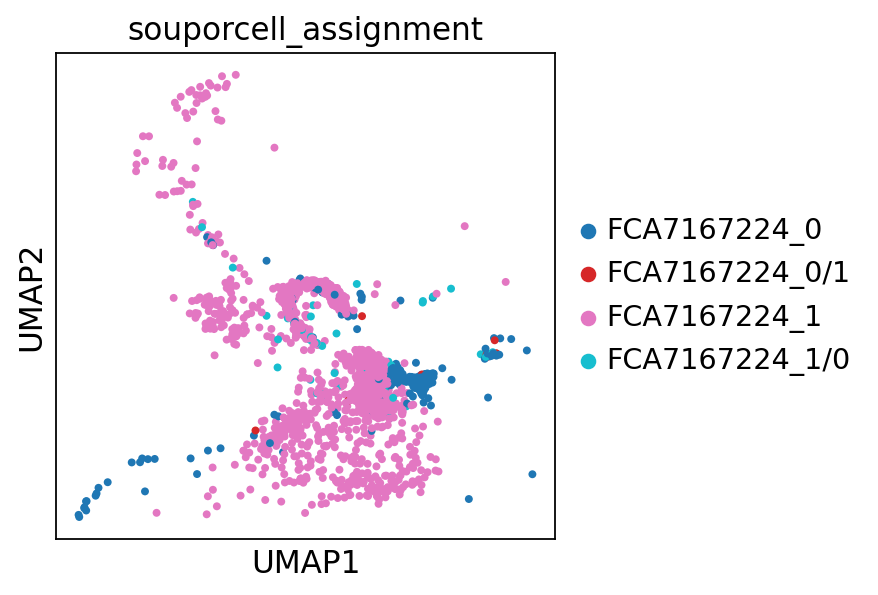

In [85]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167224'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167224:

- 0 --> F
- 1 --> M

In [86]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167226'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7167226_0', 'FCA7167226_0/1', 'FCA7167226_1', 'FCA7167226_1/0'],
       dtype=object),
 array([3229,  309, 3152,  321]))

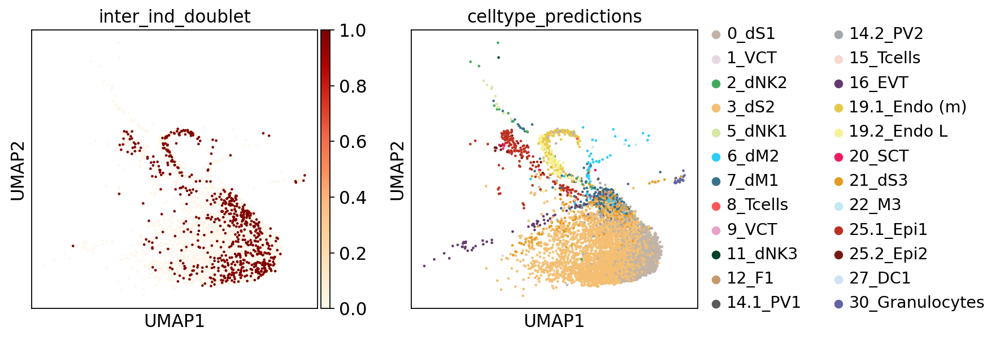

In [87]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167226'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


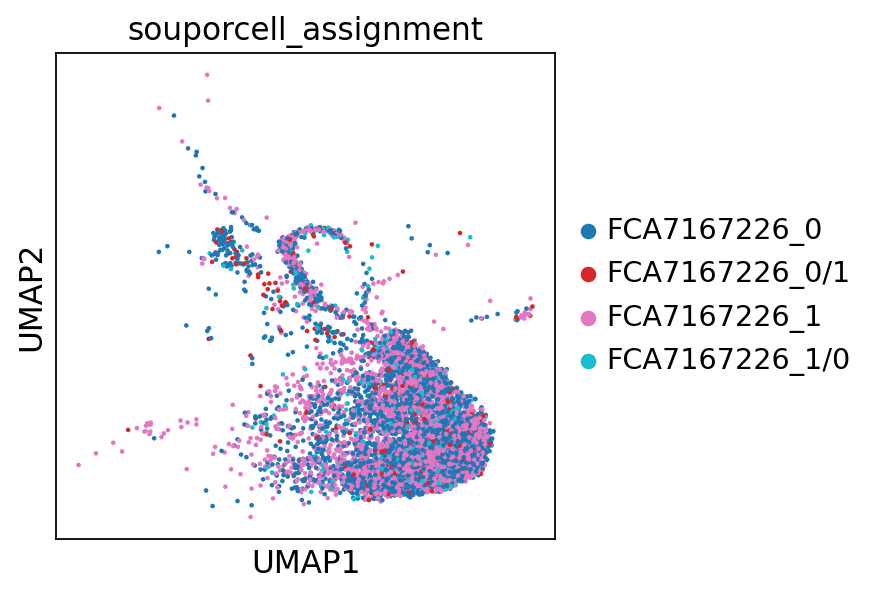

In [88]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167226'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

In [89]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167226'].obs['celltype_predictions'], return_counts=True)

(array(['0_dS1', '11_dNK3', '12_F1', '14.1_PV1', '14.2_PV2', '15_Tcells',
        '16_EVT', '19.1_Endo (m)', '19.2_Endo L', '1_VCT', '20_SCT',
        '21_dS3', '22_M3', '25.1_Epi1', '25.2_Epi2', '27_DC1', '2_dNK2',
        '30_Granulocytes', '3_dS2', '5_dNK1', '6_dM2', '7_dM1', '8_Tcells',
        '9_VCT'], dtype=object),
 array([1699,    1,   16,   33,  177,    1,   53,  172,  212,    2,    9,
         349,    2,  161,   17,    1,   18,   21, 3740,   12,   61,  250,
           3,    1]))

In [90]:
len(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167226'].obs['celltype_predictions'])
# and about 60 are predicted to be troph... so probably not enough for souporcell to distinguish

7011

Sample FCA7167226:

--> all M, insufficient amount of F cells for souporcell to recognise them...

In [91]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167230'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7167230_0', 'FCA7167230_0/1', 'FCA7167230_1', 'FCA7167230_1/0'],
       dtype=object),
 array([249,   6, 149,   3]))

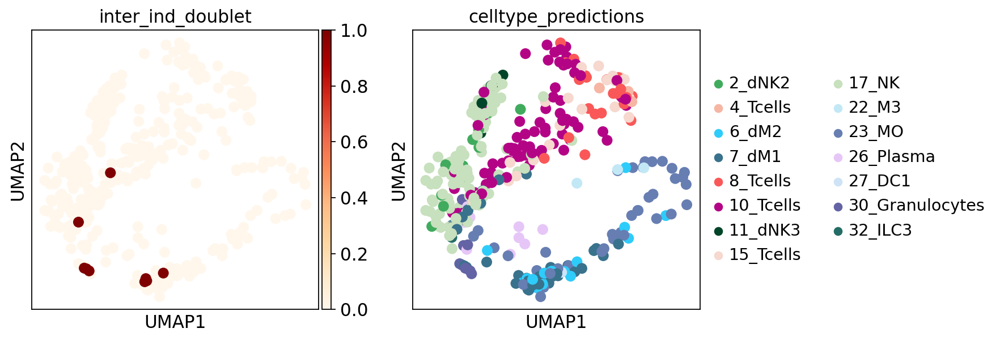

In [92]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167230'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


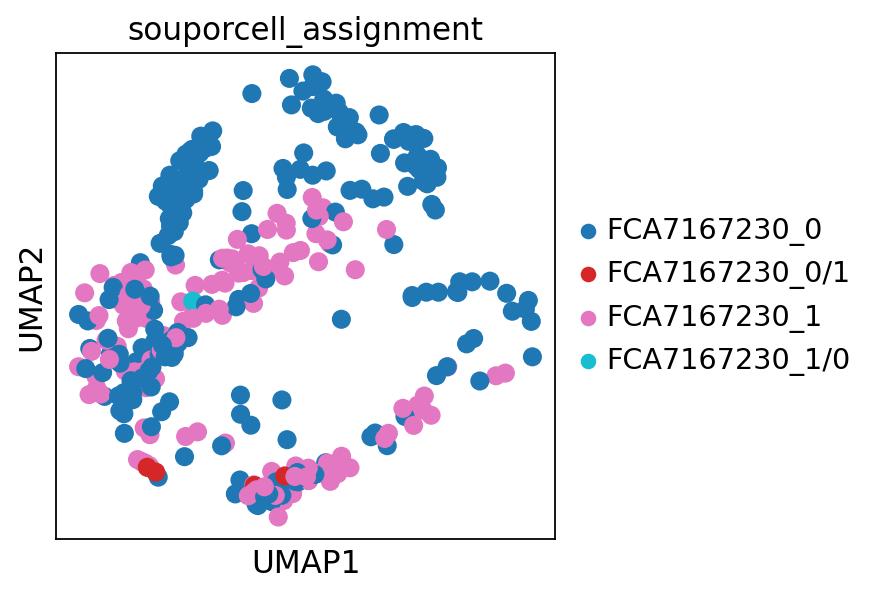

In [93]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167230'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167230:

all M (blood)

In [94]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167231'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7167231_0', 'FCA7167231_0/1', 'FCA7167231_1'], dtype=object),
 array([1244,  163,   75]))

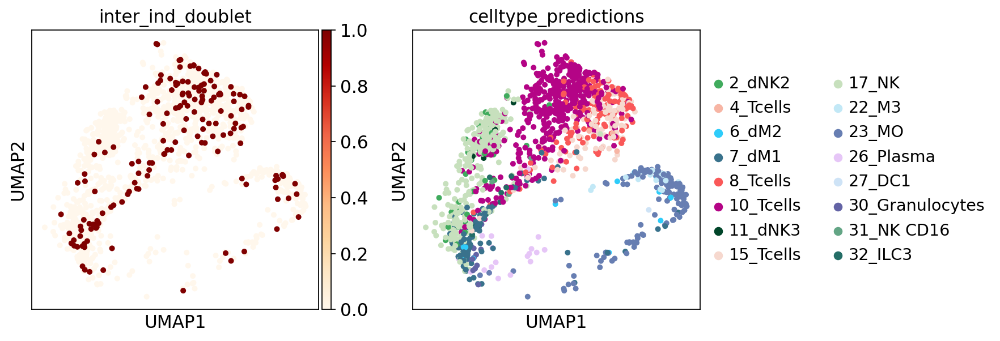

In [95]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167231'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


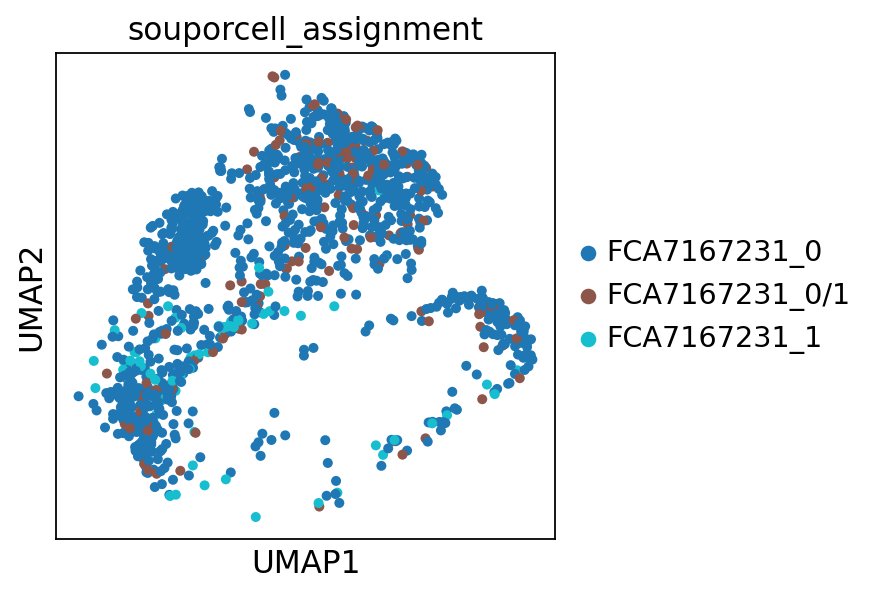

In [96]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167231'], color=['souporcell_assignment'],
           ncols=2,palette='tab10')

Sample FCA7167231:

all M (blood)

In [97]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167232'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7167232_0', 'FCA7167232_0/1', 'FCA7167232_1', 'FCA7167232_1/0'],
       dtype=object),
 array([1696,  128,  118,    1]))

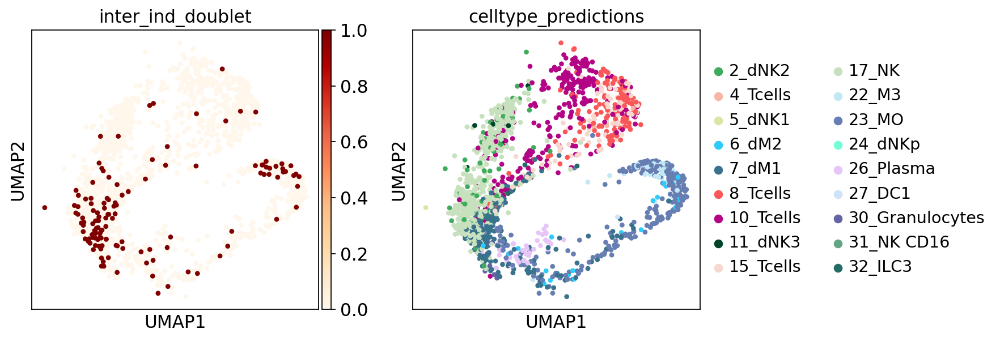

In [98]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167232'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


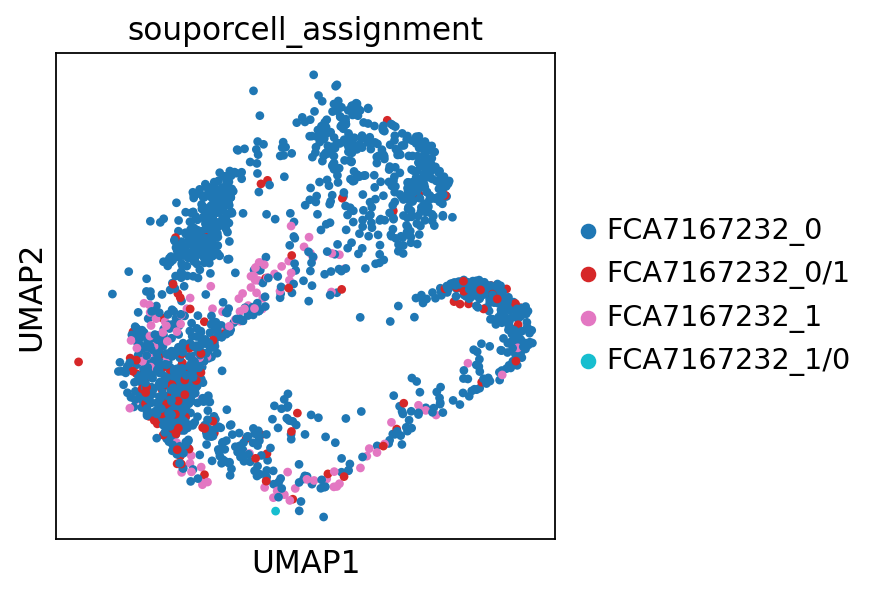

In [99]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7167232'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7167232:

all M (blood)

In [100]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196218'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196218_0', 'FCA7196218_0/1', 'FCA7196218_1', 'FCA7196218_1/0'],
       dtype=object),
 array([  26,   10, 6533,  838]))

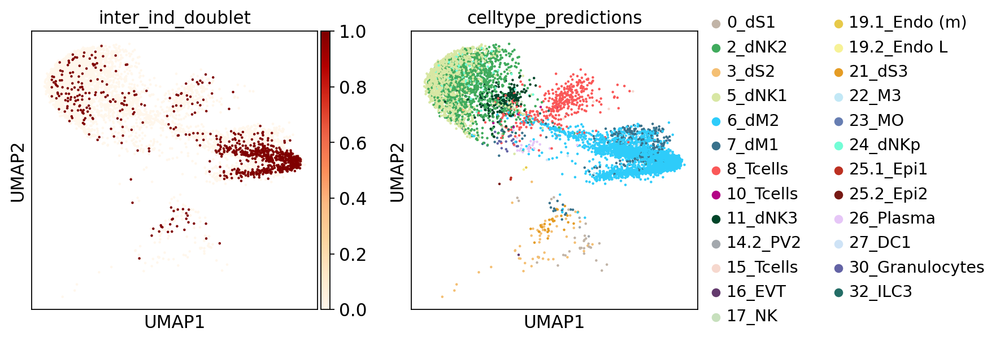

In [101]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196218'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

In [102]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196218'].obs['celltype_predictions'], return_counts=True)

(array(['0_dS1', '10_Tcells', '11_dNK3', '14.2_PV2', '15_Tcells', '16_EVT',
        '17_NK', '19.1_Endo (m)', '19.2_Endo L', '21_dS3', '22_M3',
        '23_MO', '24_dNKp', '25.1_Epi1', '25.2_Epi2', '26_Plasma',
        '27_DC1', '2_dNK2', '30_Granulocytes', '32_ILC3', '3_dS2',
        '5_dNK1', '6_dM2', '7_dM1', '8_Tcells'], dtype=object),
 array([  30,    8,  208,    3,    5,    1,    9,    1,    1,   29,   20,
           2,  117,    2,    1,   23,    4, 1222,   16,   14,   52, 1619,
        3372,  282,  366]))

In [103]:
# 22 predicted to be fetal cells
len(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196218'].obs['souporcell_assignment'])

7407

Trying to set attribute `.uns` of view, copying.


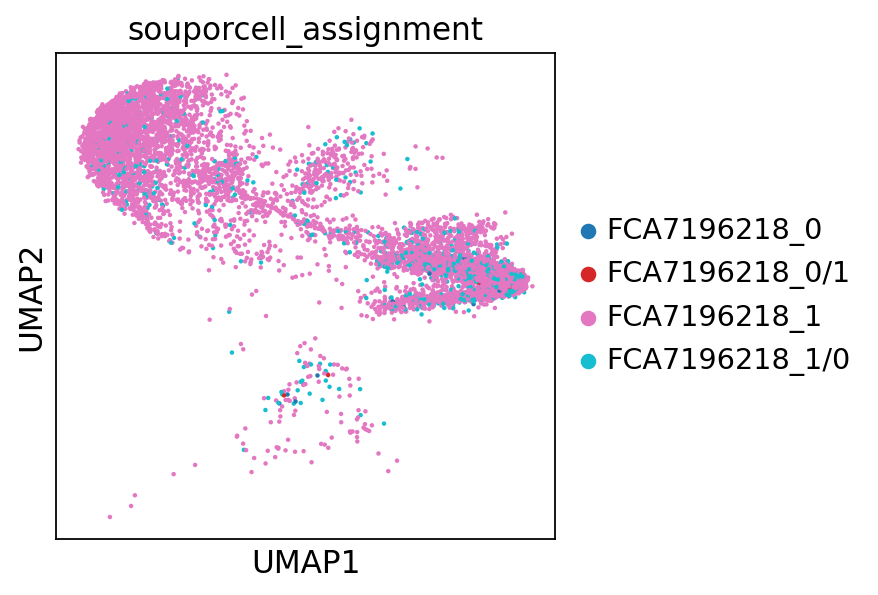

In [104]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196218'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196218:

0 --> F

1 --> M

In [105]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196219'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196219_0', 'FCA7196219_0/1', 'FCA7196219_1', 'FCA7196219_1/0'],
       dtype=object),
 array([3293,   81,   10,    2]))

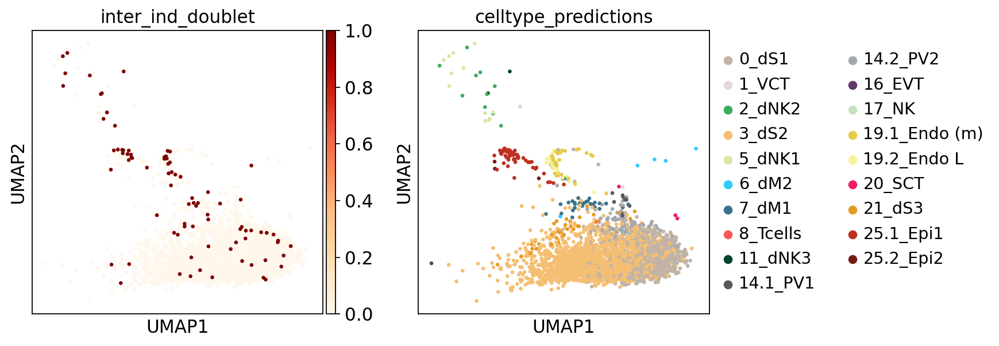

In [106]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196219'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


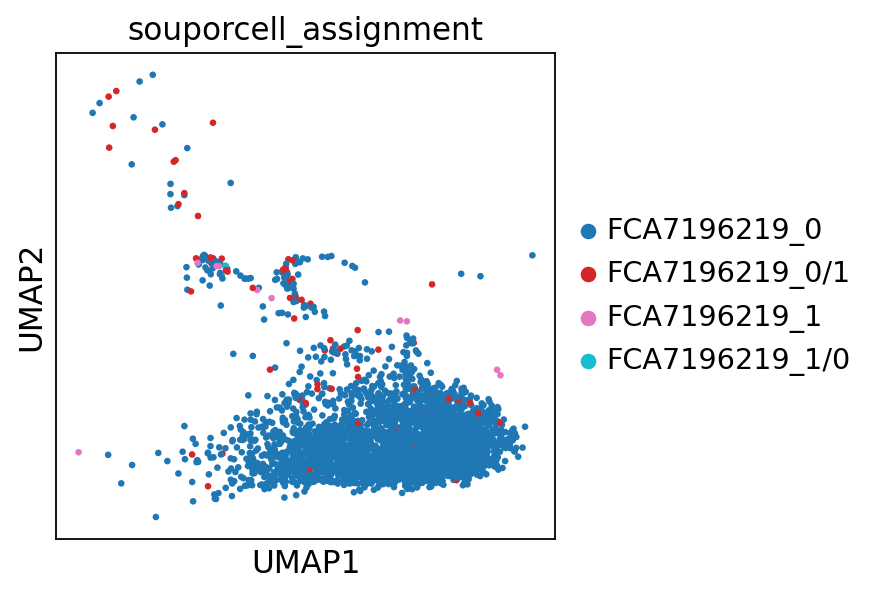

In [107]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196219'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196219:

- 0 --> M
- 1 --> F

In [108]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196220'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196220_0', 'FCA7196220_0/1', 'FCA7196220_1', 'FCA7196220_1/0'],
       dtype=object),
 array([6181,  132,  451,   50]))

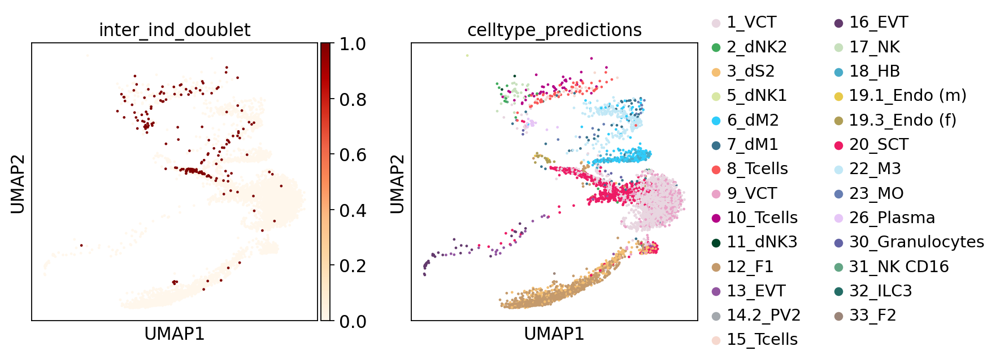

In [109]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196220'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


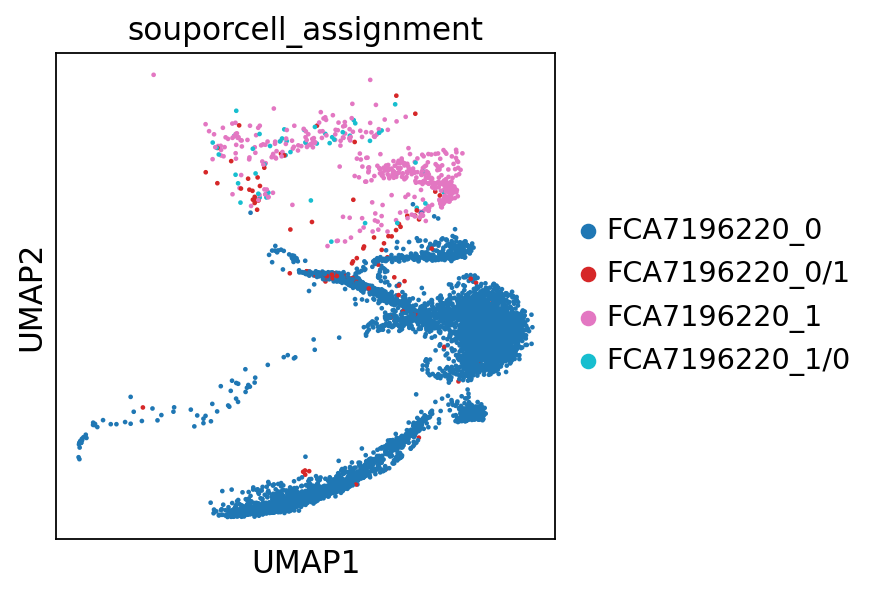

In [110]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196220'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196220:

- 0 --> F
- 1 --> M

In [111]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196224'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196224_0', 'FCA7196224_0/1', 'FCA7196224_1', 'FCA7196224_1/0'],
       dtype=object),
 array([  63,    7, 6704,  723]))

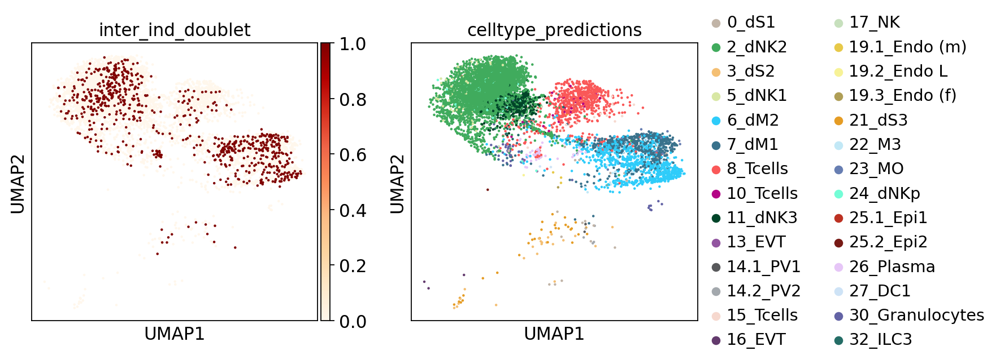

In [112]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196224'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

In [113]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196224'].obs['celltype_predictions'], return_counts=True)

(array(['0_dS1', '10_Tcells', '11_dNK3', '13_EVT', '14.1_PV1', '14.2_PV2',
        '15_Tcells', '16_EVT', '17_NK', '19.1_Endo (m)', '19.2_Endo L',
        '19.3_Endo (f)', '21_dS3', '22_M3', '23_MO', '24_dNKp',
        '25.1_Epi1', '25.2_Epi2', '26_Plasma', '27_DC1', '2_dNK2',
        '30_Granulocytes', '32_ILC3', '3_dS2', '5_dNK1', '6_dM2', '7_dM1',
        '8_Tcells'], dtype=object),
 array([  25,   27,  352,    3,    2,    4,   21,    3,    8,    3,    1,
           1,   34,   52,   24,   72,    1,    1,   57,   12, 4370,   40,
          24,   25,   85,  862,  640,  748]))

Trying to set attribute `.uns` of view, copying.


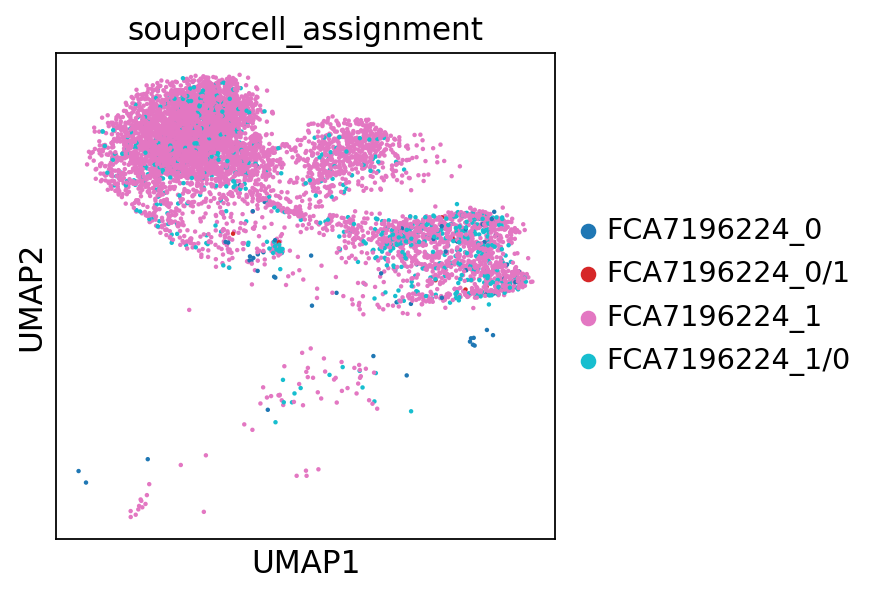

In [114]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196224'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196224:

- 0 --> F
- 1 --> M

In [115]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196224'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196224_0', 'FCA7196224_0/1', 'FCA7196224_1', 'FCA7196224_1/0'],
       dtype=object),
 array([  63,    7, 6704,  723]))

In [116]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196225'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196225_0', 'FCA7196225_0/1', 'FCA7196225_1', 'FCA7196225_1/0'],
       dtype=object),
 array([ 788,   40, 3370,   55]))

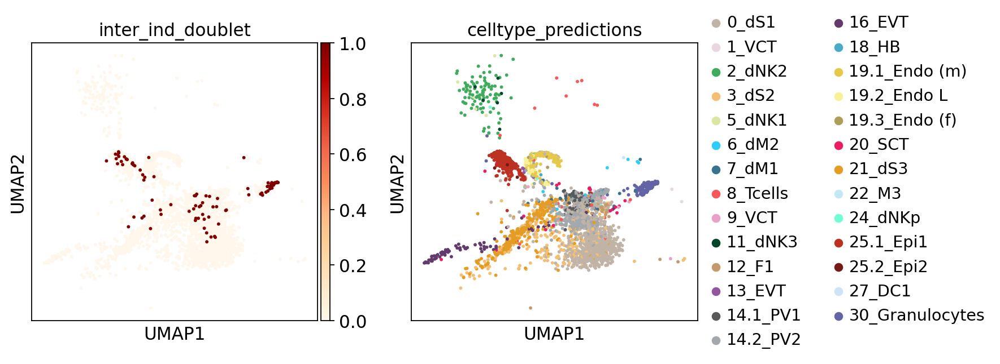

In [117]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196225'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


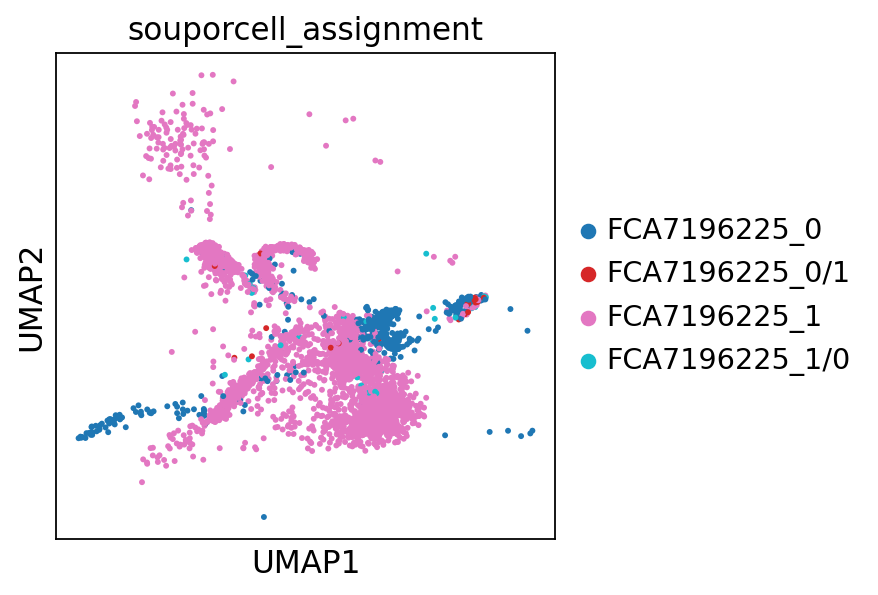

In [118]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196225'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196225:

- 0 --> F
- 1 --> M

In [119]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196226'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196226_0', 'FCA7196226_0/1', 'FCA7196226_1', 'FCA7196226_1/0'],
       dtype=object),
 array([2204,   91,  734,   22]))

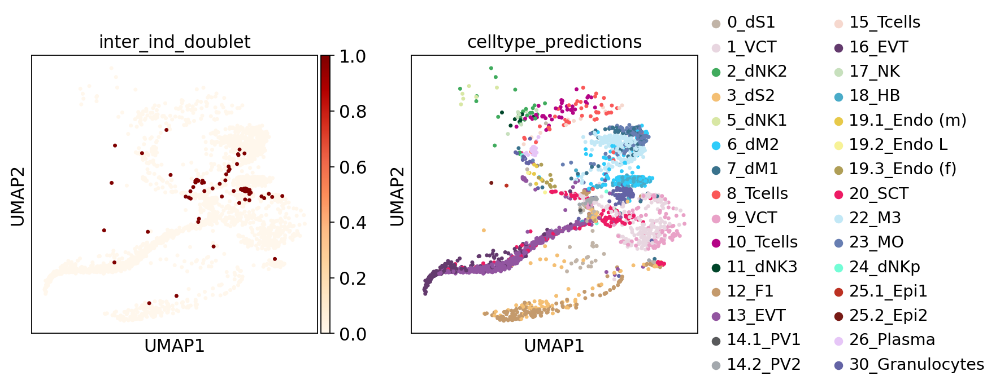

In [120]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196226'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


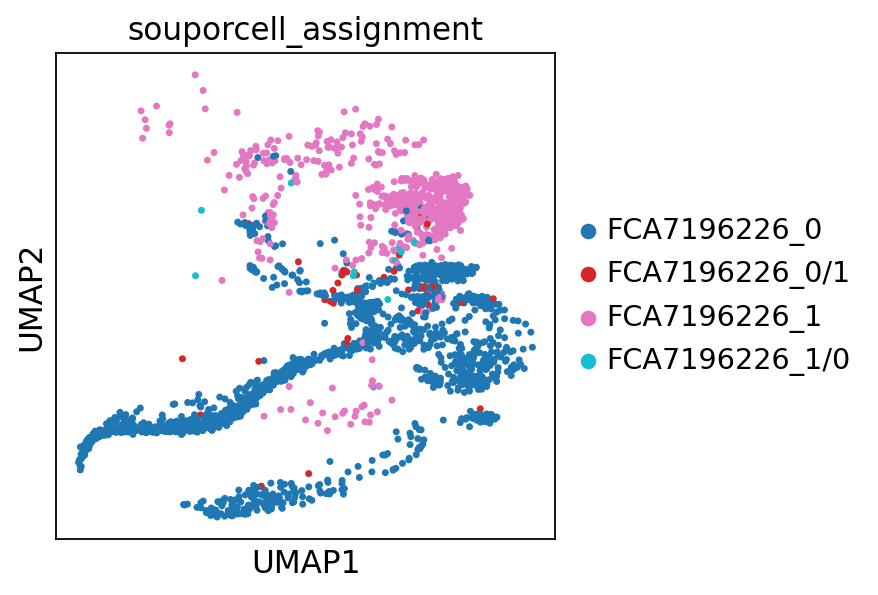

In [121]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196226'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196226:

- 0 --> F
- 1 --> M

In [125]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196229'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196229_0', 'FCA7196229_0/1', 'FCA7196229_1', 'FCA7196229_1/0'],
       dtype=object),
 array([   8,    3, 2967,   82]))

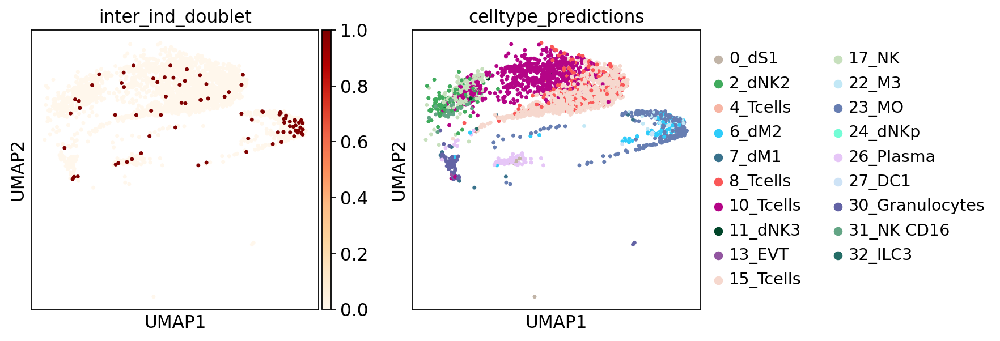

In [126]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196229'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


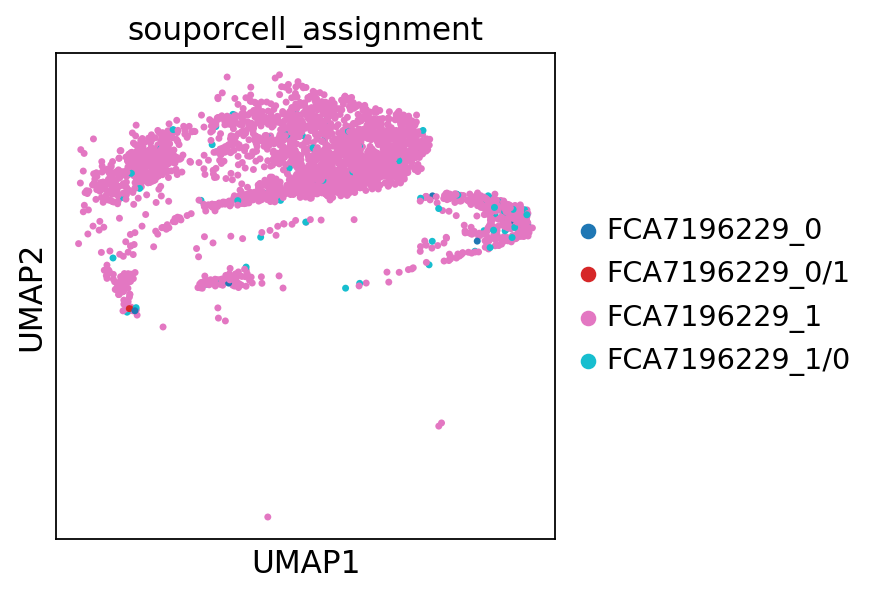

In [127]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196229'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196229:

all M (blood)

In [128]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196231'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7196231_0', 'FCA7196231_0/1'], dtype=object), array([4348,  215]))

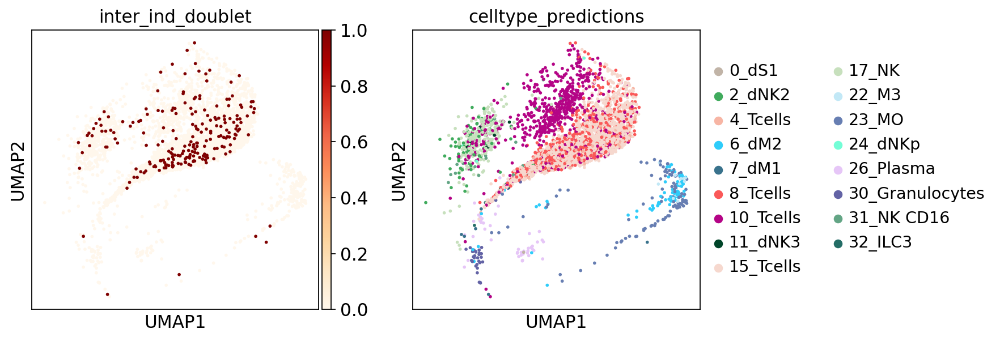

In [129]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196231'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


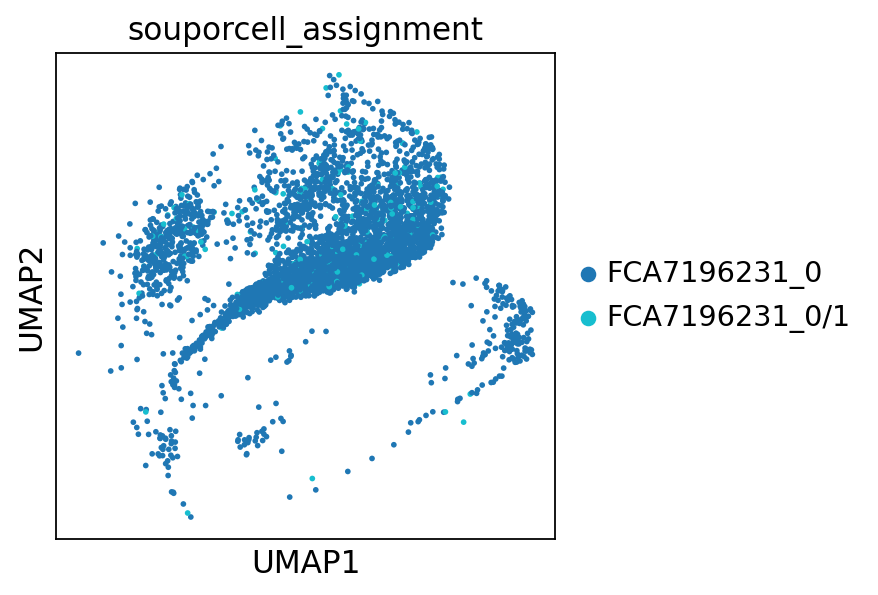

In [130]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7196231'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7196231:

all M (blood)

In [131]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474062'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474062_0', 'FCA7474062_0/1', 'FCA7474062_1', 'FCA7474062_1/0'],
       dtype=object),
 array([  24,    6, 1803,  360]))

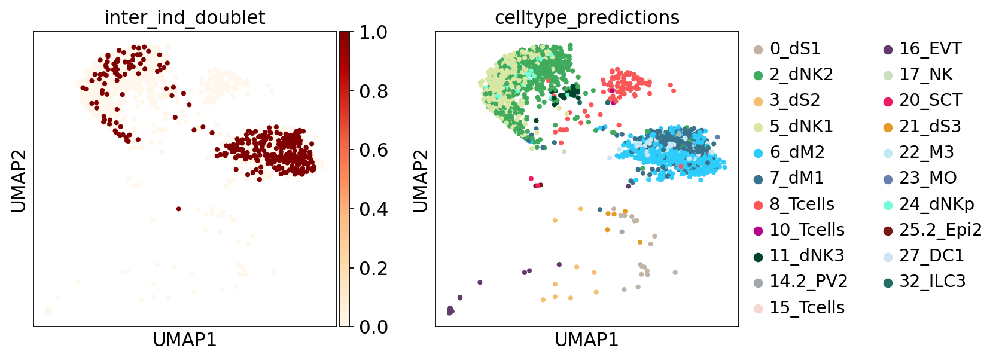

In [132]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474062'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


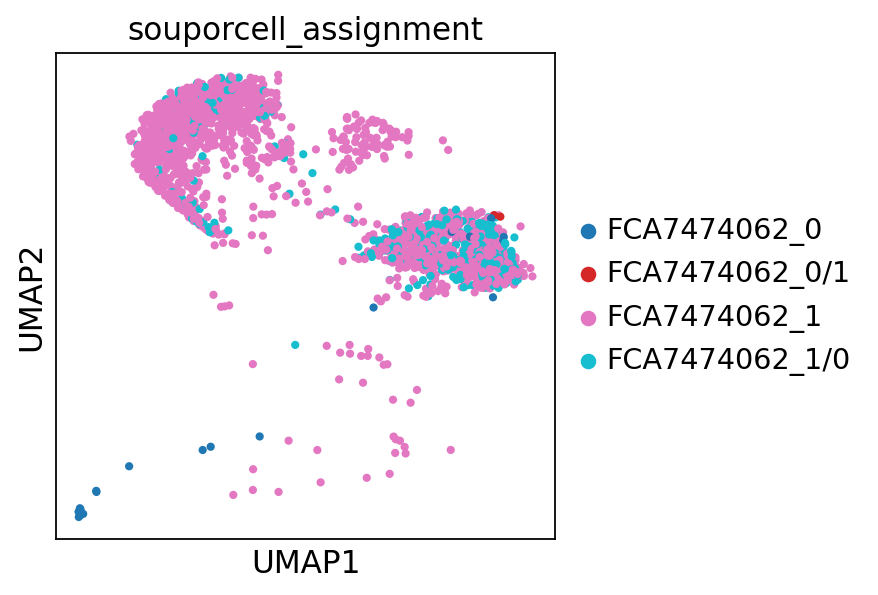

In [133]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474062'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474062:

- 0 --> F
- 1 --> M

In [134]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474063'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474063_0', 'FCA7474063_0/1', 'FCA7474063_1', 'FCA7474063_1/0'],
       dtype=object),
 array([ 170,    5, 2136,    1]))

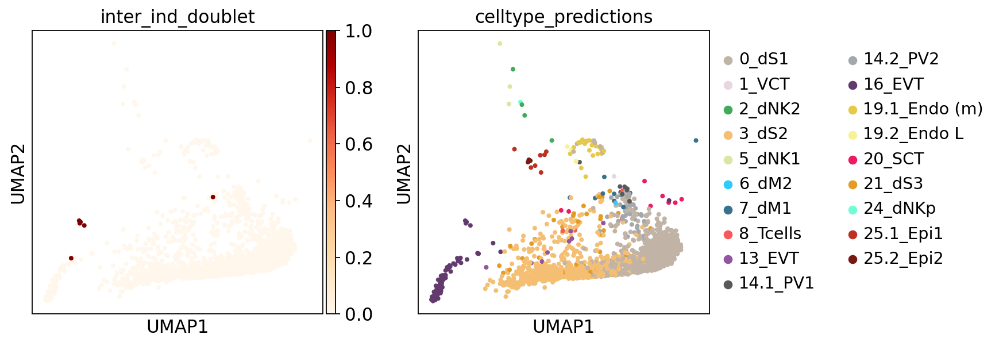

In [135]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474063'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


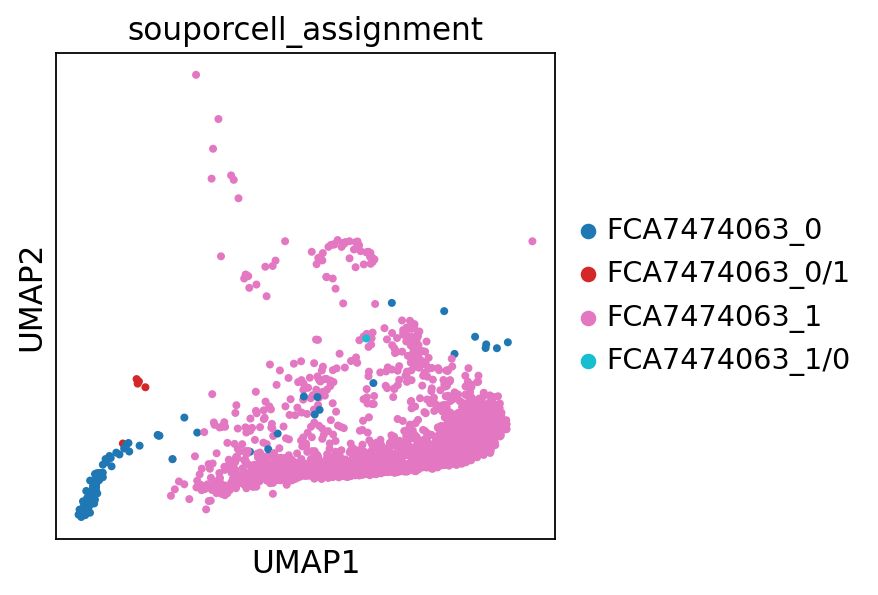

In [136]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474063'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474063:

- 0 --> F
- 1 --> M

In [137]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474064'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474064_0', 'FCA7474064_0/1', 'FCA7474064_1', 'FCA7474064_1/0'],
       dtype=object),
 array([ 382,    7, 4036,   28]))

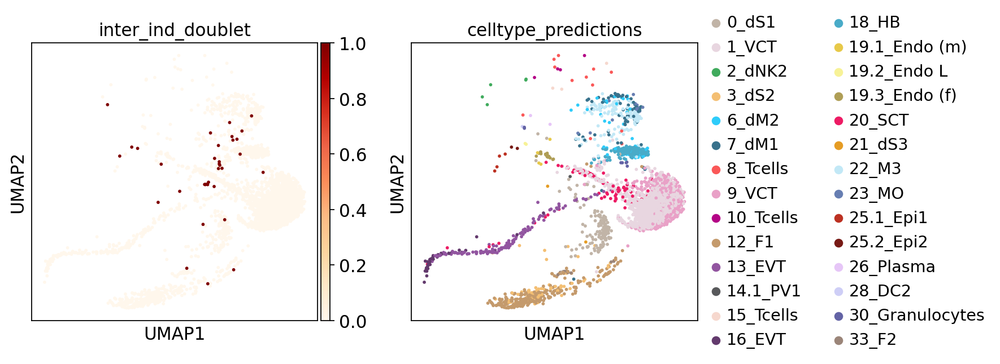

In [138]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474064'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


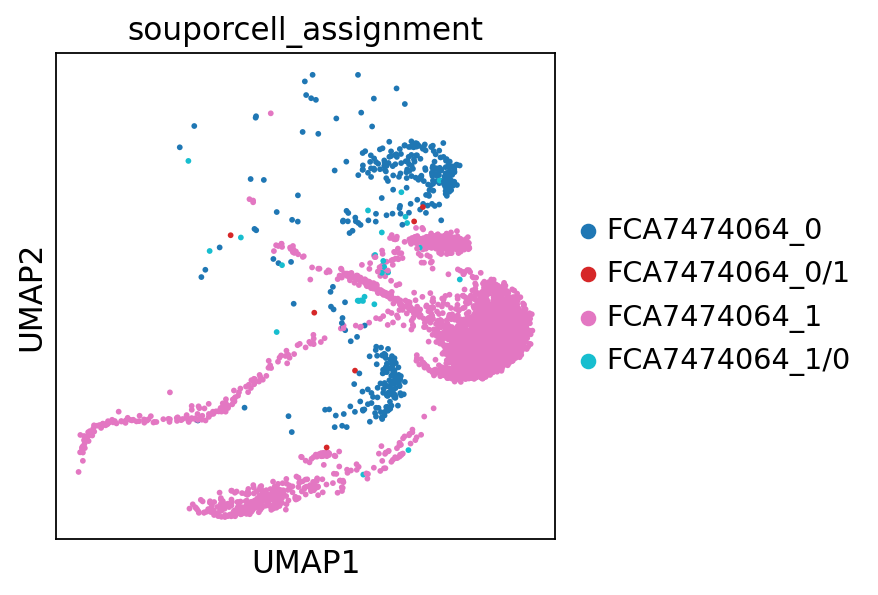

In [139]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474064'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474064:

- 1 --> F
- 0 --> M

In [140]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474065'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474065_0', 'FCA7474065_0/1', 'FCA7474065_1', 'FCA7474065_1/0'],
       dtype=object),
 array([3948,   33,  383,    6]))

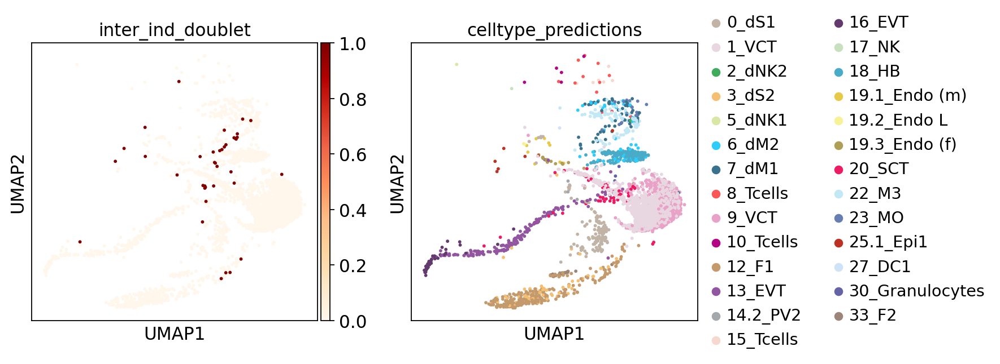

In [141]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474065'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


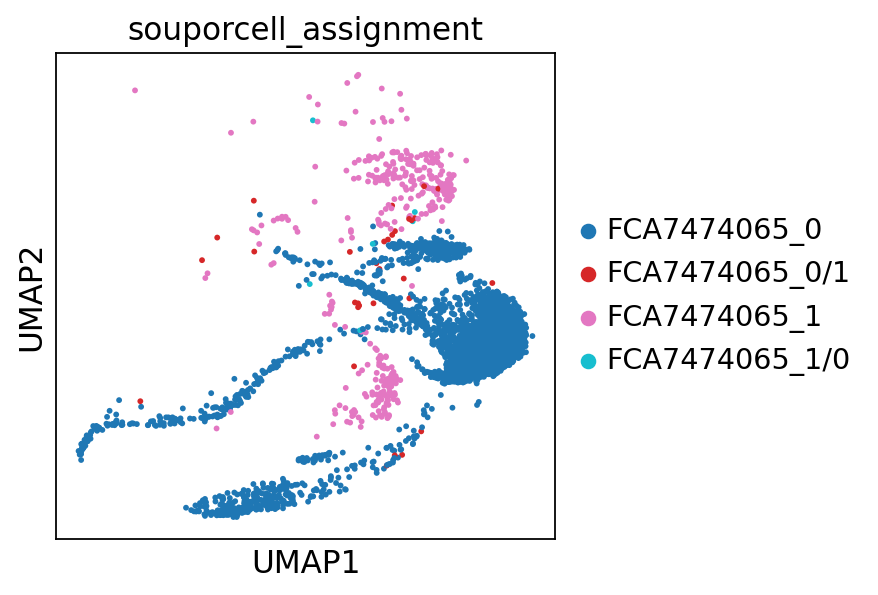

In [142]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474065'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474065:

- 0 --> F
- 1 --> M

In [143]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474066'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474066_0', 'FCA7474066_1', 'FCA7474066_1/0'], dtype=object),
 array([  72, 4506,   35]))

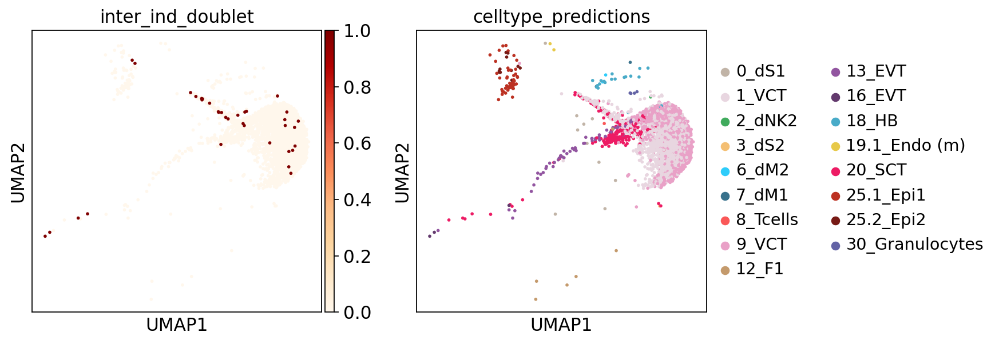

In [144]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474066'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


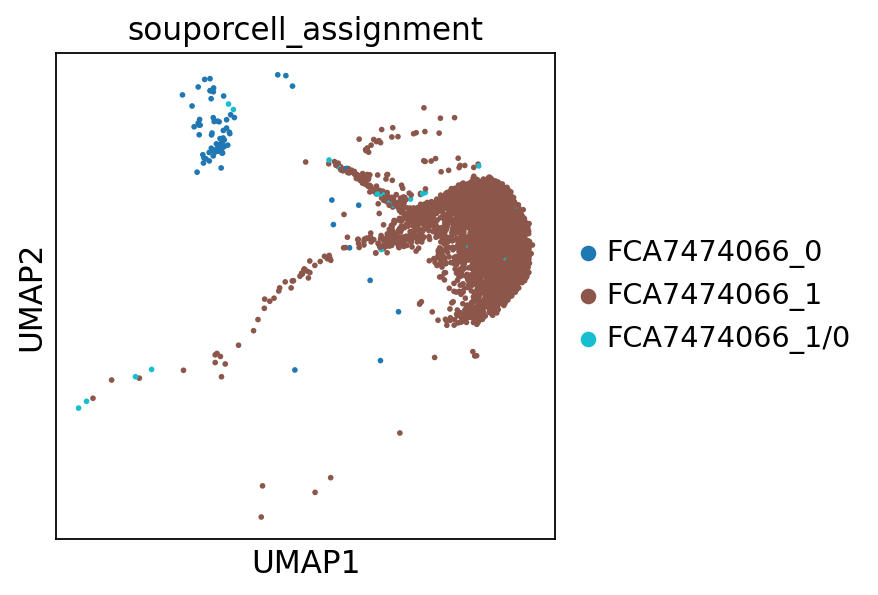

In [145]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474066'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474066:

- 1 --> F
- 0 --> M

In [146]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474068'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474068_0', 'FCA7474068_0/1', 'FCA7474068_1', 'FCA7474068_1/0'],
       dtype=object),
 array([ 162,    7, 3223,   23]))

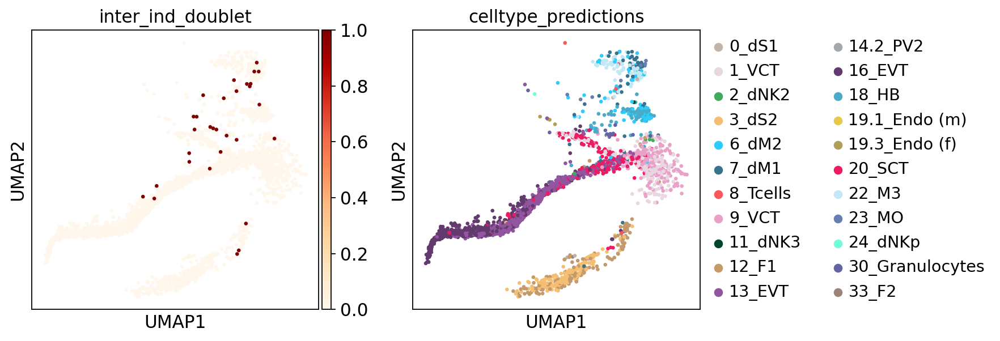

In [147]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474068'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


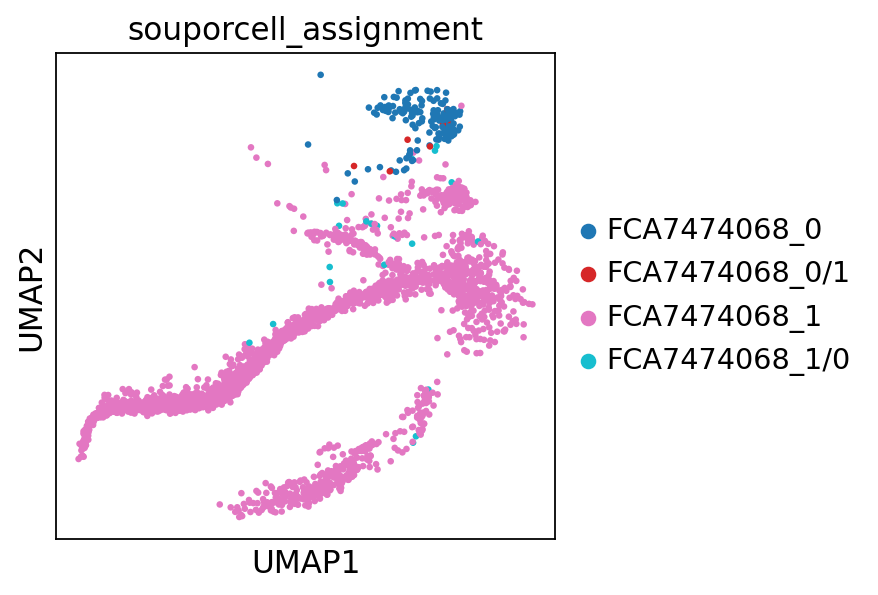

In [148]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474068'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474068:

- 1 --> F
- 0 --> M

In [149]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474069'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7474069_0', 'FCA7474069_0/1', 'FCA7474069_1', 'FCA7474069_1/0'],
       dtype=object),
 array([ 15,   1, 217,   5]))

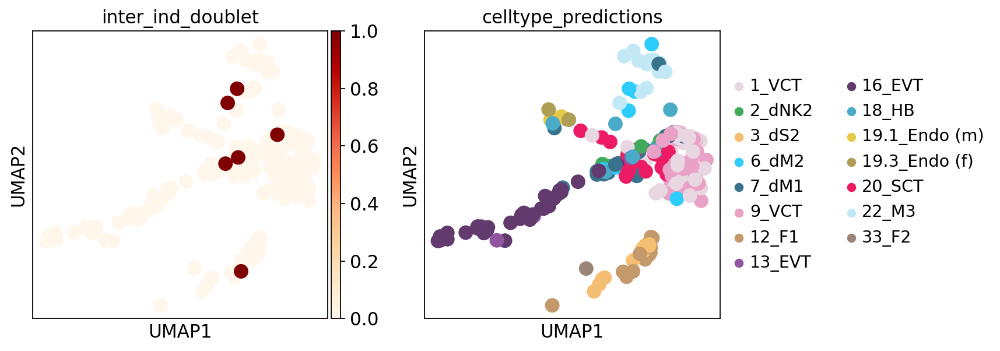

In [150]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474069'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


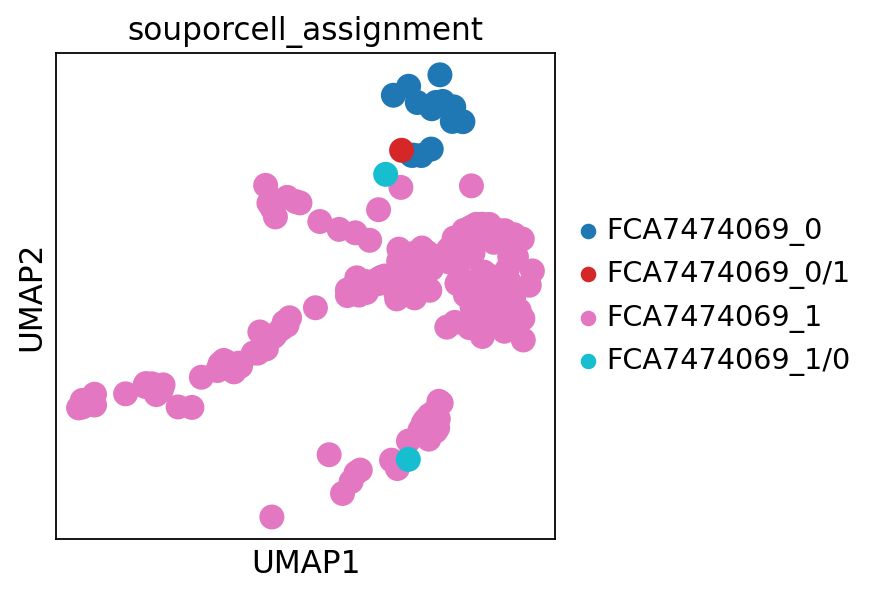

In [151]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7474069'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7474069:

- 1 --> F
- 0 --> M

In [152]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511881'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511881_0', 'FCA7511881_0/1', 'FCA7511881_1', 'FCA7511881_1/0'],
       dtype=object),
 array([780, 168, 873, 151]))

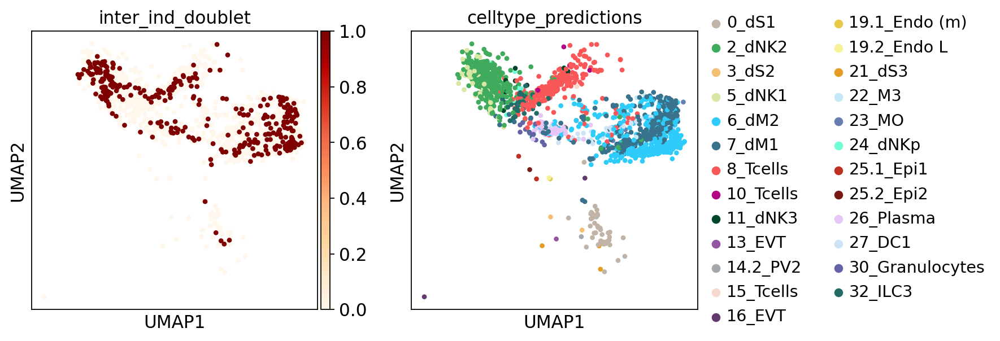

In [153]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511881'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


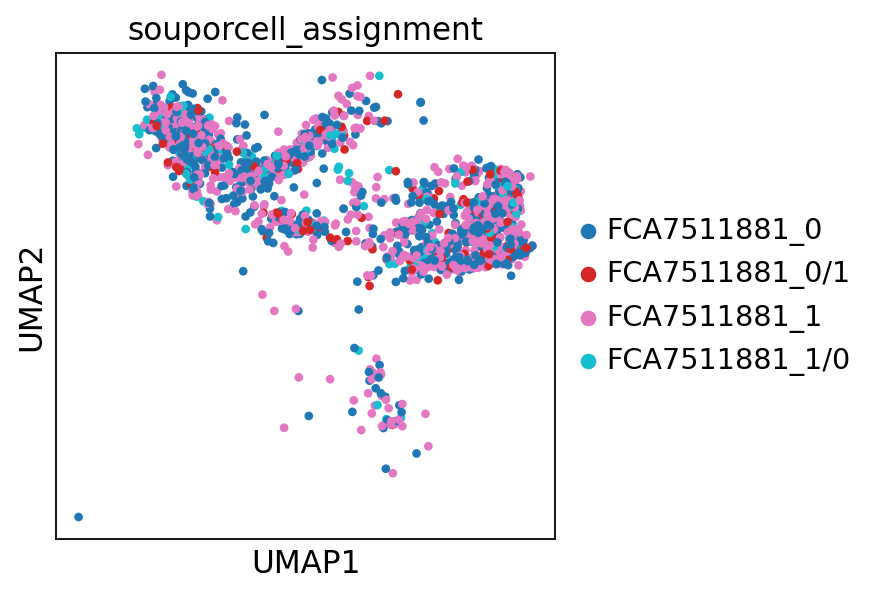

In [154]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511881'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511881:

- all M 

In [155]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511882'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511882_0', 'FCA7511882_0/1', 'FCA7511882_1', 'FCA7511882_1/0'],
       dtype=object),
 array([  13,    2, 2040,  100]))

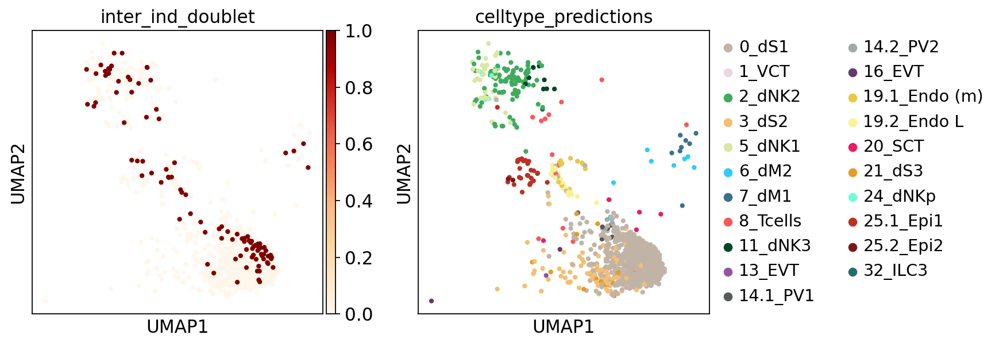

In [156]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511882'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


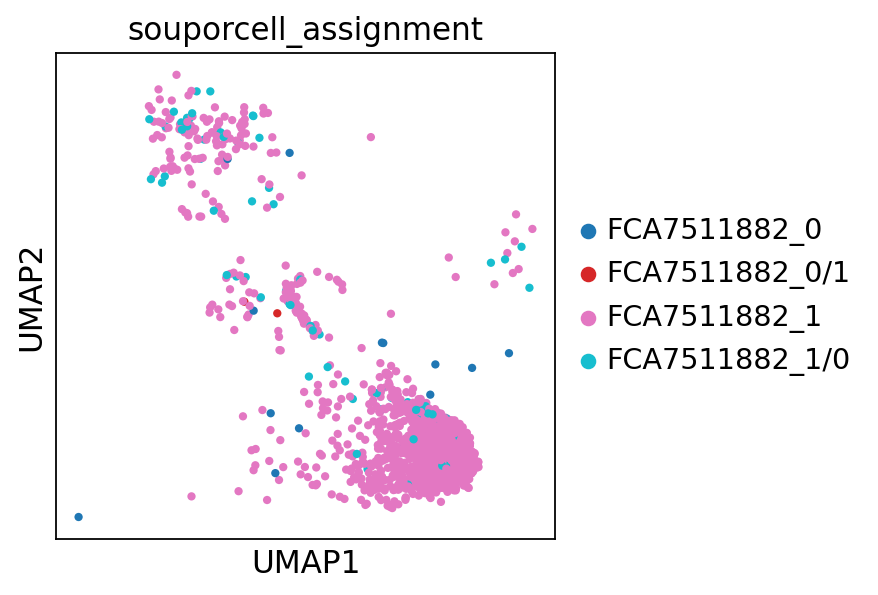

In [157]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511882'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511882:

- 1 --> M
- 0 --> F

In [158]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511883'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511883_0', 'FCA7511883_0/1', 'FCA7511883_1', 'FCA7511883_1/0'],
       dtype=object),
 array([300,  19, 185,   6]))

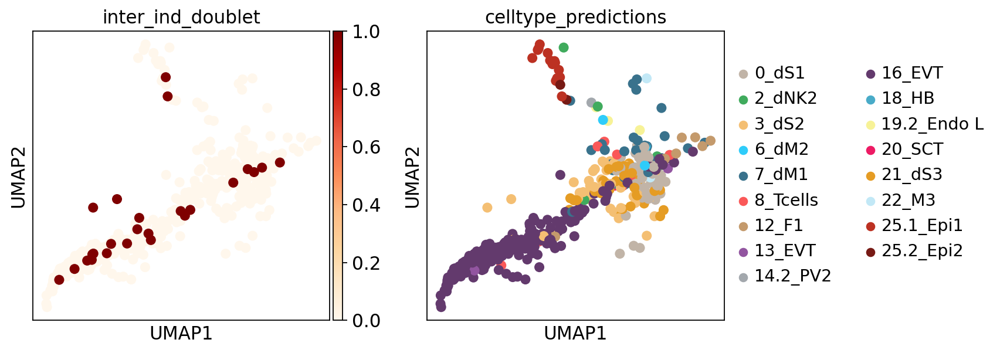

In [159]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511883'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


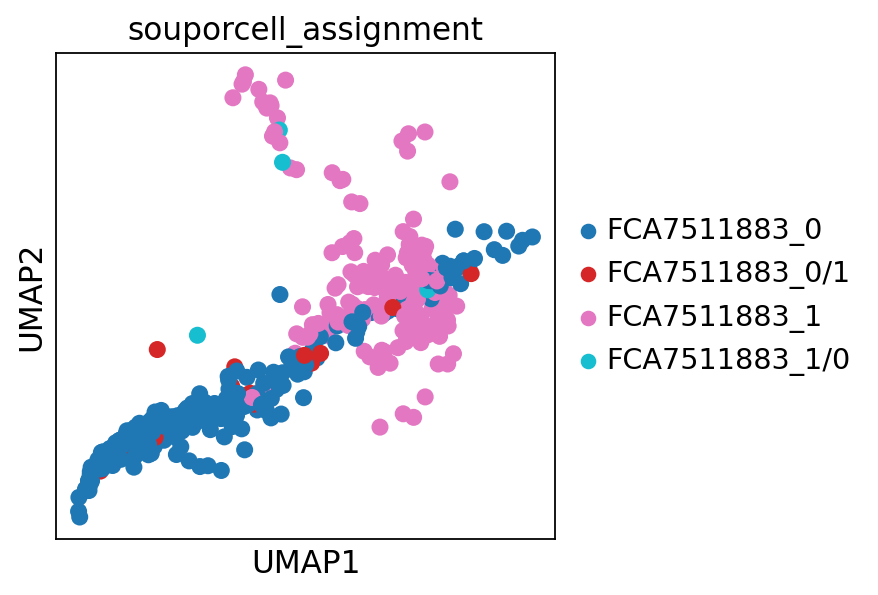

In [160]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511883'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511883:

- 1 --> M
- 0 --> F

In [161]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511884'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511884_0', 'FCA7511884_0/1', 'FCA7511884_1', 'FCA7511884_1/0'],
       dtype=object),
 array([2443,   41, 1593,   22]))

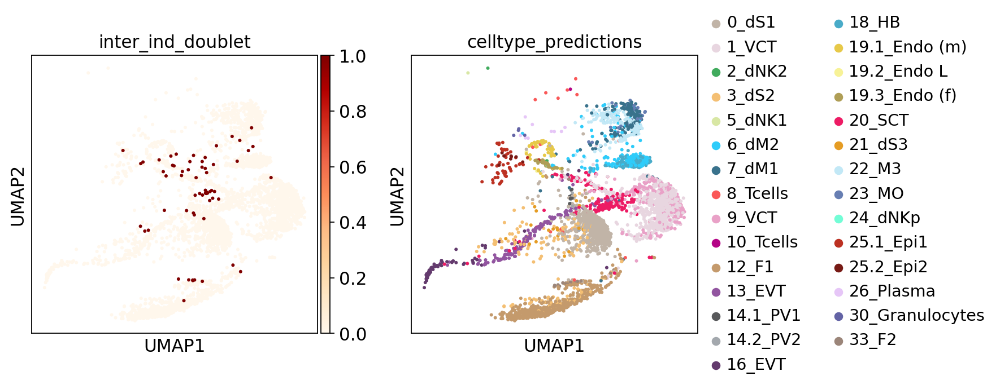

In [162]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511884'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


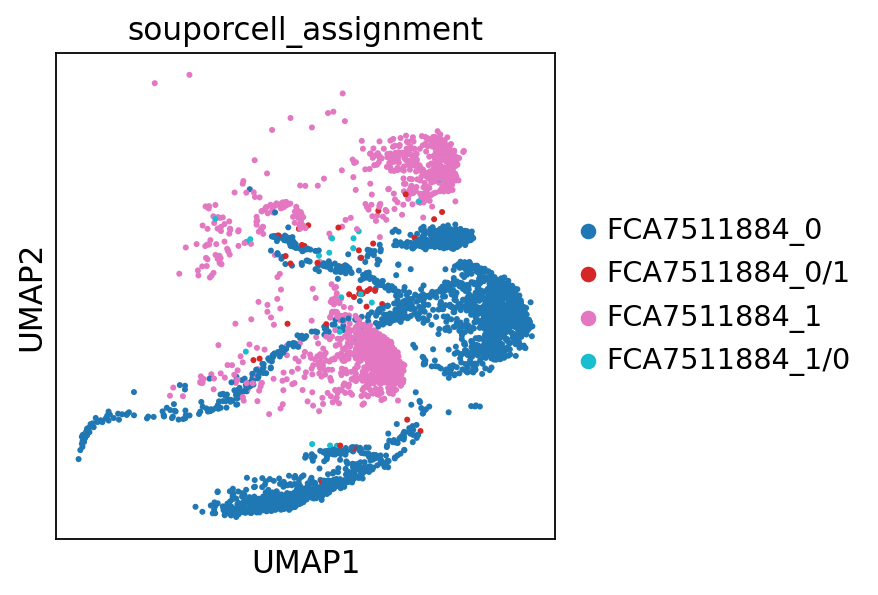

In [163]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511884'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511884:

- 0 --> F
- 1 --> M

In [164]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511885'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511885_0', 'FCA7511885_0/1', 'FCA7511885_1', 'FCA7511885_1/0'],
       dtype=object),
 array([ 273,   17, 3279,   40]))

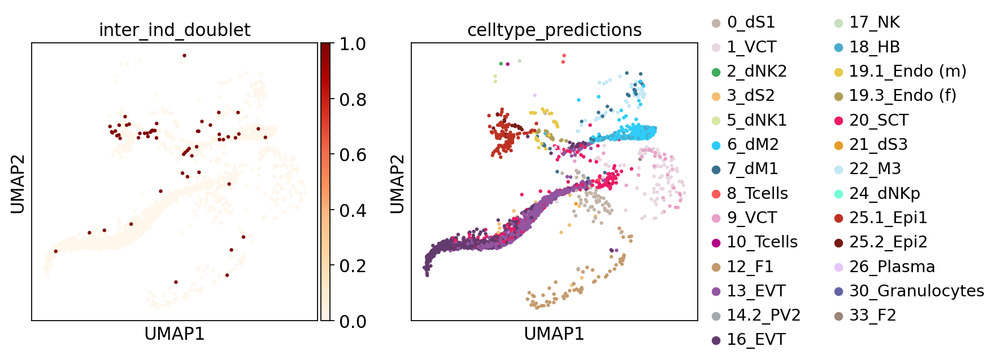

In [165]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511885'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


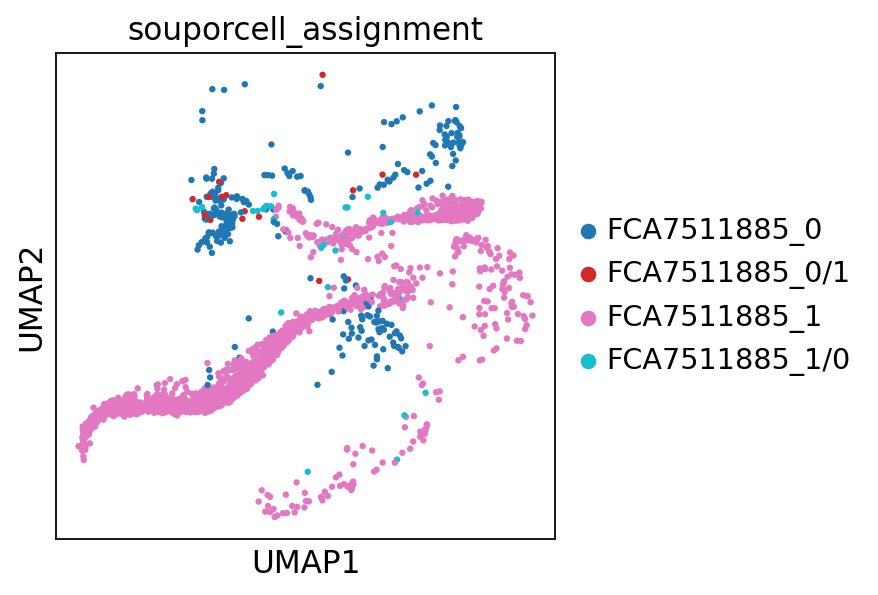

In [166]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511885'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511885:

- 1 --> F
- 0 --> M

In [167]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511886'].obs['souporcell_assignment'], return_counts=True)

(array(['FCA7511886_0', 'FCA7511886_0/1', 'FCA7511886_1', 'FCA7511886_1/0'],
       dtype=object),
 array([2246,   37,  446,   10]))

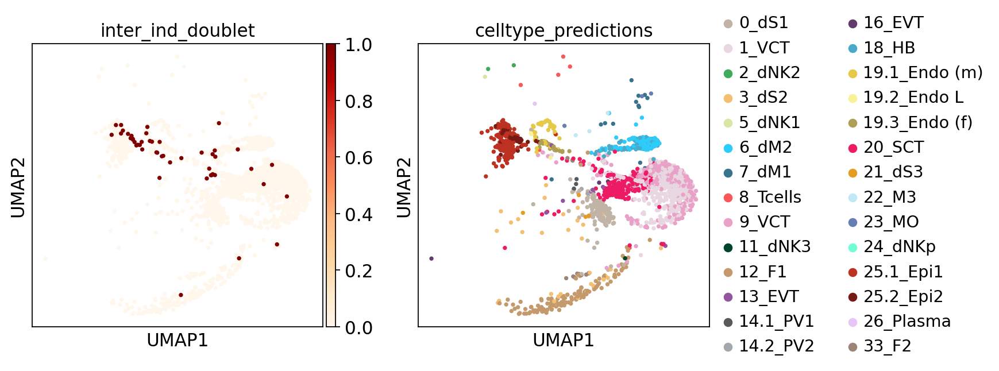

In [168]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511886'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


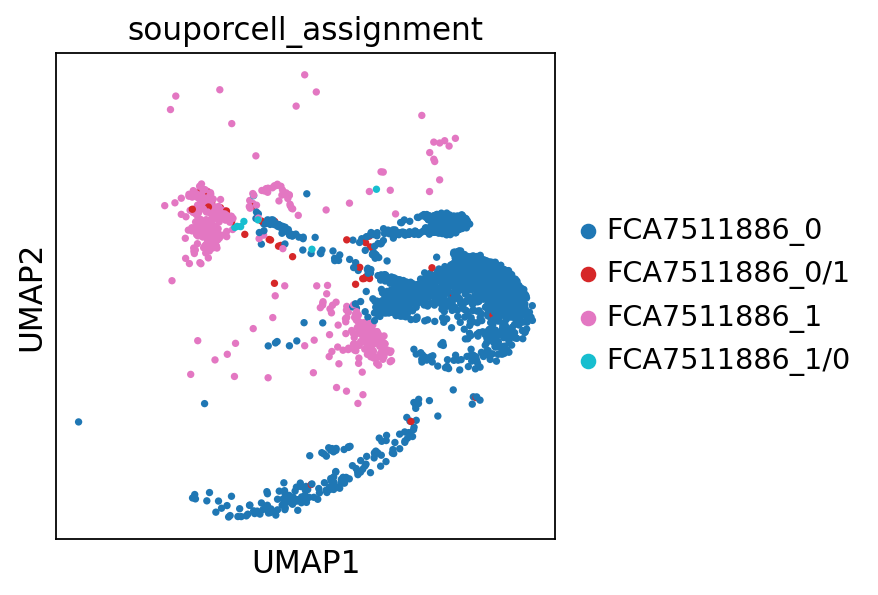

In [169]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511886'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample FCA7511886:

- 0 --> F
- 1 --> M

In [170]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142767_0', 'Pla_HDBR10142767_0/1', 'Pla_HDBR10142767_1',
        'Pla_HDBR10142767_1/0'], dtype=object),
 array([5386,  562,   95,   20]))

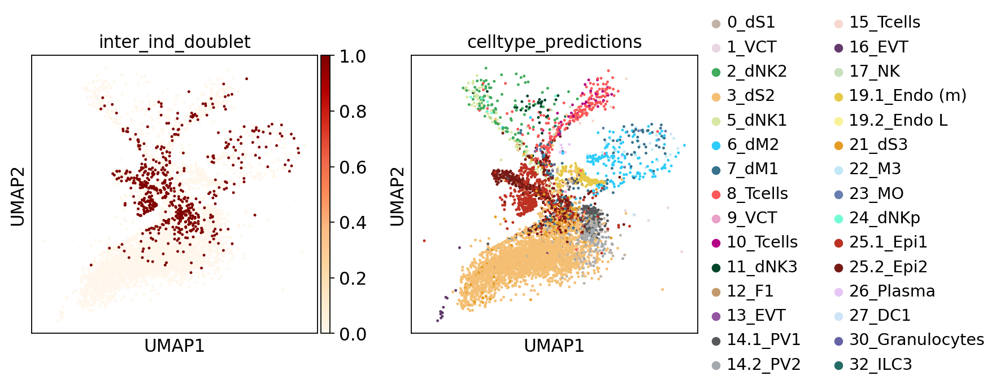

In [171]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


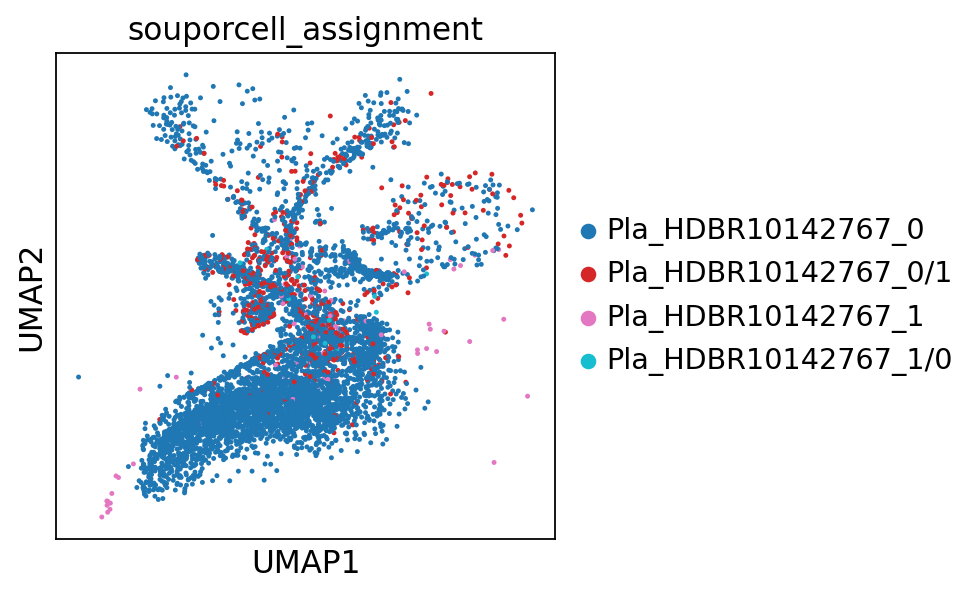

In [172]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142767:

- 1 --> F
- 0 --> M

In [173]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142768_0', 'Pla_HDBR10142768_0/1', 'Pla_HDBR10142768_1',
        'Pla_HDBR10142768_1/0'], dtype=object),
 array([5918,  471,   66,    4]))

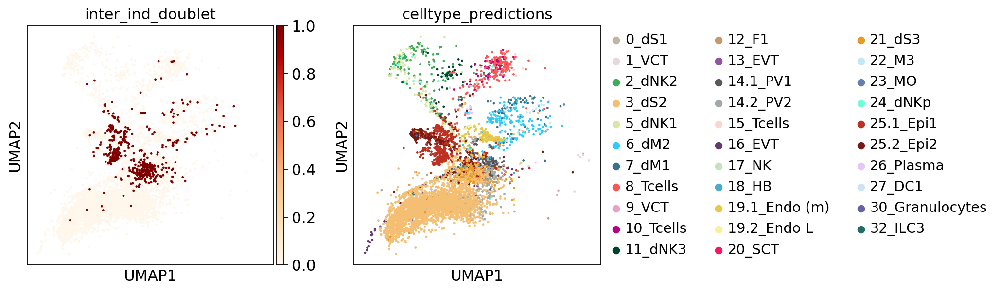

In [174]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


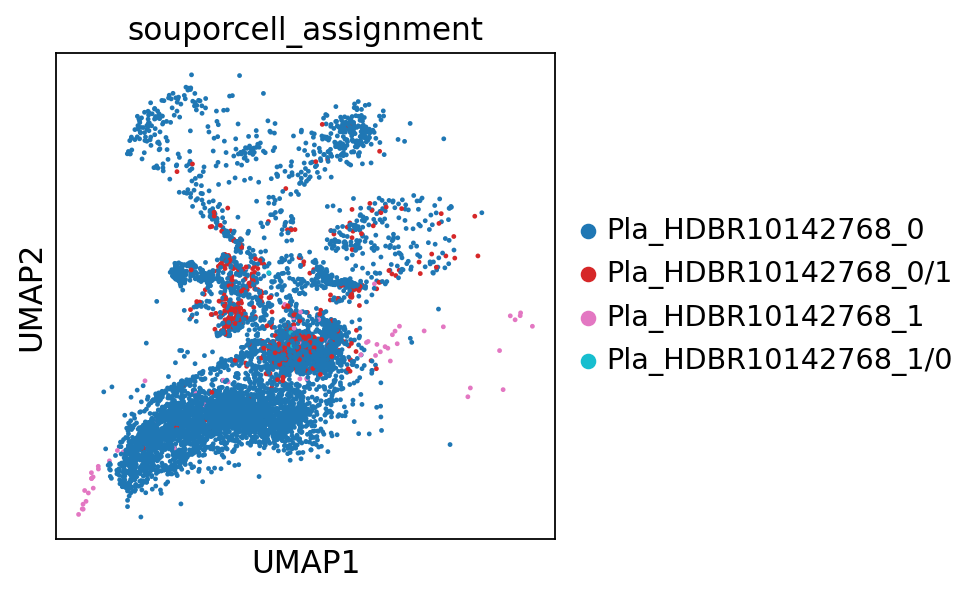

In [175]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142768:

- 1 --> F
- 0 --> M

In [176]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142769_0', 'Pla_HDBR10142769_0/1', 'Pla_HDBR10142769_1',
        'Pla_HDBR10142769_1/0'], dtype=object),
 array([11769,  2250,   492,    31]))

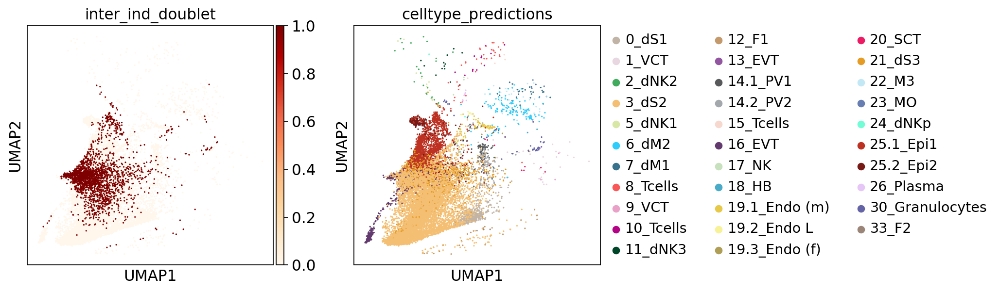

In [177]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


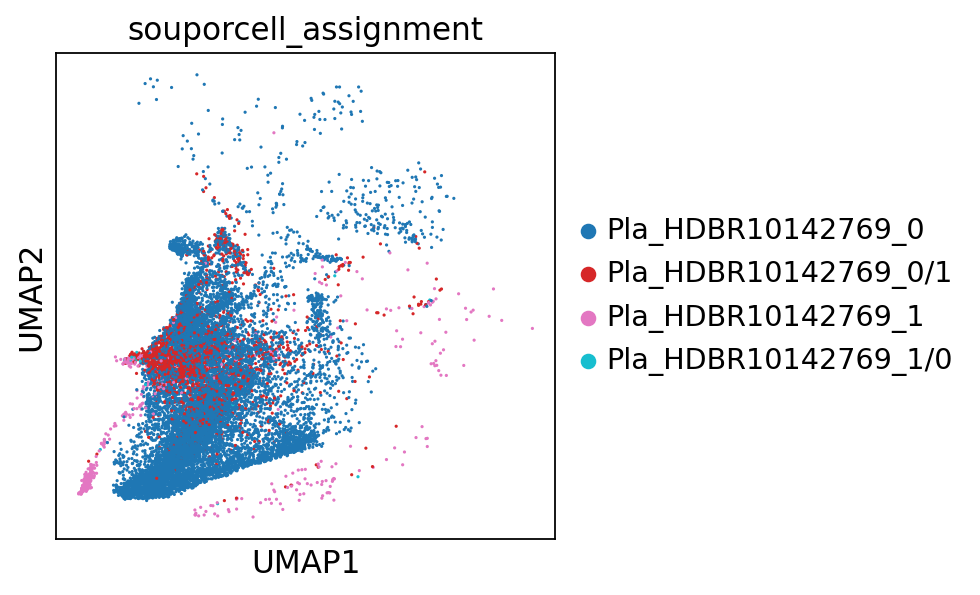

In [178]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142769:

- 1 --> F
- 0 --> M

In [179]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142770_0', 'Pla_HDBR10142770_0/1', 'Pla_HDBR10142770_1',
        'Pla_HDBR10142770_1/0'], dtype=object),
 array([9275, 1976,  427,   91]))

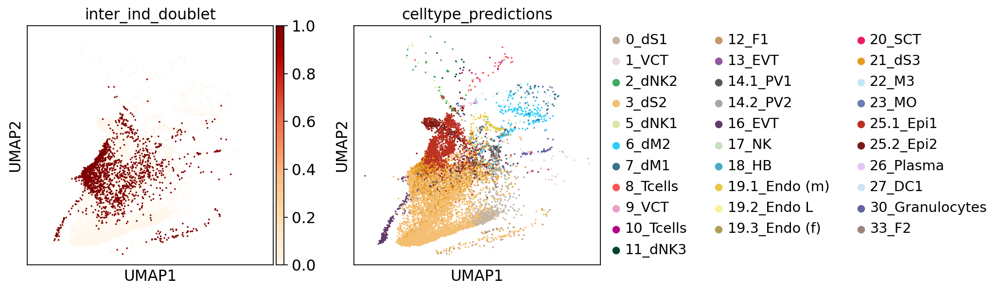

In [180]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


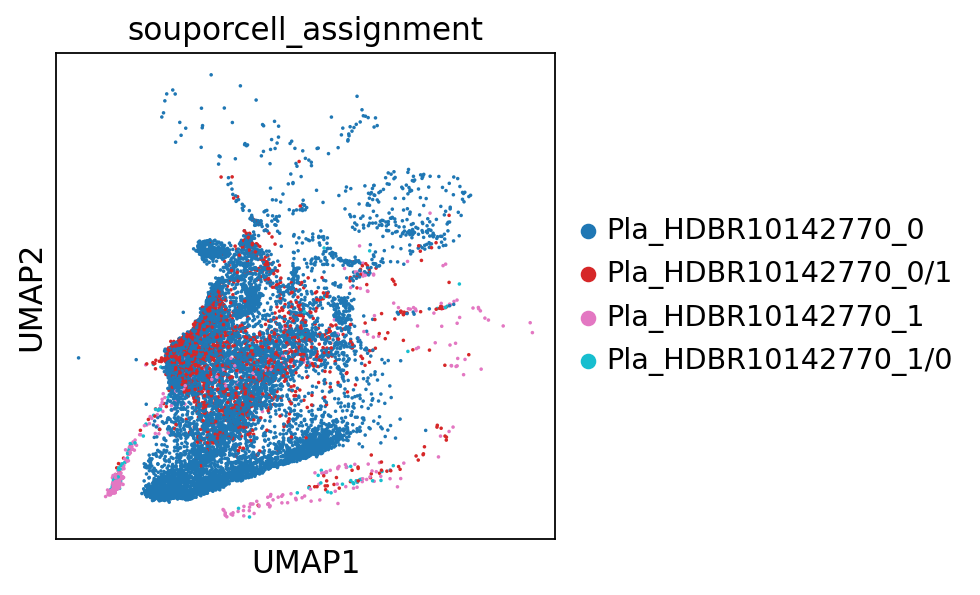

In [181]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142770:

- 1 --> F
- 0 --> M

In [182]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624430'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR8624430_0', 'Pla_HDBR8624430_0/1', 'Pla_HDBR8624430_1',
        'Pla_HDBR8624430_1/0'], dtype=object),
 array([1898,  574,   10,    1]))

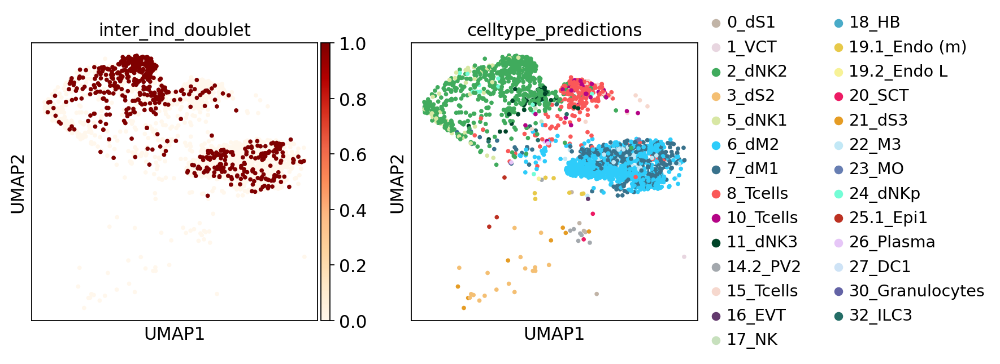

In [183]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624430'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


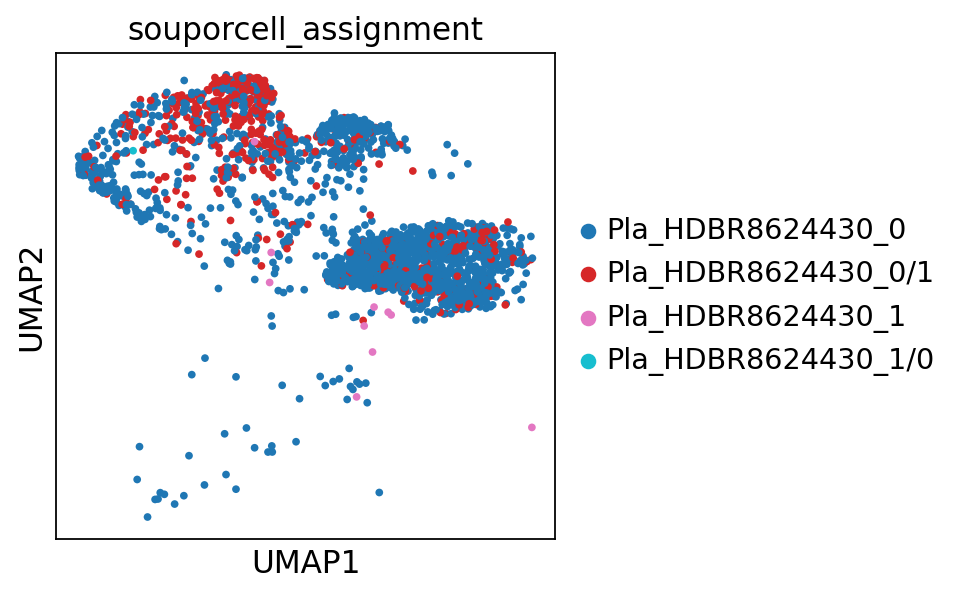

In [184]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624430'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR8624430:

- 1 --> F
- 0 --> M

In [185]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624431'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR8624431_0', 'Pla_HDBR8624431_0/1', 'Pla_HDBR8624431_1',
        'Pla_HDBR8624431_1/0'], dtype=object),
 array([4098,   28,  138,    6]))

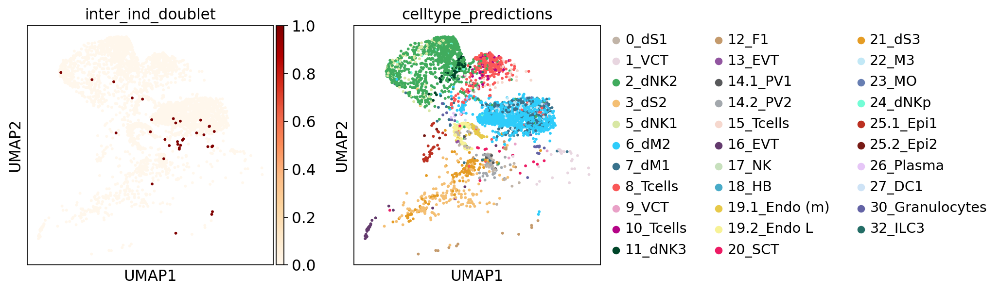

In [186]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624431'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


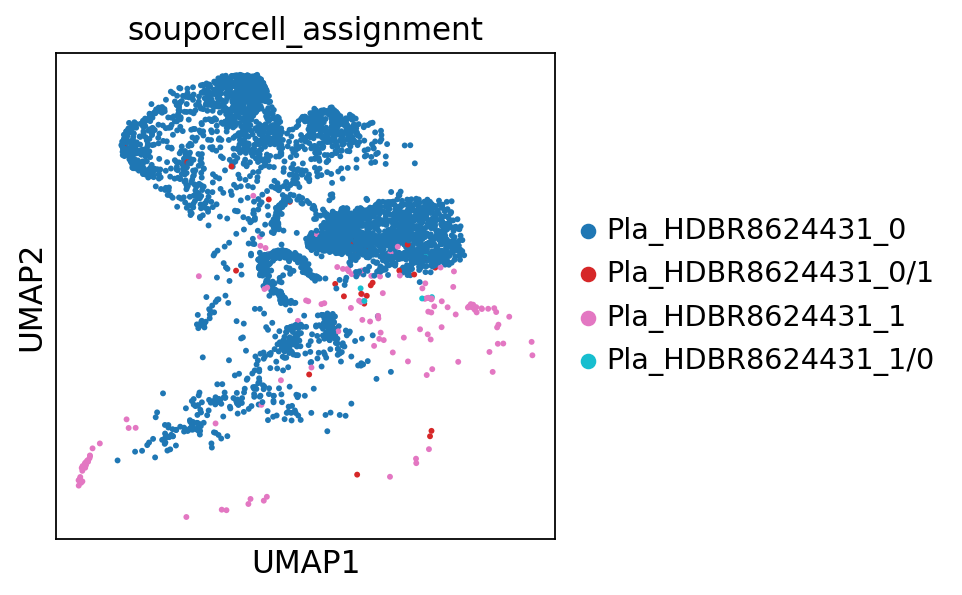

In [187]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8624431'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR8624431:

- 1 --> F
- 0 --> M

In [188]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715512'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR8715512_0', 'Pla_HDBR8715512_0/1', 'Pla_HDBR8715512_1',
        'Pla_HDBR8715512_1/0'], dtype=object),
 array([21,  1, 91,  2]))

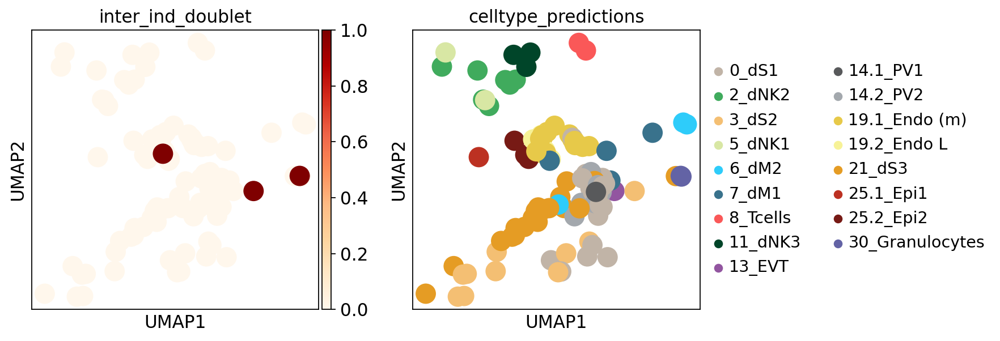

In [189]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715512'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


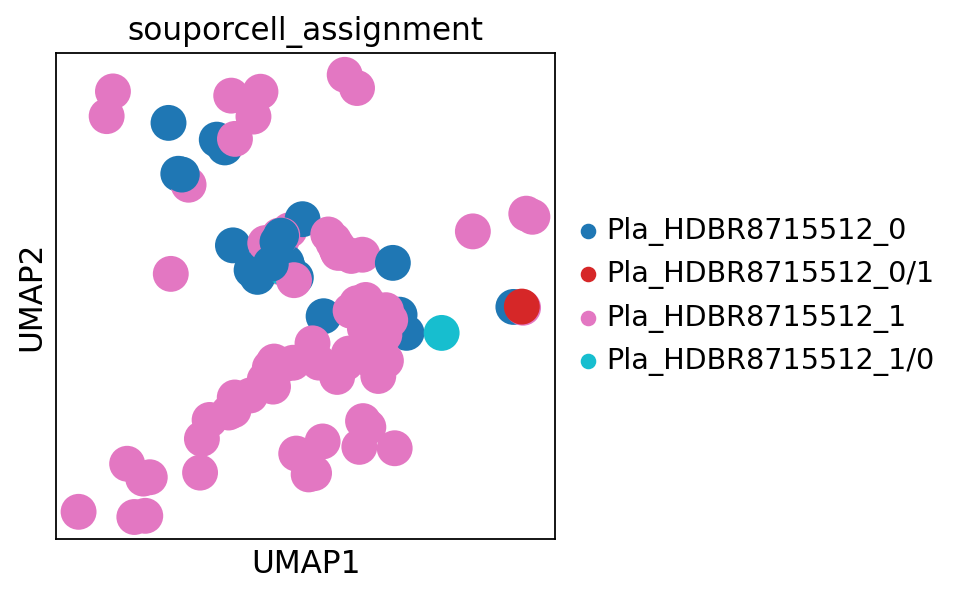

In [190]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715512'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR8715512:

ATTENTION: code names for H2 and H9 coz the exact correspondence is unknown

- 0 --> R0
- 1 --> R1

In [191]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715514'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR8715514_0', 'Pla_HDBR8715514_0/1', 'Pla_HDBR8715514_1',
        'Pla_HDBR8715514_1/0'], dtype=object),
 array([1120,    9,  403,    7]))

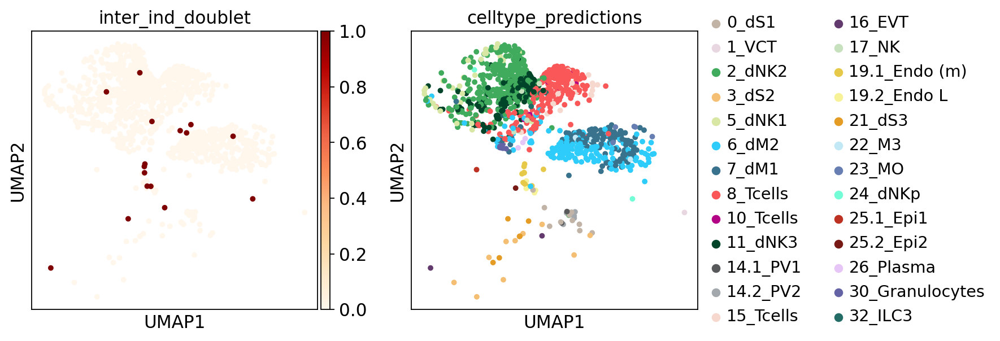

In [192]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715514'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


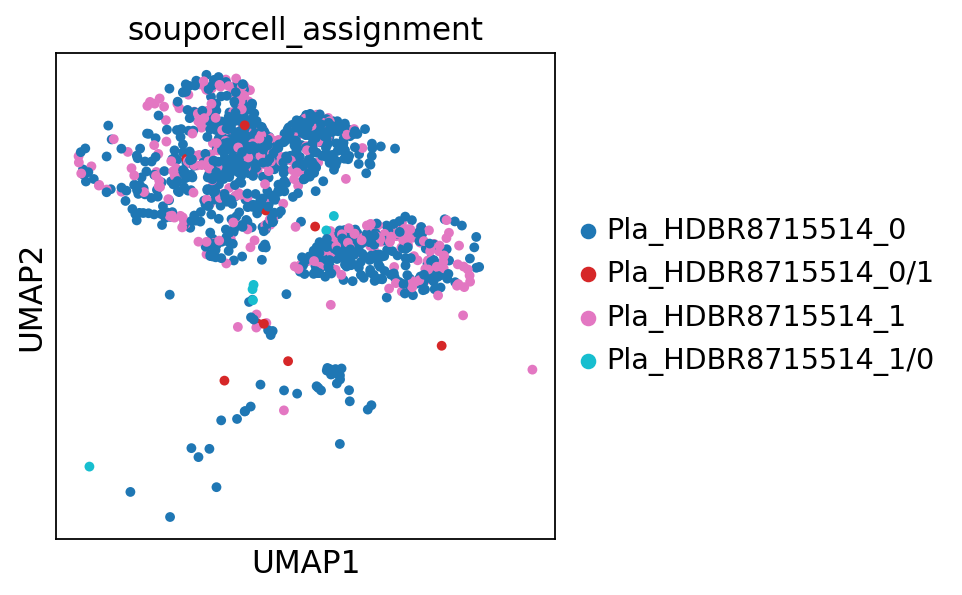

In [193]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8715514'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR8715514:

ATTENTION: code names for H2 and H9 coz the exact correspondence is unknown, from cross-matching with Pla_HDBR8715512 and Pla_HDBR8768477

- 0 --> R1
- 1 --> R0

In [194]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8768477'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR8768477_0', 'Pla_HDBR8768477_0/1', 'Pla_HDBR8768477_1',
        'Pla_HDBR8768477_1/0'], dtype=object),
 array([ 885,   15, 1221,   14]))

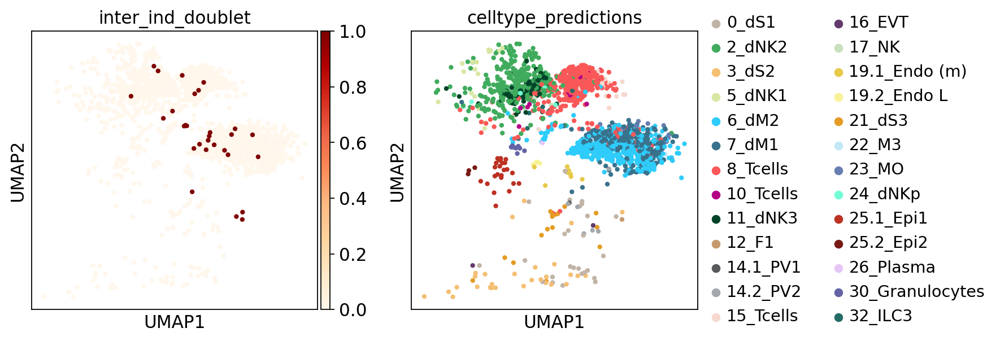

In [195]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8768477'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


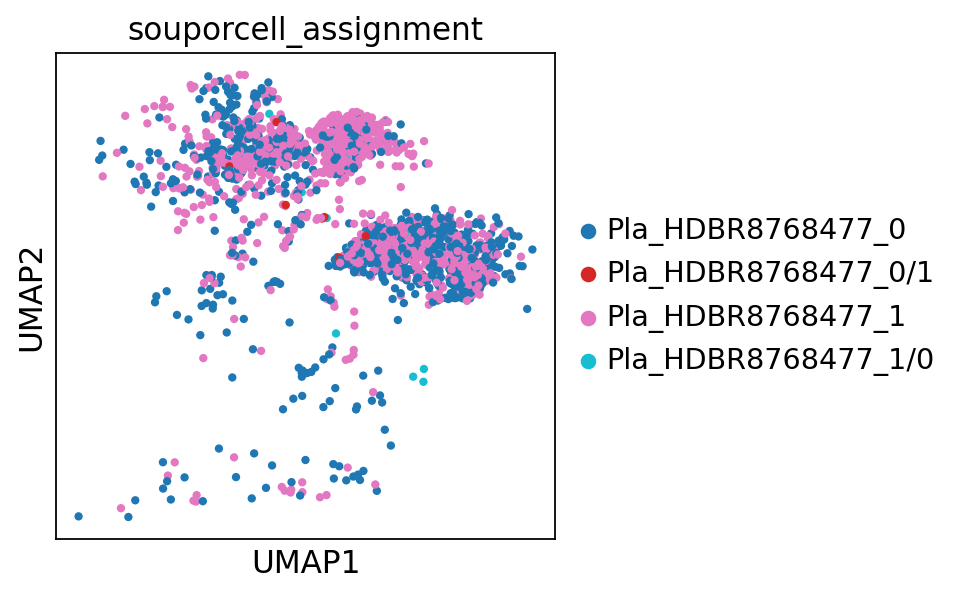

In [196]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR8768477'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR8768477:

ATTENTION: code names for H2 and H9 coz the exact correspondence is unknown, from cross-matching with Pla_HDBR8715512 and Pla_HDBR8715514

- 0 --> R0
- 1 --> R1

In [197]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142767_0', 'Pla_HDBR10142767_0/1', 'Pla_HDBR10142767_1',
        'Pla_HDBR10142767_1/0'], dtype=object),
 array([5386,  562,   95,   20]))

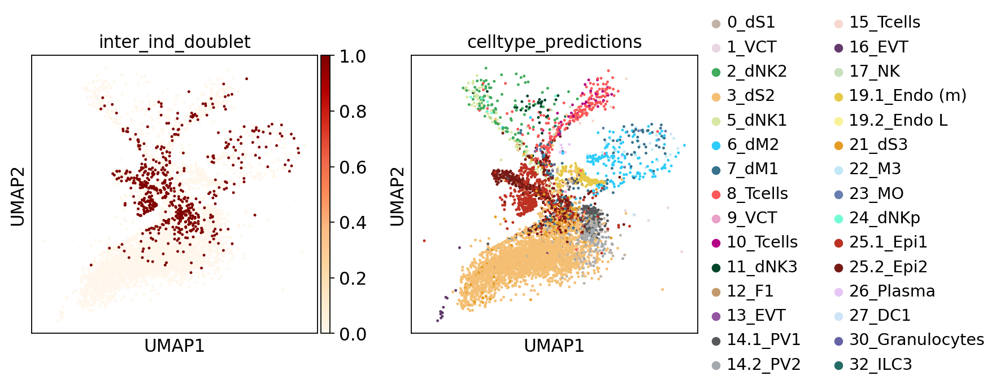

In [198]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


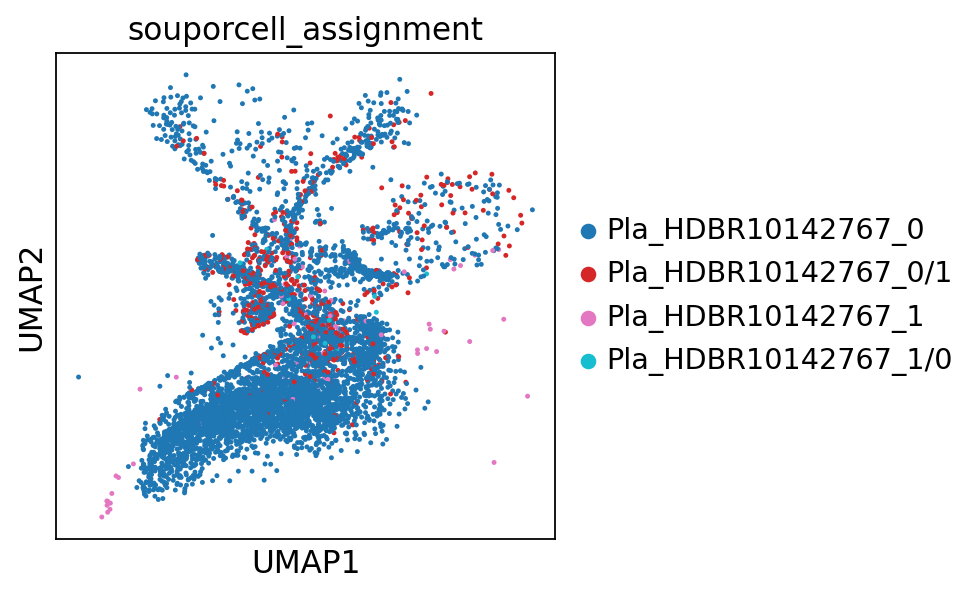

In [199]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142767'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142767:

- 1 --> F
- 0 --> M

In [200]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142768_0', 'Pla_HDBR10142768_0/1', 'Pla_HDBR10142768_1',
        'Pla_HDBR10142768_1/0'], dtype=object),
 array([5918,  471,   66,    4]))

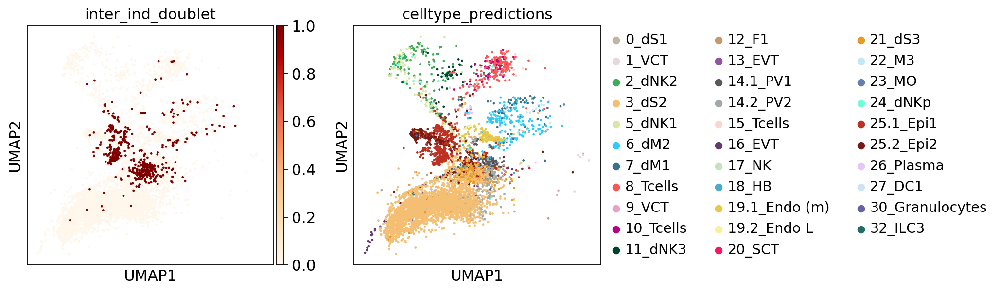

In [201]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


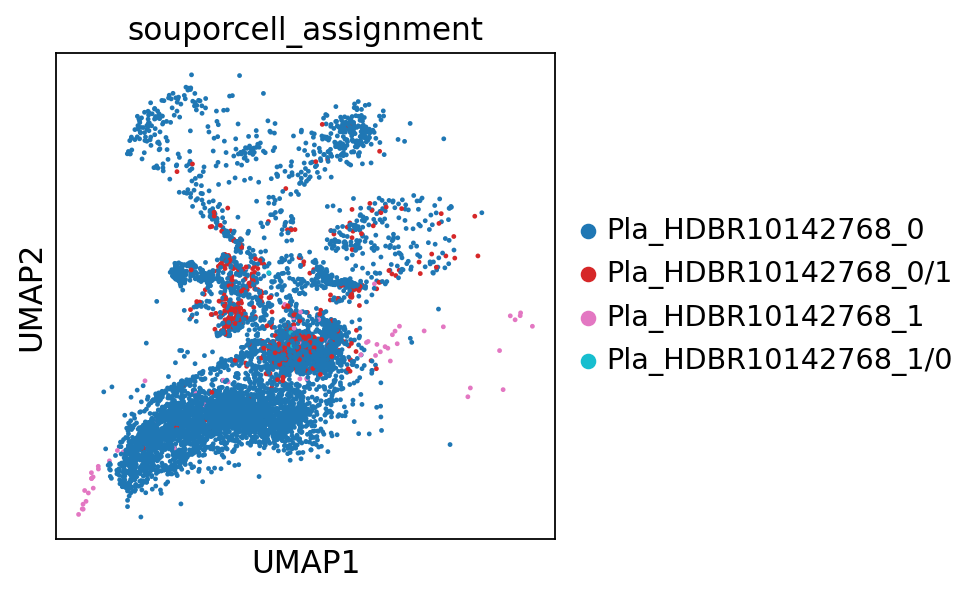

In [202]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142768'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142768:

- 1 --> F
- 0 --> M

In [203]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142769_0', 'Pla_HDBR10142769_0/1', 'Pla_HDBR10142769_1',
        'Pla_HDBR10142769_1/0'], dtype=object),
 array([11769,  2250,   492,    31]))

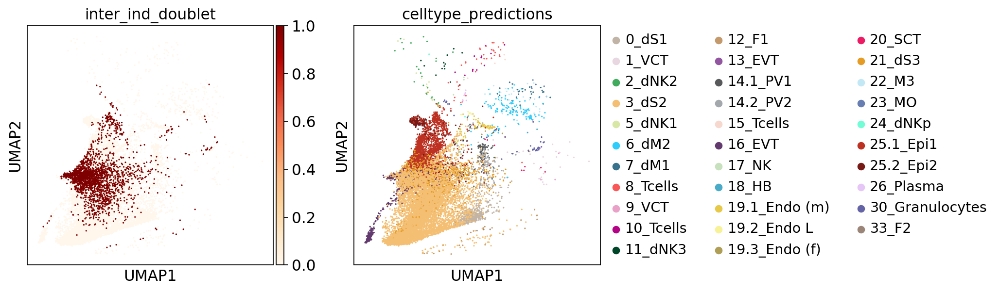

In [204]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


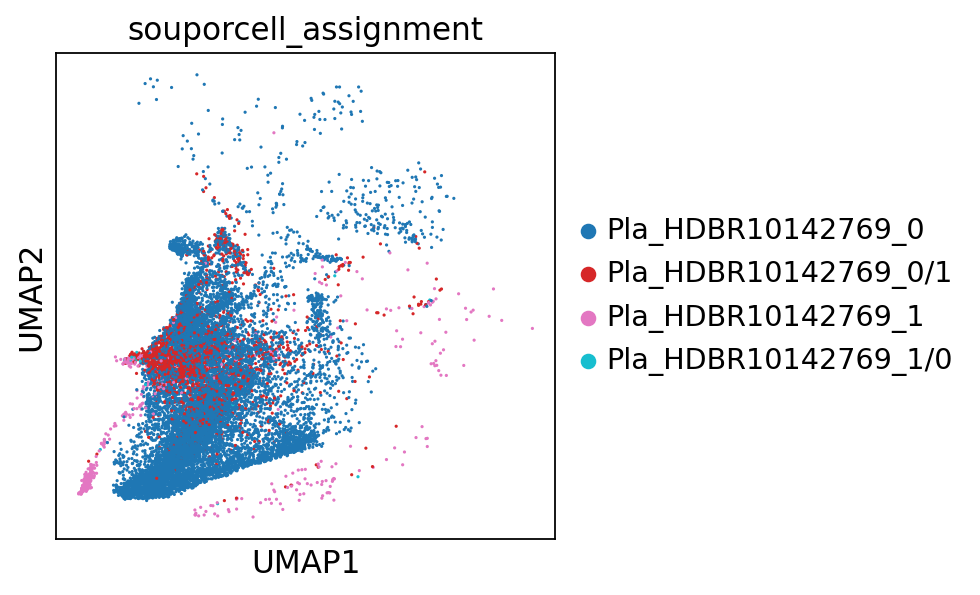

In [205]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142769'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142769:

- 1 --> F
- 0 --> M

In [206]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142770_0', 'Pla_HDBR10142770_0/1', 'Pla_HDBR10142770_1',
        'Pla_HDBR10142770_1/0'], dtype=object),
 array([9275, 1976,  427,   91]))

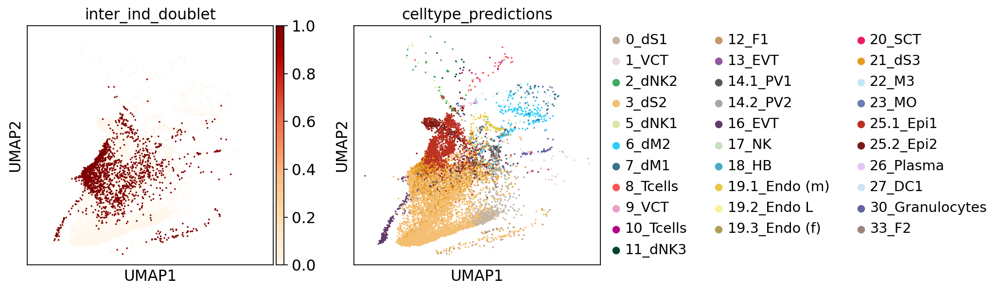

In [207]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


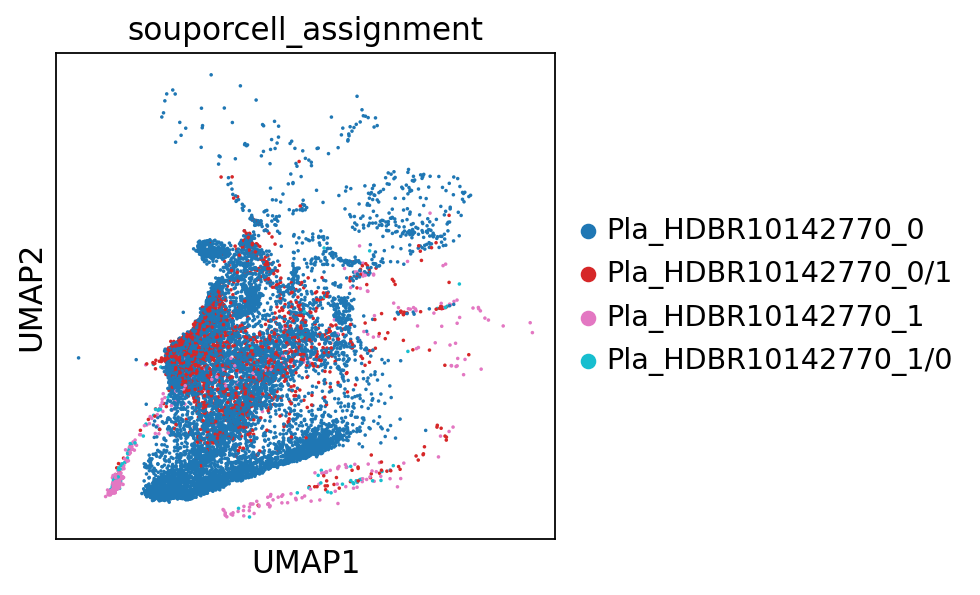

In [208]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142770'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142770:

- 1 --> F
- 0 --> M

In [209]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917730'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10917730_0', 'Pla_HDBR10917730_0/1', 'Pla_HDBR10917730_1',
        'Pla_HDBR10917730_1/0'], dtype=object),
 array([3863,  349, 8531,  481]))

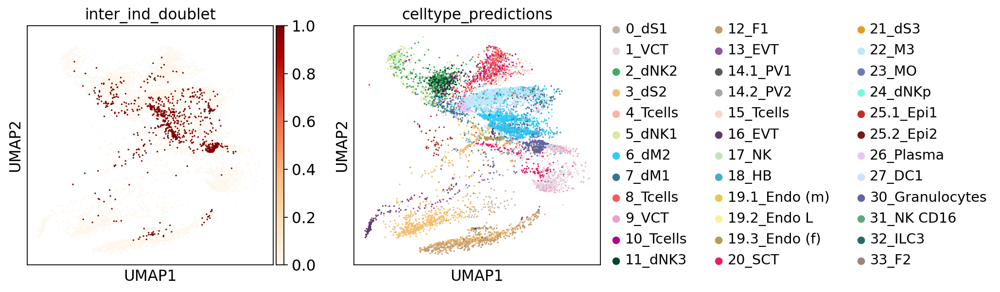

In [210]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917730'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


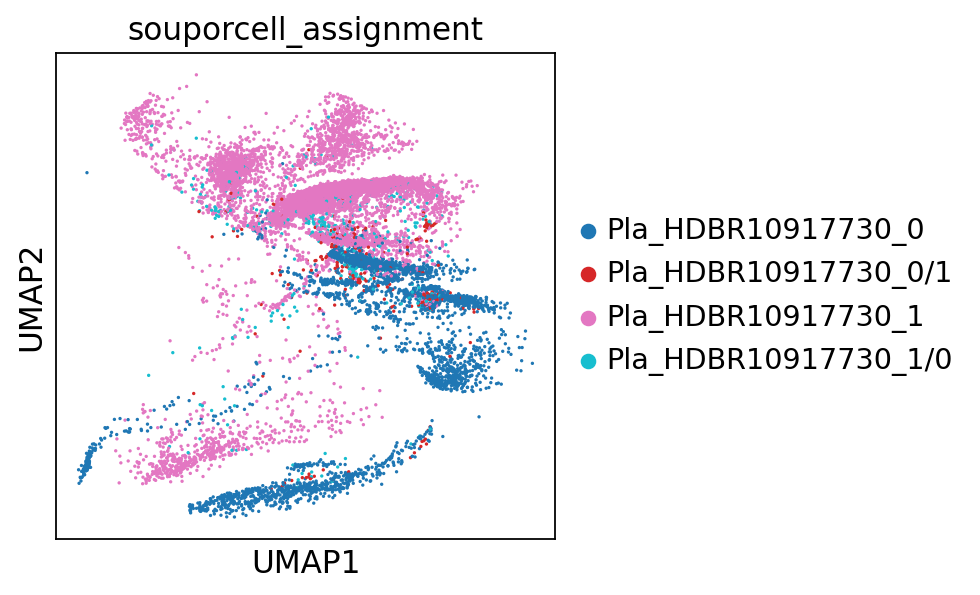

In [211]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917730'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10917730:

- 0 --> F
- 1 --> M

In [212]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917731'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10917731_0', 'Pla_HDBR10917731_0/1', 'Pla_HDBR10917731_1',
        'Pla_HDBR10917731_1/0'], dtype=object),
 array([  531,    46, 11066,   747]))

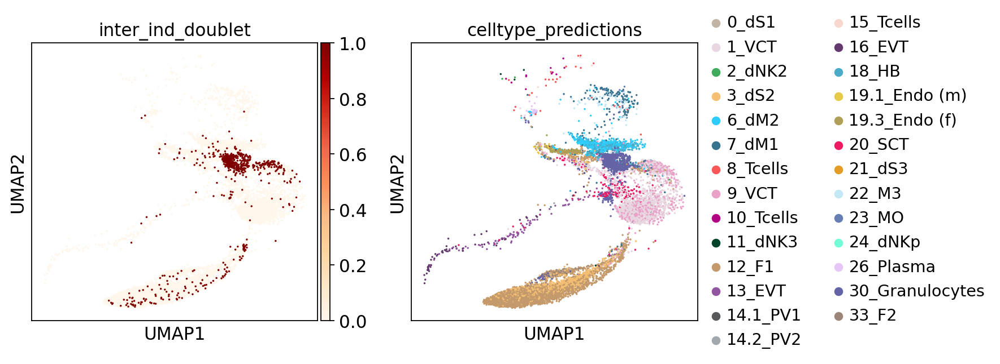

In [213]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917731'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


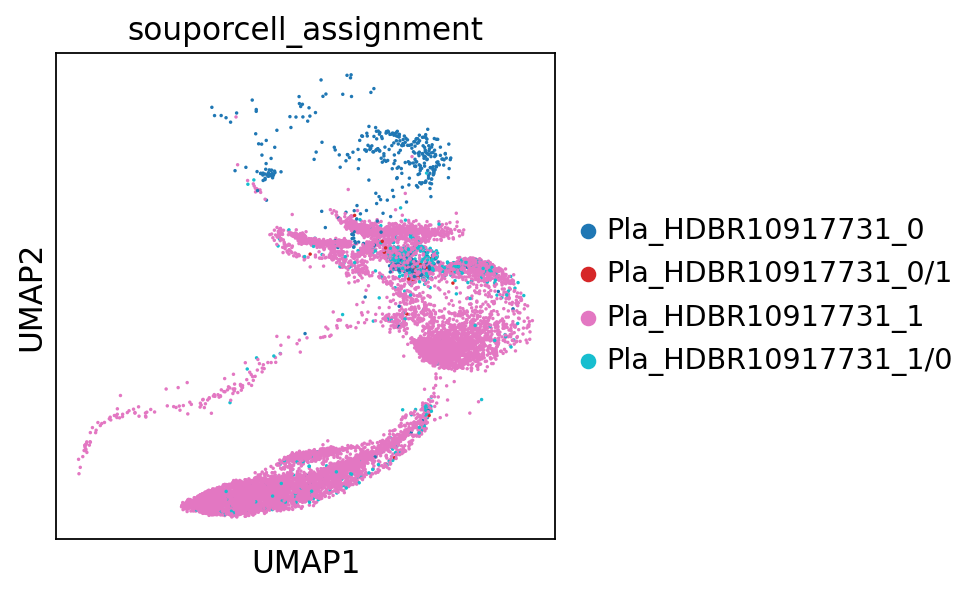

In [214]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917731'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10917731:

- 1 --> F
- 0 --> M

In [215]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917733'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10917733_0', 'Pla_HDBR10917733_0/1', 'Pla_HDBR10917733_1',
        'Pla_HDBR10917733_1/0'], dtype=object),
 array([15020,   440,   456,    46]))

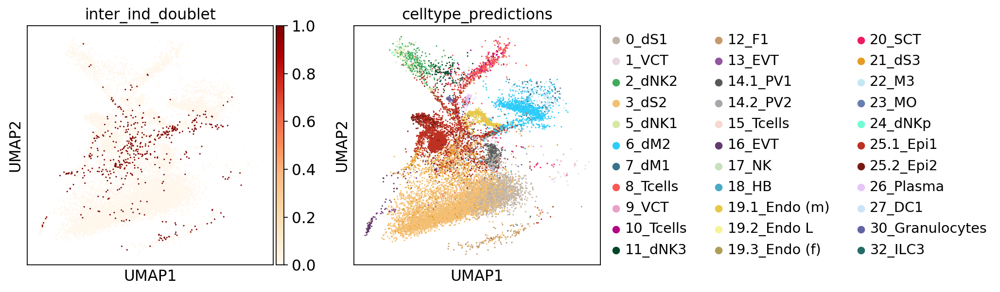

In [216]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917733'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


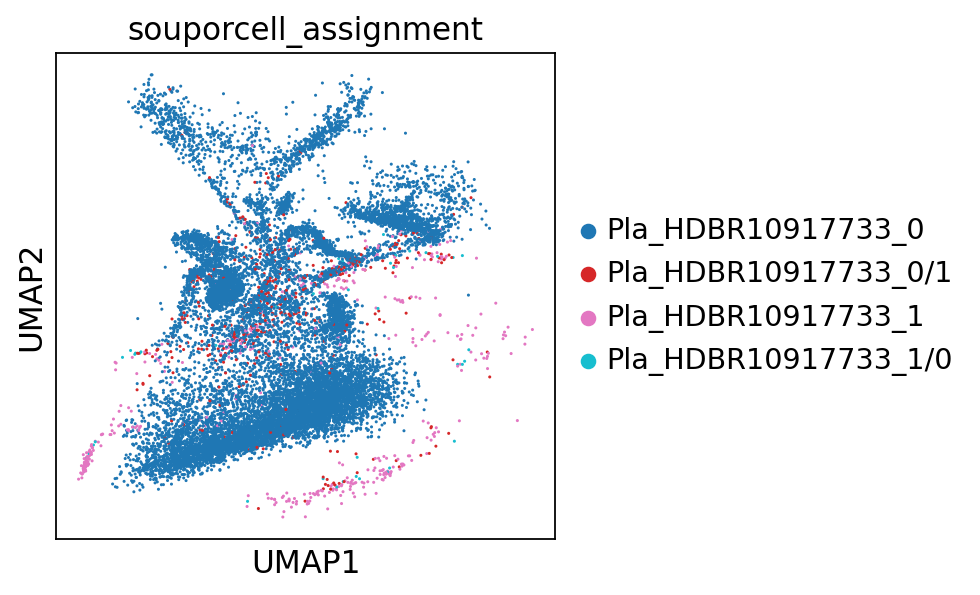

In [217]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10917733'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10917733:

- 1 --> F
- 0 --> M

In [218]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701667'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10701667_0', 'Pla_HDBR10701667_0/1', 'Pla_HDBR10701667_1',
        'Pla_HDBR10701667_1/0'], dtype=object),
 array([6909, 1065, 7067, 1000]))

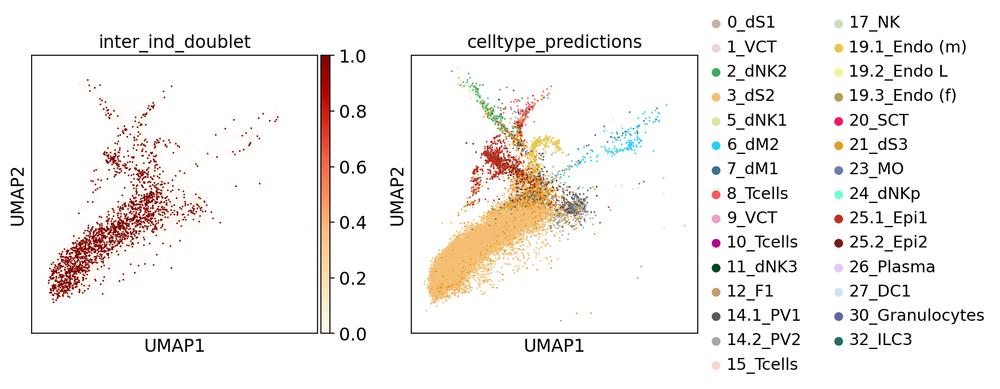

In [219]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701667'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


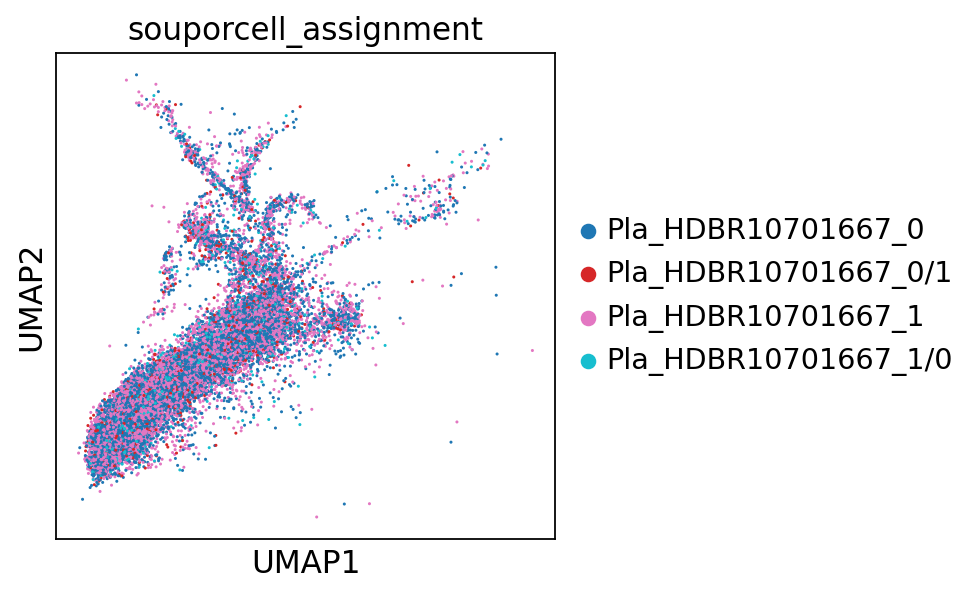

In [220]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701667'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10701667:

All M

In [221]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701668'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10701668_0', 'Pla_HDBR10701668_0/1', 'Pla_HDBR10701668_1',
        'Pla_HDBR10701668_1/0'], dtype=object),
 array([5095,  662, 5112,  685]))

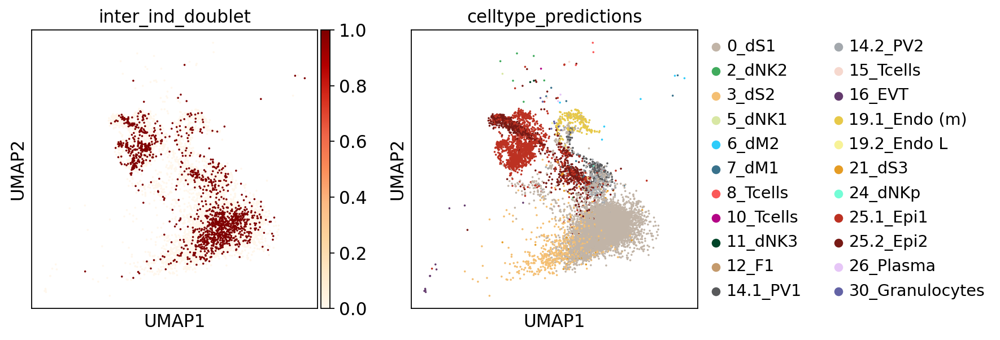

In [222]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701668'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


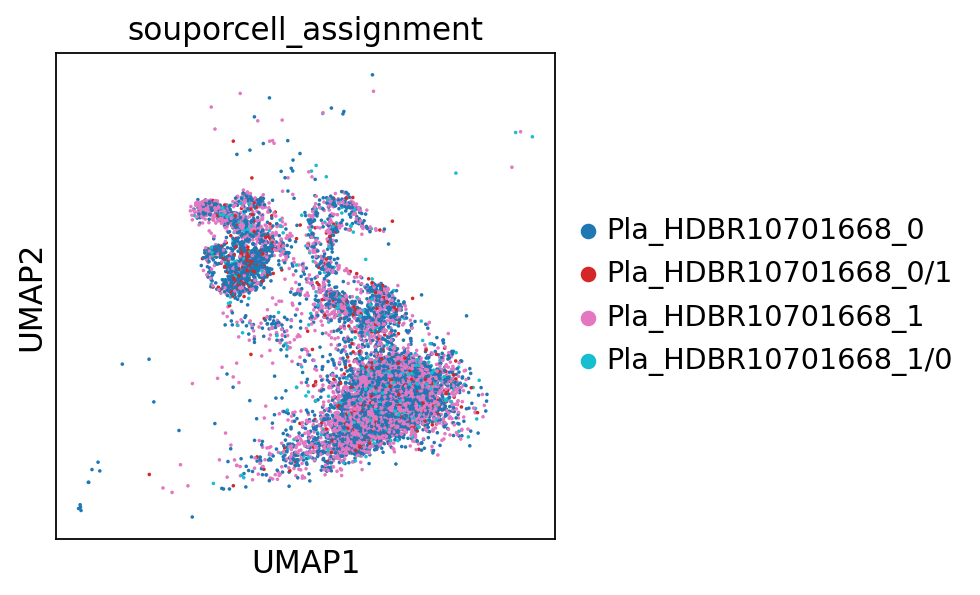

In [223]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701668'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10701668:

All M

In [224]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764121'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8764121_0', 'WSSS_PLA8764121_0/1', 'WSSS_PLA8764121_1',
        'WSSS_PLA8764121_1/0'], dtype=object),
 array([5185,  997, 3781,  668]))

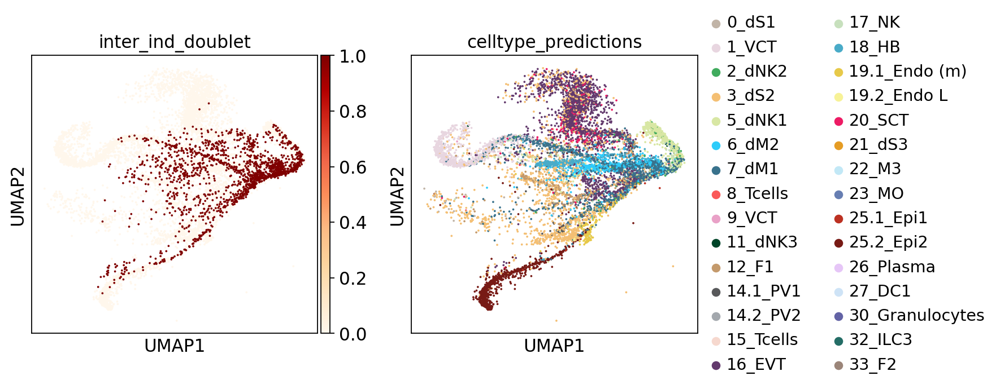

In [225]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764121'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


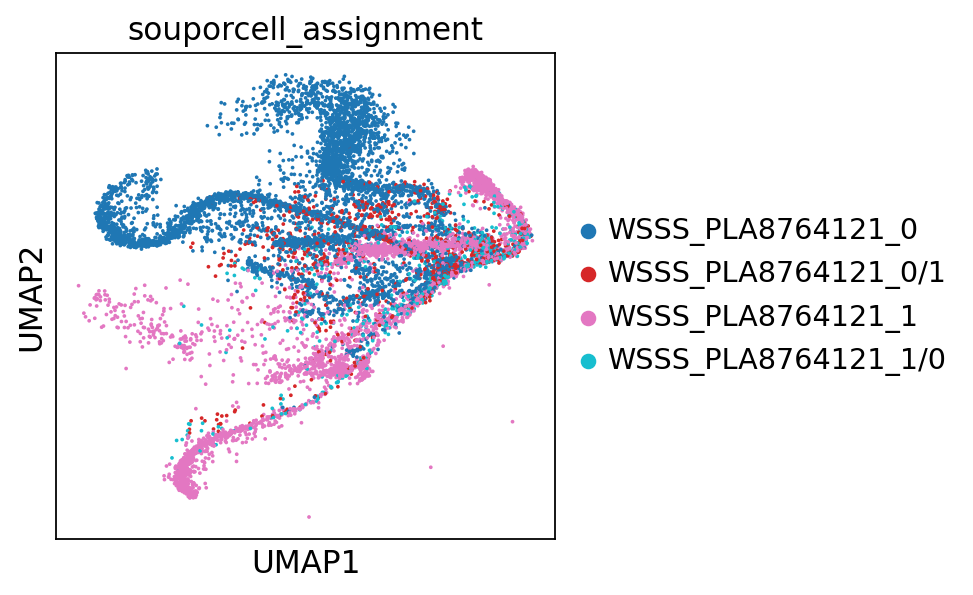

In [226]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764121'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8764121:

- 0 --> F
- 1 --> M

In [227]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764122'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8764122_0', 'WSSS_PLA8764122_0/1', 'WSSS_PLA8764122_1',
        'WSSS_PLA8764122_1/0'], dtype=object),
 array([5137, 1139, 3705,  683]))

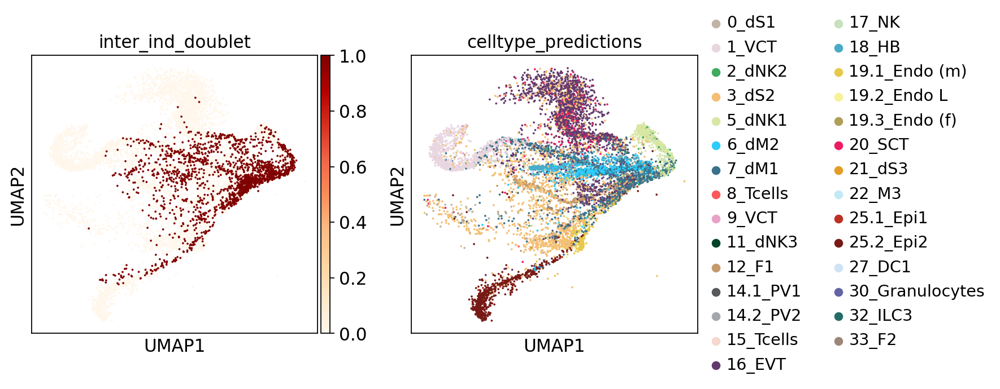

In [228]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764122'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


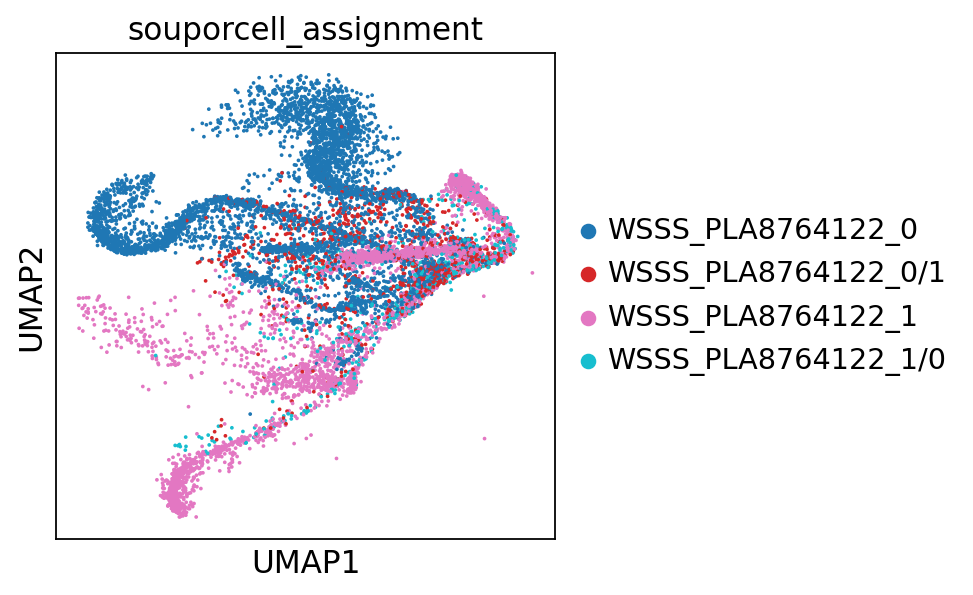

In [229]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8764122'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8764122:

- 0 --> F
- 1 --> M

In [230]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810750'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8810750_0', 'WSSS_PLA8810750_0/1', 'WSSS_PLA8810750_1',
        'WSSS_PLA8810750_1/0'], dtype=object),
 array([13150,  2876,  2401,   147]))

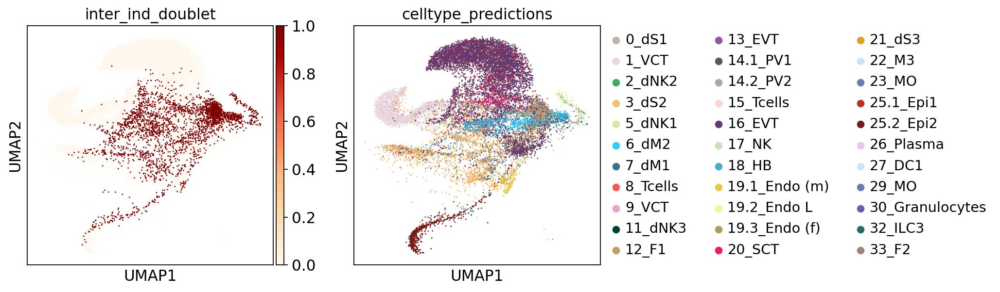

In [231]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810750'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


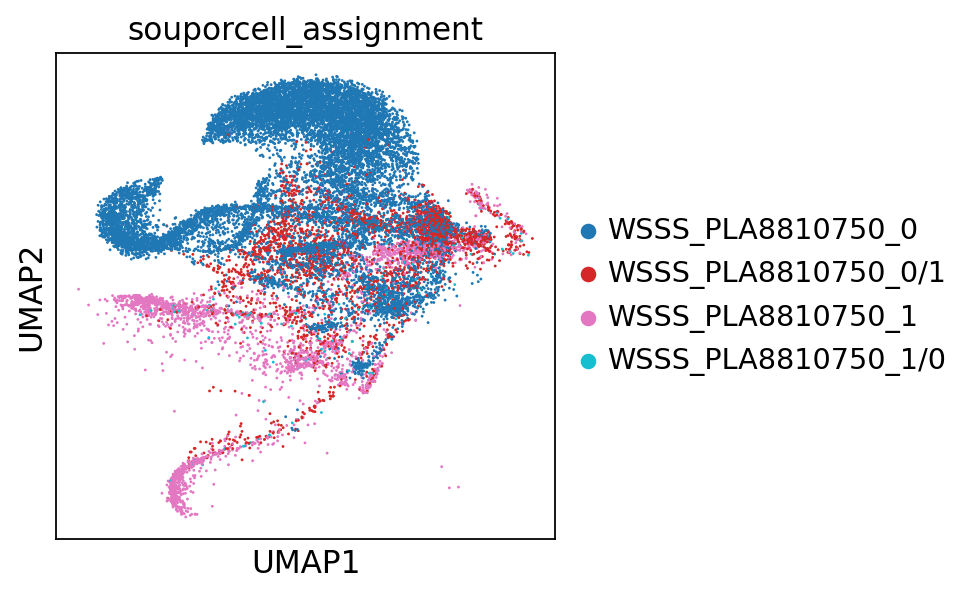

In [232]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810750'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8810750:

- 0 --> F
- 1 --> M

In [233]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810751'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8810751_0', 'WSSS_PLA8810751_0/1', 'WSSS_PLA8810751_1',
        'WSSS_PLA8810751_1/0'], dtype=object),
 array([ 1773,    93, 11666,  2872]))

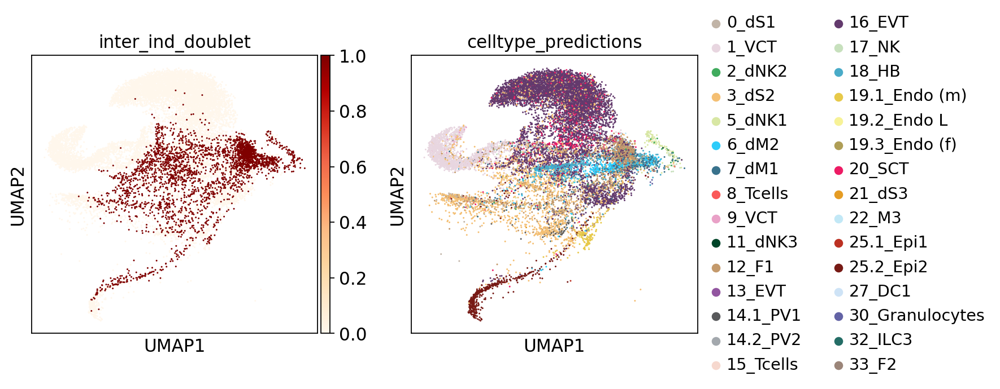

In [234]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810751'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


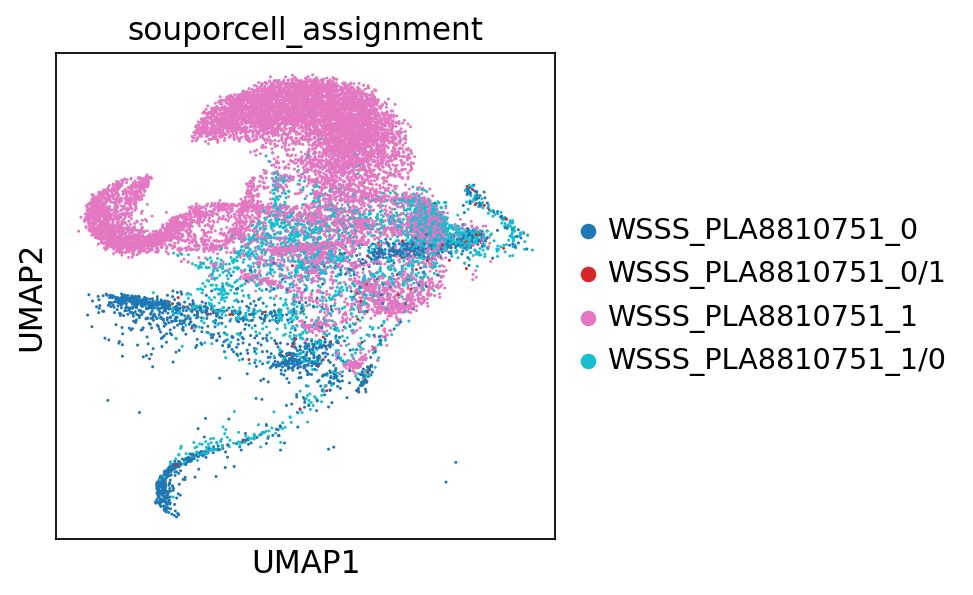

In [235]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8810751'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8810751:

- 1 --> F
- 0 --> M

In [236]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811068'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8811068_1', 'WSSS_PLA8811068_1/0'], dtype=object),
 array([13811,  1838]))

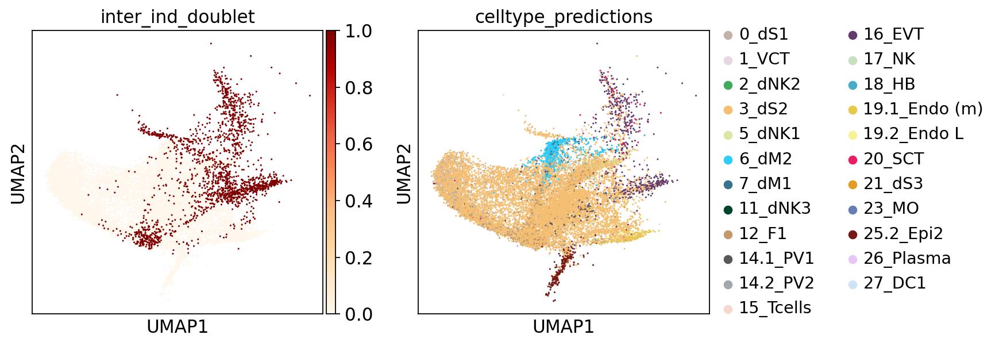

In [237]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811068'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


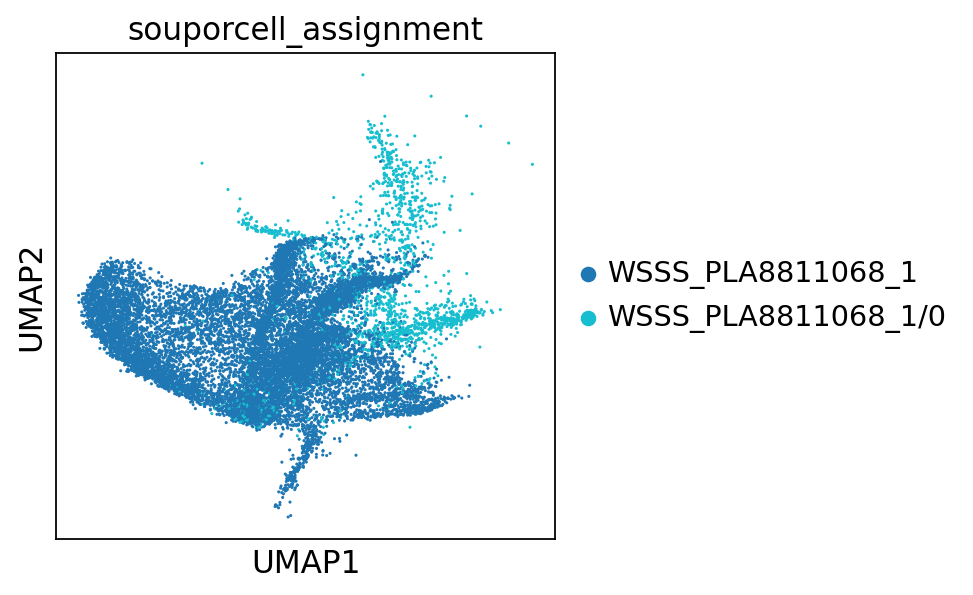

In [238]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811068'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8811068:

- rest - doublets
- 1 --> M

In [239]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811069'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8811069_0', 'WSSS_PLA8811069_0/1'], dtype=object),
 array([15074,  2121]))

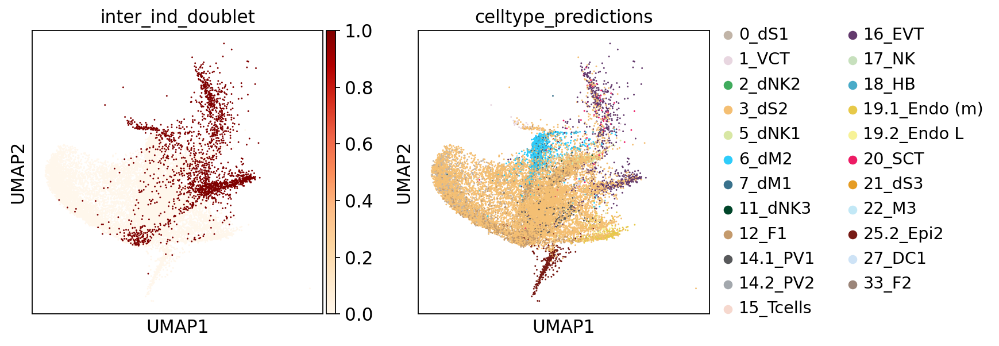

In [240]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811069'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


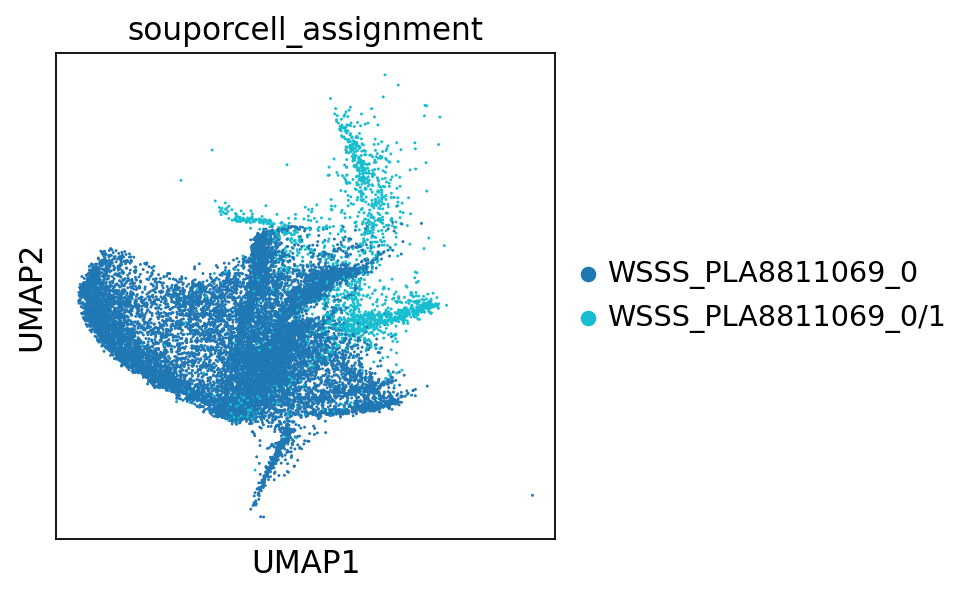

In [241]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811069'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8811069:

- 0 --> M
- rest - doublets

In [242]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811070'].obs['souporcell_assignment'], return_counts=True)

(array(['WSSS_PLA8811070_0', 'WSSS_PLA8811070_0/1'], dtype=object),
 array([8411, 1020]))

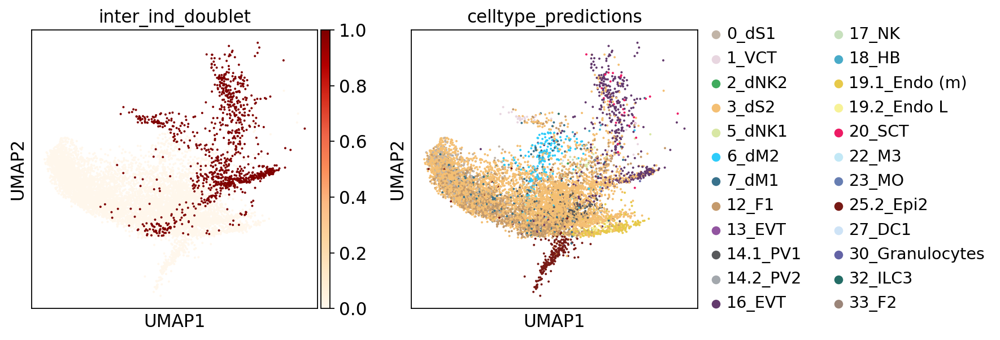

In [243]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811070'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


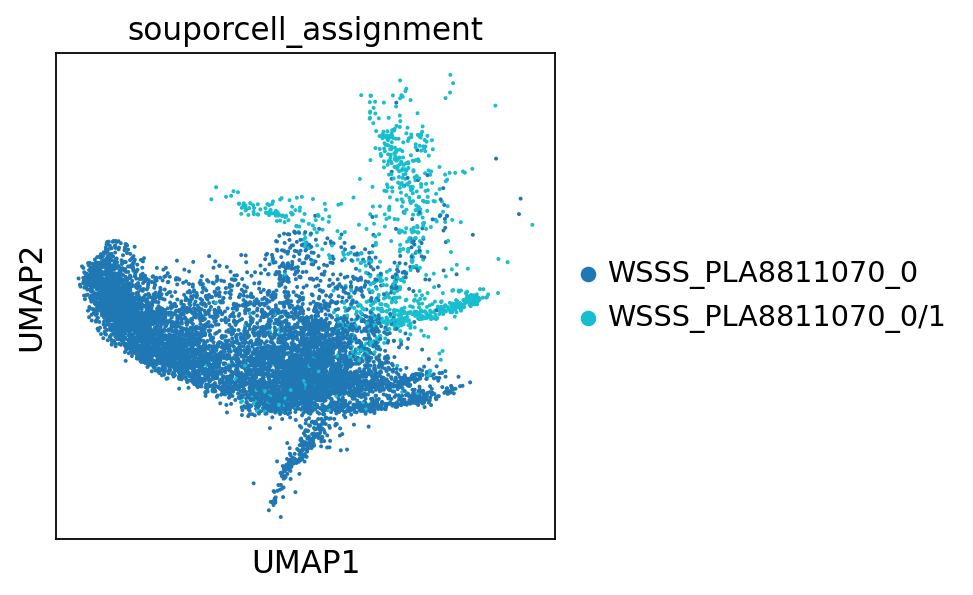

In [244]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'WSSS_PLA8811070'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample WSSS_PLA8811070:

- 0 --> M
- rest - doublets

In [245]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142863'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142863_0', 'Pla_HDBR10142863_0/1', 'Pla_HDBR10142863_1',
        'Pla_HDBR10142863_1/0'], dtype=object),
 array([3198,  359, 2753,  332]))

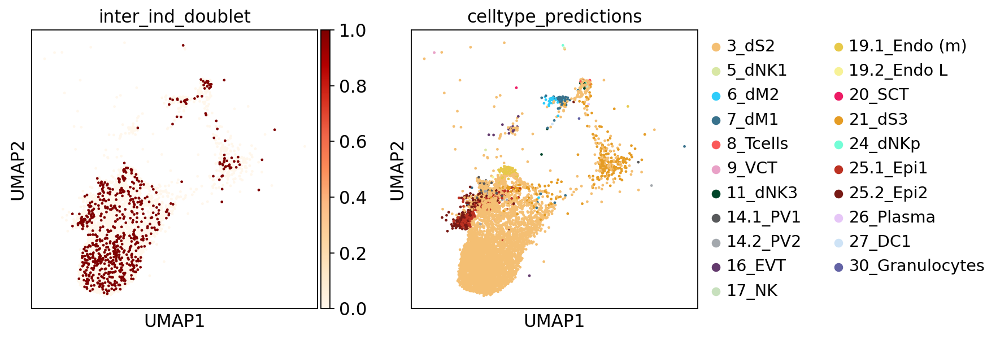

In [246]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142863'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


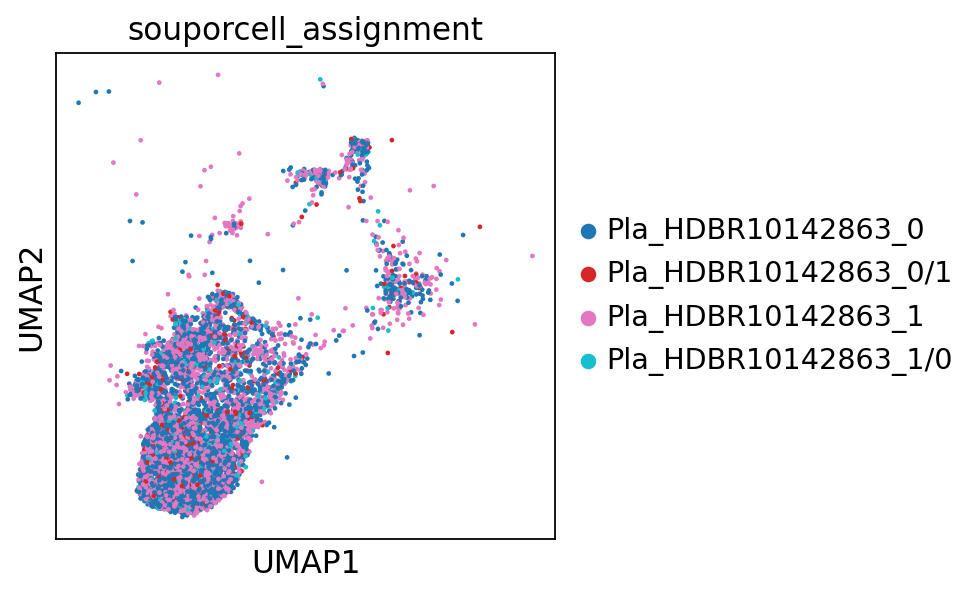

In [247]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142863'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142863:

All M

In [248]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142864'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142864_0', 'Pla_HDBR10142864_0/1', 'Pla_HDBR10142864_1',
        'Pla_HDBR10142864_1/0'], dtype=object),
 array([7789, 1215, 8047, 1289]))

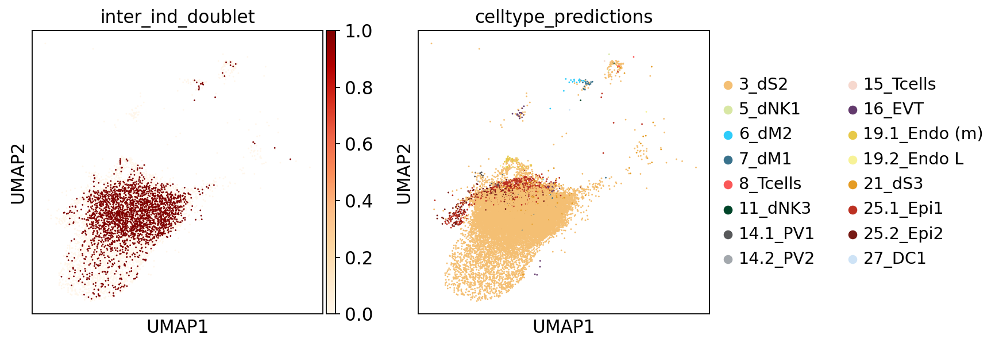

In [249]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142864'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


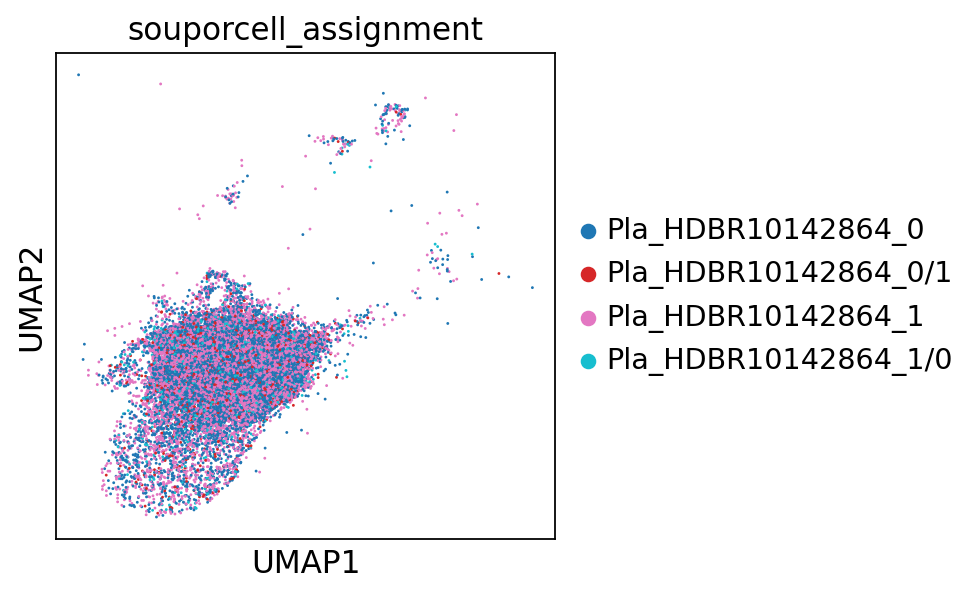

In [250]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142864'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142864:

- all M

In [251]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142865'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10142865_0', 'Pla_HDBR10142865_0/1', 'Pla_HDBR10142865_1',
        'Pla_HDBR10142865_1/0'], dtype=object),
 array([3167,  274, 3422,  229]))

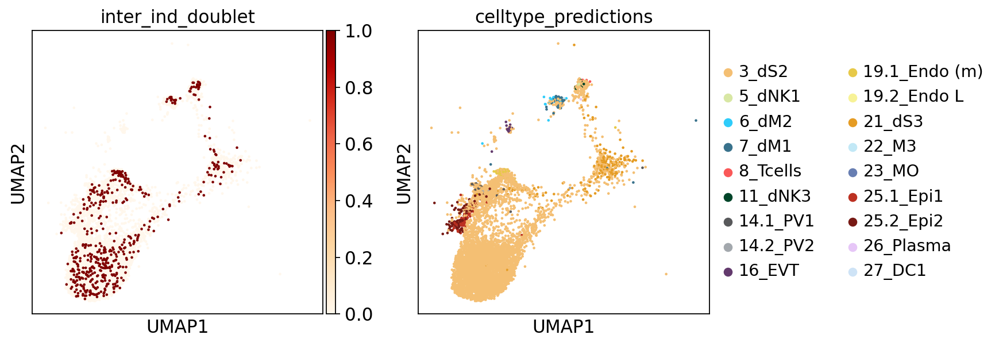

In [252]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142865'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


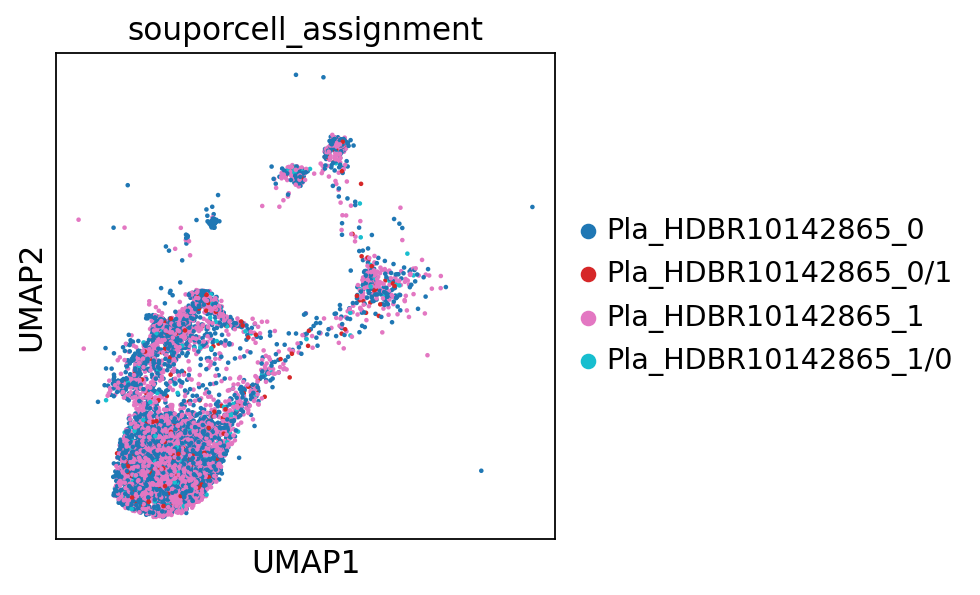

In [253]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10142865'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10142865:

- all M

In [254]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691970'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10691970_0', 'Pla_Camb10691970_0/1', 'Pla_Camb10691970_1',
        'Pla_Camb10691970_1/0'], dtype=object),
 array([9208, 1161, 1485,  459]))

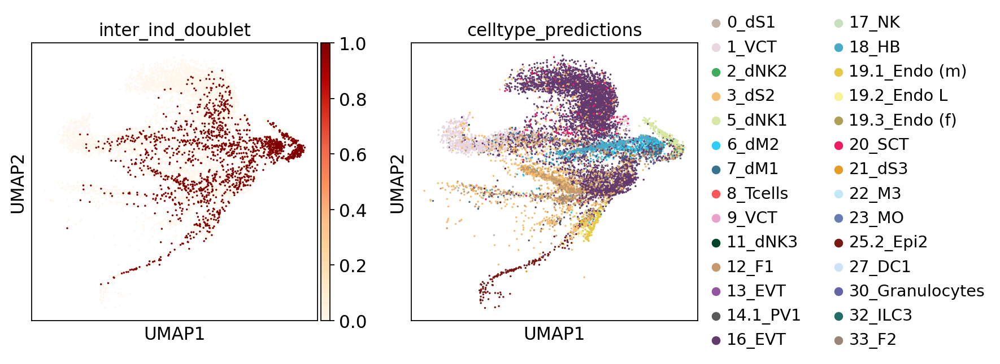

In [255]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691970'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


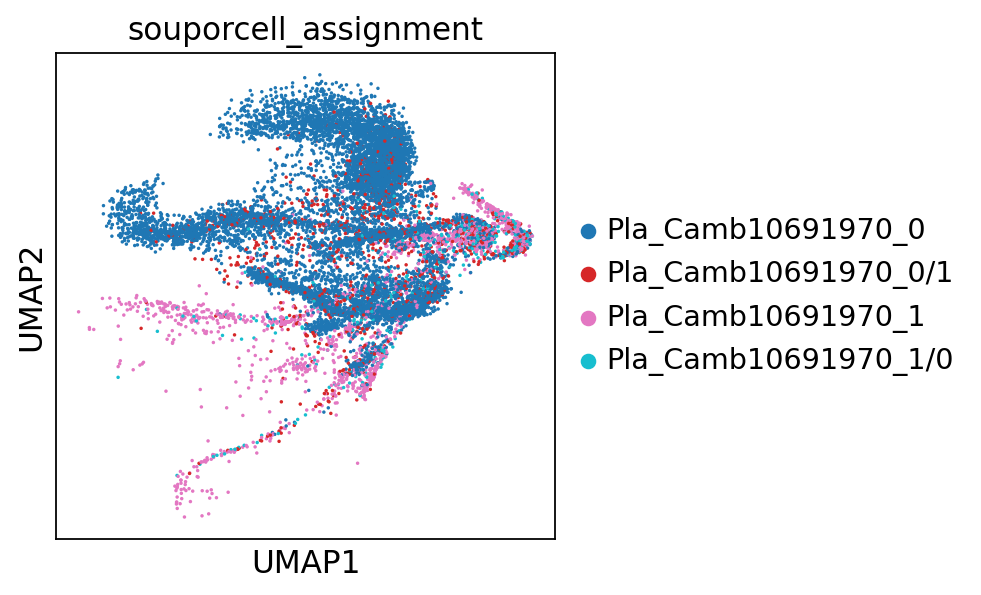

In [256]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691970'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10691970:

- 0 --> F
- 1 --> M

In [257]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691971'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10691971_0', 'Pla_Camb10691971_0/1', 'Pla_Camb10691971_1',
        'Pla_Camb10691971_1/0'], dtype=object),
 array([9180, 1276, 1561,  436]))

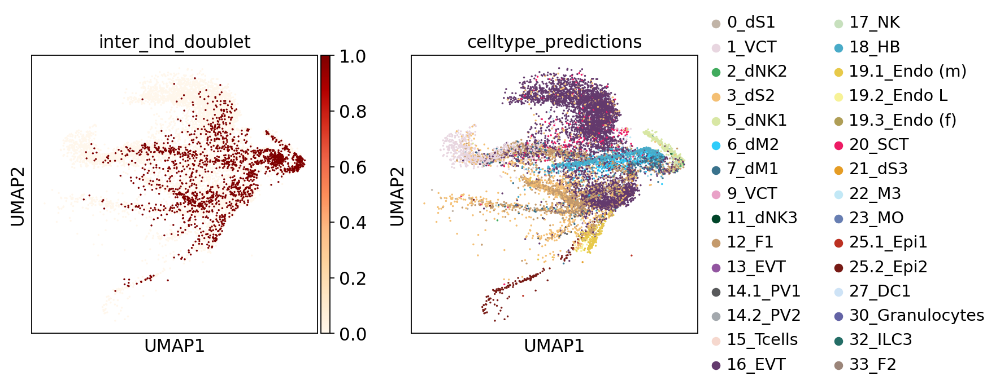

In [258]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691971'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


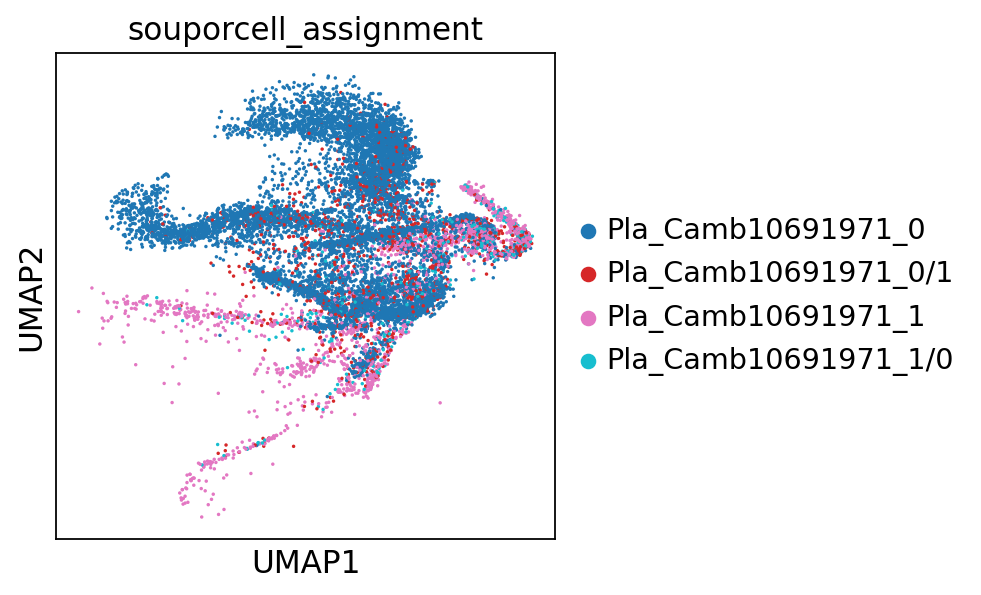

In [259]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691971'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10691971:

- 0 --> F
- 1 --> M

In [260]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691972'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10691972_0', 'Pla_Camb10691972_0/1', 'Pla_Camb10691972_1',
        'Pla_Camb10691972_1/0'], dtype=object),
 array([ 618,  134, 6042,  930]))

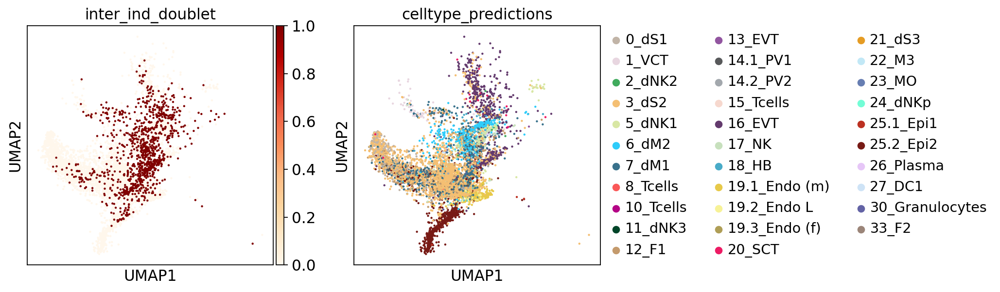

In [261]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691972'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


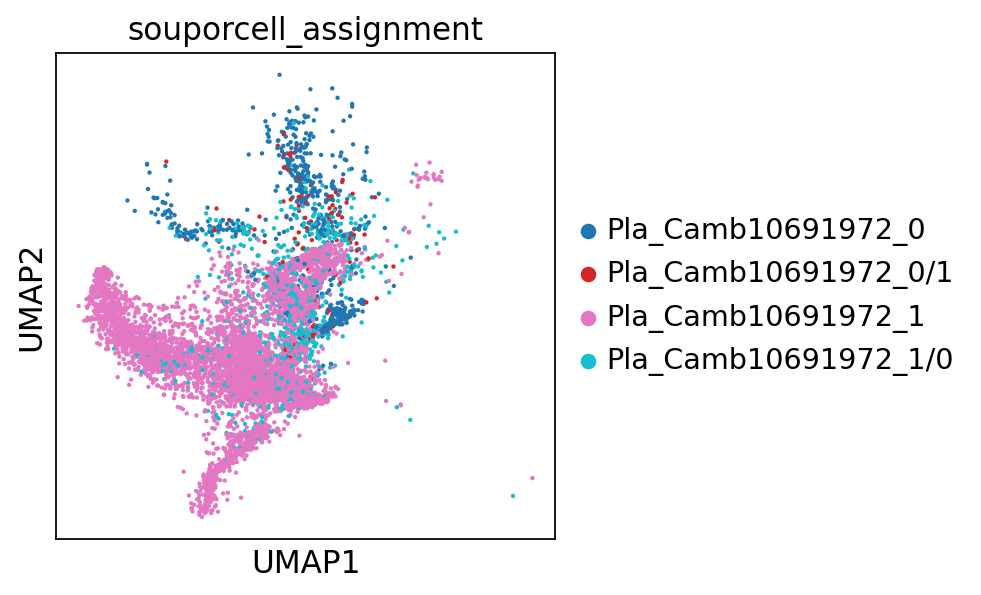

In [262]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691972'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10691972:

- 0 --> F
- 1 --> M

In [263]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701666'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_HDBR10701666_0', 'Pla_HDBR10701666_0/1', 'Pla_HDBR10701666_1',
        'Pla_HDBR10701666_1/0'], dtype=object),
 array([ 619,  163, 8576, 1322]))

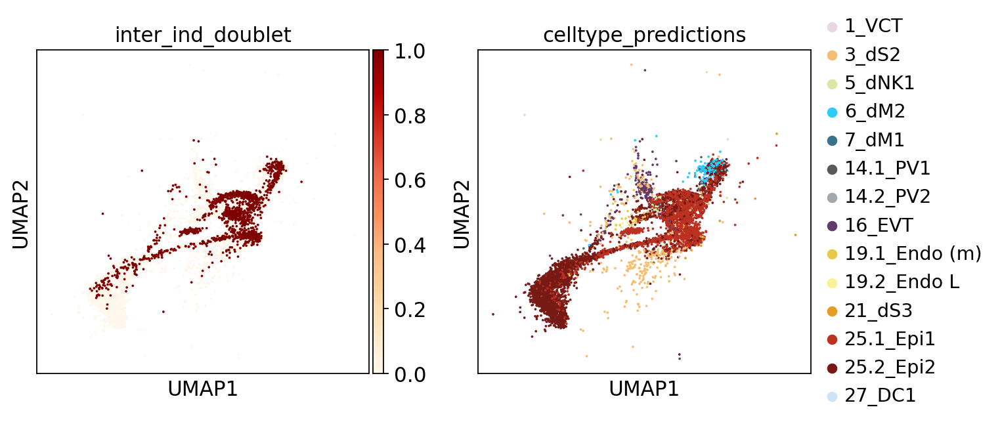

In [264]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701666'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


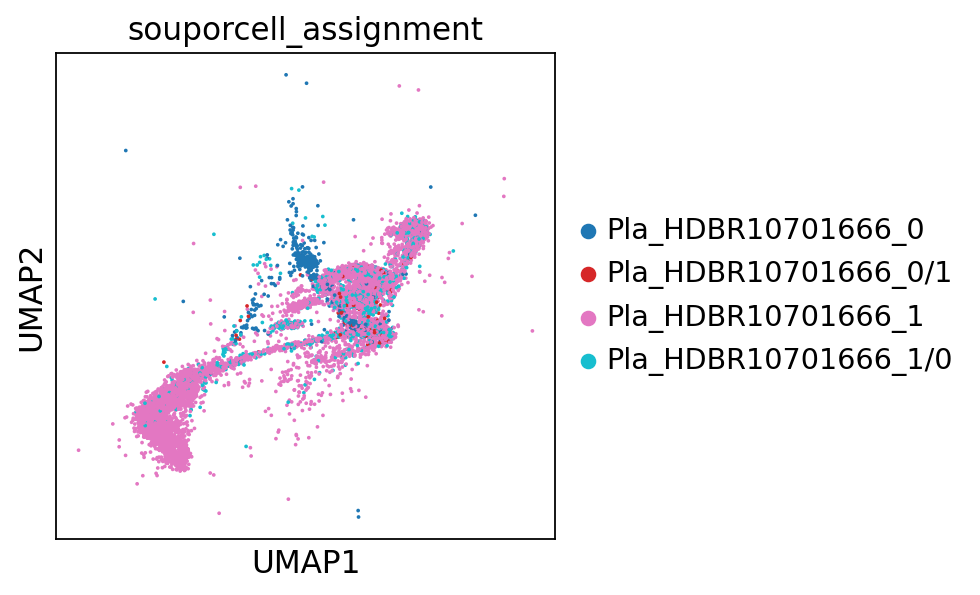

In [265]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_HDBR10701666'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_HDBR10701666:

- 0 --> F
- 1 --> M

In [266]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691975'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10691975_0', 'Pla_Camb10691975_0/1', 'Pla_Camb10691975_1',
        'Pla_Camb10691975_1/0'], dtype=object),
 array([15463,  1626,  2013,   267]))

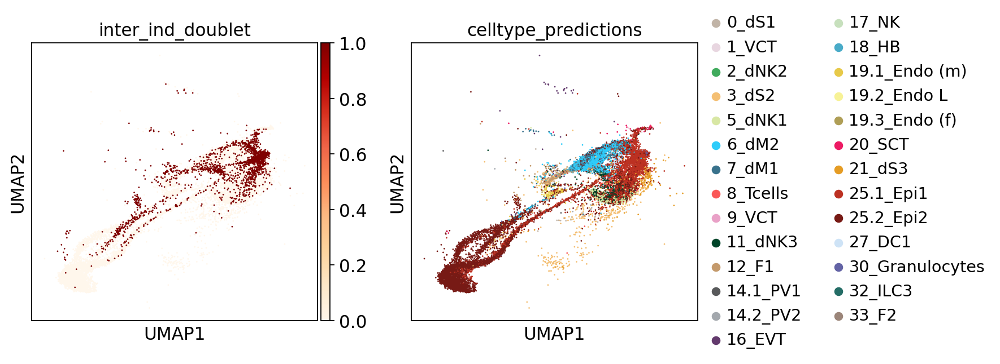

In [267]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691975'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


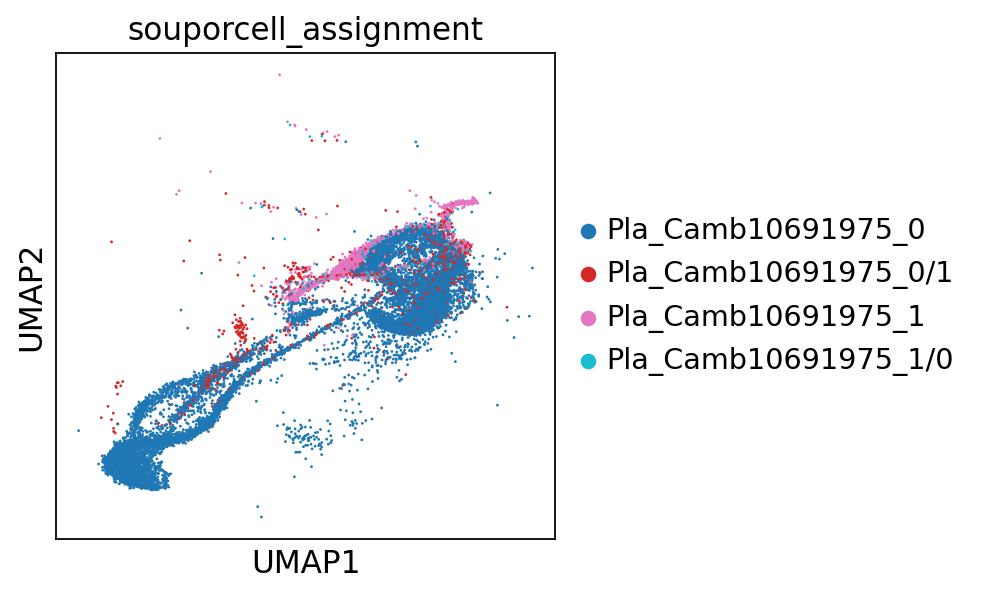

In [268]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10691975'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10691975:

- 0 --> M
- 1 --> F

In [269]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714918'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10714918_0', 'Pla_Camb10714918_0/1', 'Pla_Camb10714918_1',
        'Pla_Camb10714918_1/0'], dtype=object),
 array([3943,  441,  691,   50]))

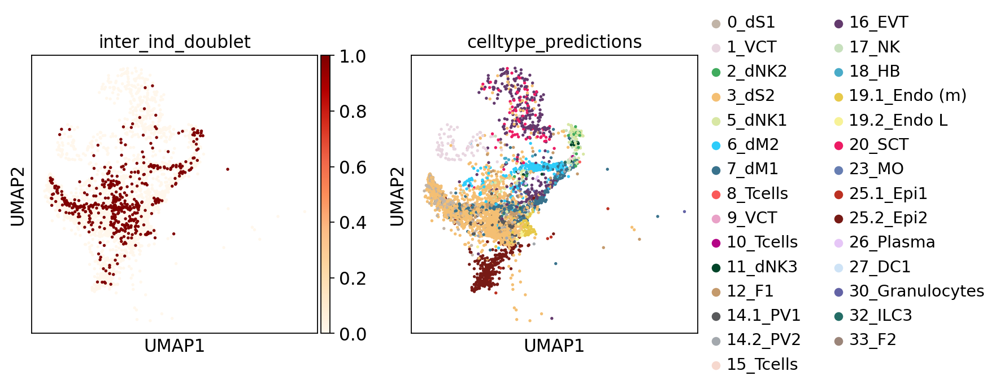

In [270]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714918'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


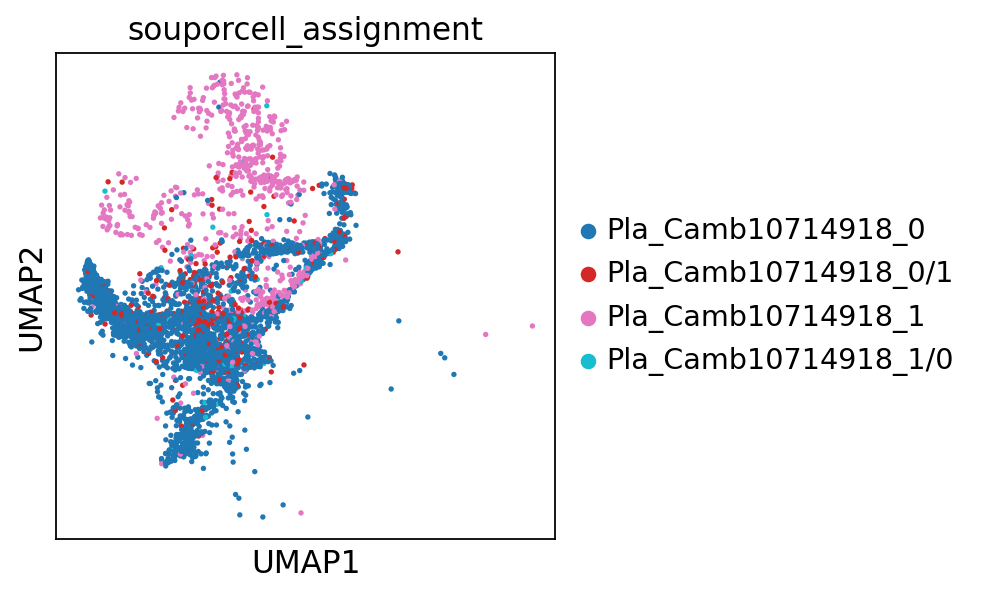

In [271]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714918'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10714918:

- 0 --> M
- 1 --> F

In [272]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714919'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10714919_0', 'Pla_Camb10714919_0/1', 'Pla_Camb10714919_1',
        'Pla_Camb10714919_1/0'], dtype=object),
 array([4293,  585, 1345,  104]))

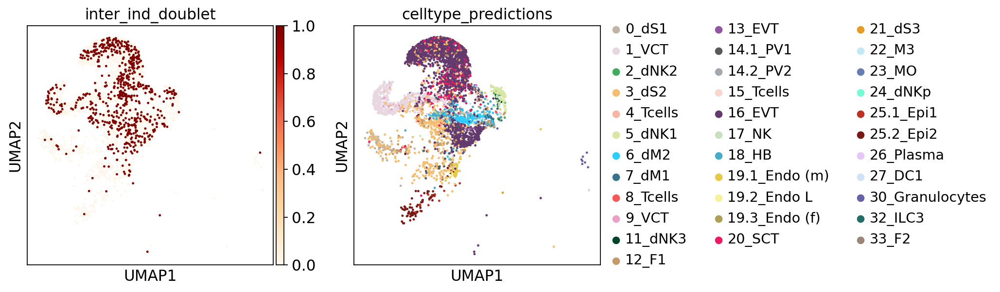

In [273]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714919'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


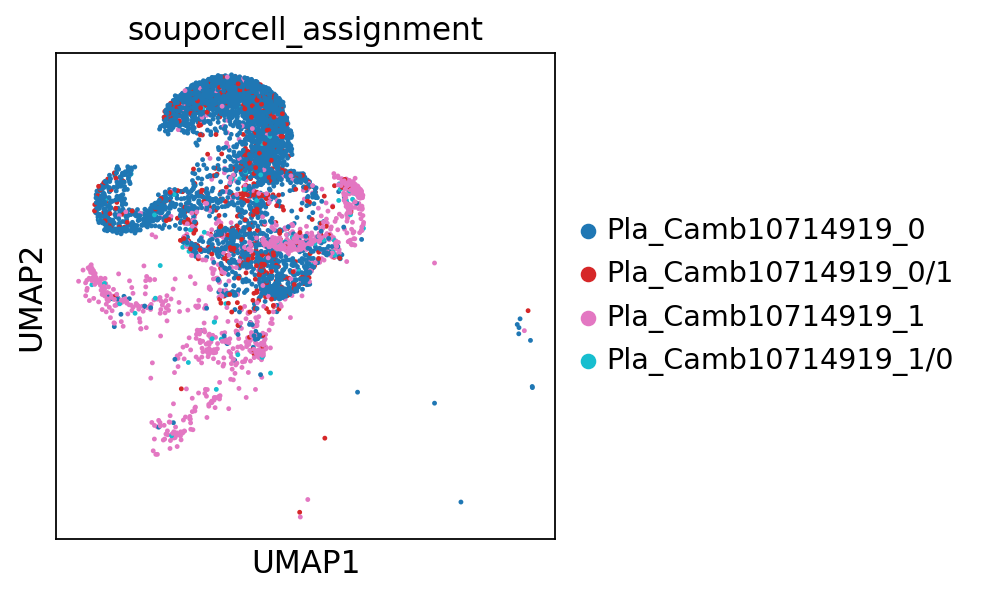

In [274]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714919'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10714919:

- 0 --> F
- 1 --> M

In [275]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714920'].obs['souporcell_assignment'], return_counts=True)

(array(['Pla_Camb10714920_0', 'Pla_Camb10714920_0/1', 'Pla_Camb10714920_1',
        'Pla_Camb10714920_1/0'], dtype=object),
 array([1500,  153, 4281,  714]))

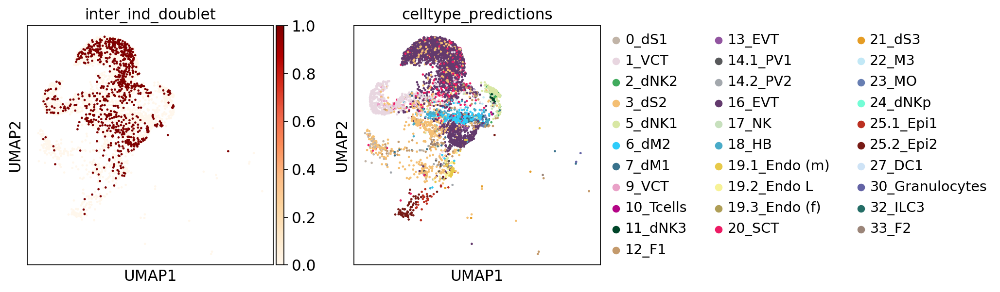

In [276]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714920'], color=['inter_ind_doublet','celltype_predictions'], 
           ncols=2,cmap='OrRd')

Trying to set attribute `.uns` of view, copying.


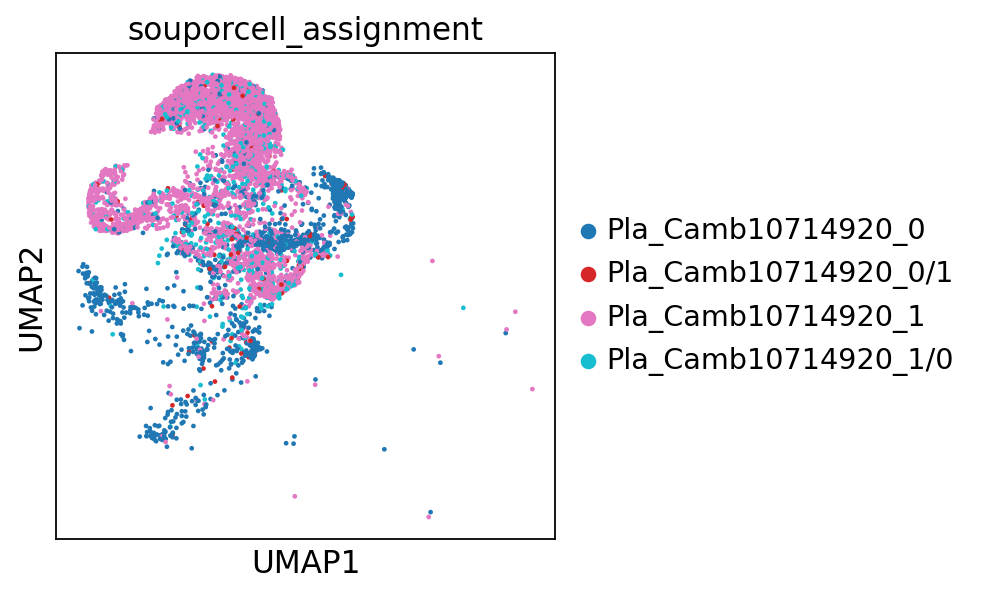

In [277]:
sc.pl.umap(adata_hvg[adata_hvg.obs['sample'] == 'Pla_Camb10714920'], color=['souporcell_assignment'], 
           ncols=2,palette='tab10')

Sample Pla_Camb10714920:

- 0 --> M
- 1 --> F

# Annotation of M/F origin of each cell OR in case of samples Pla_HDBR8715512, Pla_HDBR8715514 and Pla_HDBR8768477 - R0 or R1 assignment

In [281]:
def annot_MF(adata_obj, barcode_sample):
    curr_sample = adata_obj.obs.loc[barcode_sample,'sample']
    curr_souporcell_assignment = adata_obj.obs.loc[barcode_sample,'souporcell_assignment']
    
    if curr_sample == 'FCA7167219':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7167221':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7167222':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7167223':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7167224':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7167226':
        return('M')
    
    if curr_sample == 'FCA7167230':
        return('M')
    
    if curr_sample == 'FCA7167231':
        return('M')
    
    if curr_sample == 'FCA7167232':
        return('M')
    
    if curr_sample == 'FCA7196218':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
    
    if curr_sample == 'FCA7196219':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7196220':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
    
    if curr_sample == 'FCA7196224':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
    
    if curr_sample == 'FCA7196225':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7196226':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
    
    if curr_sample == 'FCA7196229':
        return('M')
    
    if curr_sample == 'FCA7196231':
        return('M')
    
    
    if curr_sample == 'FCA7474062':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        elif curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    
    if curr_sample == 'FCA7474063':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7474064':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7474065':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
        
    if curr_sample == 'FCA7474066':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    
    if curr_sample == 'FCA7474068':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7474069':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7511881':
        return('M')
    
    if curr_sample == 'FCA7511882':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7511883':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
    
    if curr_sample == 'FCA7511884':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7511885':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'FCA7511886':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')

        
        
    if curr_sample == 'Pla_HDBR10142767':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10142768':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10142769':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10142770':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR8624430':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR8624431':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    # these samples don't have M/F assignment but have donor R0 or R1 assignment
    if curr_sample in ['Pla_HDBR8715512','Pla_HDBR8715514','Pla_HDBR8768477']:
        return('soc_didnt_work')
    
    if curr_sample == 'Pla_HDBR10917730':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10917731':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10917733':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10701667':
        return('M')
    if curr_sample == 'Pla_HDBR10701668':
        return('M')
    
    if curr_sample == 'WSSS_PLA8764121':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8764122':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8810750':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8810751':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8811068':
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8811069':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'WSSS_PLA8811070':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10142863':
        return('M')
    if curr_sample == 'Pla_HDBR10142864':
        return('M')
    if curr_sample == 'Pla_HDBR10142865':
        return('M')
        
    if curr_sample == 'Pla_Camb10691970':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10691971':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10691972':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_HDBR10701666':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10691975':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10714918':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10714919':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('F')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('M')
        else:
            return('M_F_doublet')
        
    if curr_sample == 'Pla_Camb10714920':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('M')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('F')
        else:
            return('M_F_doublet')
    
        
    

In [282]:
np.unique(adata_hvg[adata_hvg.obs['sample'] == 'FCA7511886'].obs['souporcell_assignment'])

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


array(['FCA7511886_0', 'FCA7511886_0/1', 'FCA7511886_1', 'FCA7511886_1/0'],
      dtype=object)

In [283]:
adata_hvg.obs['origin_M_F'] = adata_hvg.obs['barcode_sample_copy'].apply(lambda x: annot_MF(adata_hvg, x))

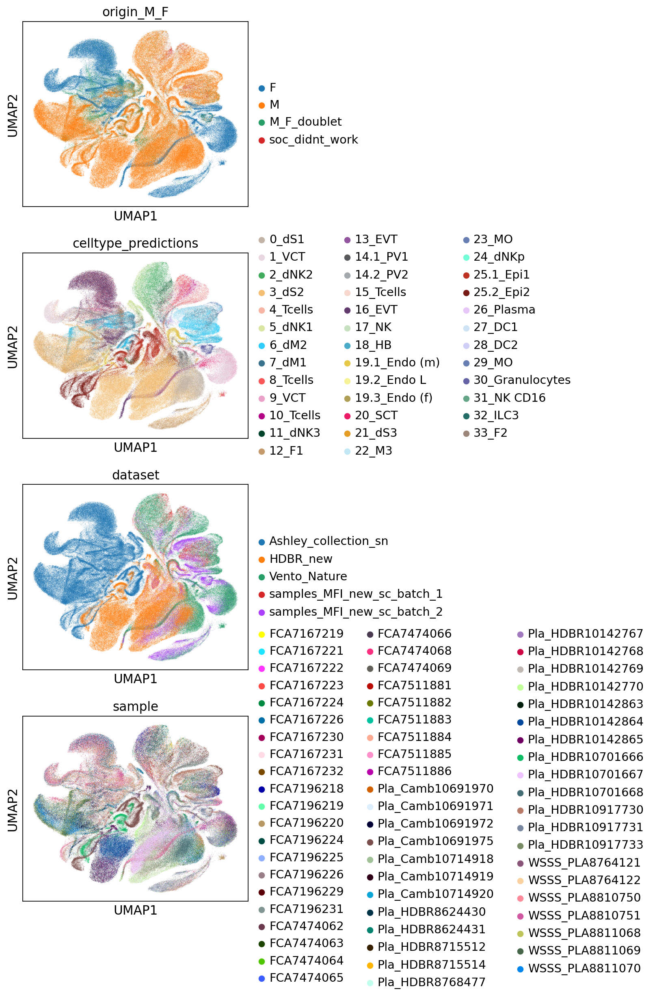

In [285]:
sc.pl.umap(adata_hvg, color=['origin_M_F', 'celltype_predictions','dataset','sample'], ncols=1)

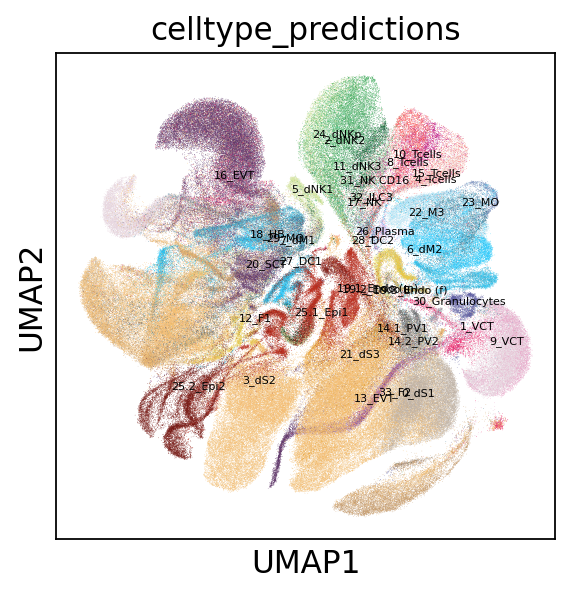

In [286]:
sc.pl.umap(adata_hvg, color=['celltype_predictions'],
          legend_loc='on data',
          legend_fontsize=5,
          legend_fontweight = 'light')

In [287]:
# also adding R0/R1 individuals assignment for samples Pla_HDBR8715512, Pla_HDBR8715514 and Pla_HDBR8768477
# instead of H2 + H9 currently

def update_donor(adata_obj, barcode):
    
    curr_sample = adata_hvg.obs.loc[barcode, 'sample']
    
    curr_donor = adata_hvg.obs.loc[barcode, 'donor']
    
    curr_souporcell_assignment = adata_hvg.obs.loc[barcode, 'souporcell_assignment']
    
    if curr_sample == 'Pla_HDBR8715512':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('R0')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('R1')
        else:
            return('R0_R1_doublet')
        
    if curr_sample == 'Pla_HDBR8715514':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('R1')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('R0')
        else:
            return('R0_R1_doublet')
        
    if curr_sample == 'Pla_HDBR8768477':
        if curr_souporcell_assignment == curr_sample + '_0':
            return('R0')
        if curr_souporcell_assignment == curr_sample + '_1':
            return('R1')
        else:
            return('R0_R1_doublet')
        
    else:
        return(curr_donor)

In [288]:
adata_hvg.obs['donor'] = adata_hvg.obs['barcode_sample_copy'].apply(lambda x: update_donor(adata_hvg, x))

In [289]:
np.unique(adata_hvg.obs['donor'], return_counts=True)

(array(['10', '11', '12', '6', '7', '8', '9', 'H2', 'Hrv100', 'Hrv43',
        'Hrv46', 'Hrv98', 'Hrv99', 'P13', 'P14', 'P34', 'R0',
        'R0_R1_doublet', 'R1'], dtype=object),
 array([17941,  3653, 15084, 13610, 10010, 22170, 17861,  6753, 15962,
        71317, 37865, 13224, 12390, 94014, 55124, 19369,  1309,    48,
         2432]))

## Labelling all the doublets so far:

- by GEX (scrublet)
- by genotype (souporcell)

At this step it's best to look at both ```is_doublet``` annotation from the 1st step of bertie doublet calling

In [292]:
adata_hvg.obs['is_doublet'] = [1 if value else 0 for value in adata_hvg.obs['is_doublet']]

In [301]:
# let's also try a lesser cutoff for bh_pval
adata_hvg.obs['is_doublet_0.05'] = adata_hvg.obs['bh_pval'] < 0.05
adata_hvg.obs['is_doublet_0.05'] = [1 if value else 0 for value in adata_hvg.obs['is_doublet_0.05']]

adata_hvg.obs['is_doublet_0.01'] = adata_hvg.obs['bh_pval'] < 0.01
adata_hvg.obs['is_doublet_0.01'] = [1 if value else 0 for value in adata_hvg.obs['is_doublet_0.01']]

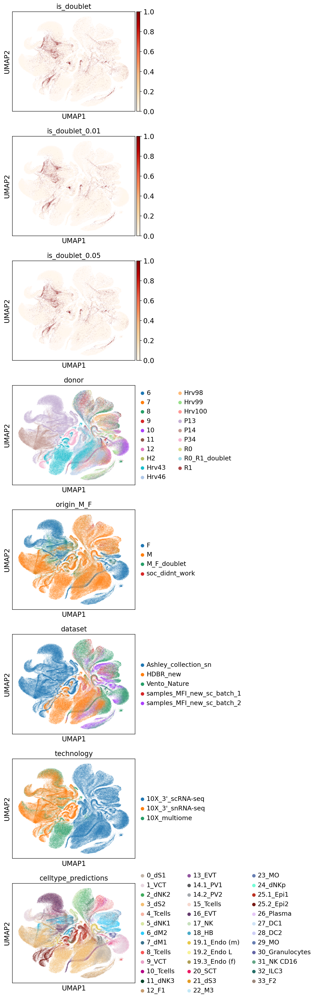

In [302]:
sc.pl.umap(adata_hvg, color=['is_doublet', # bh_pval < 0.1
                             'is_doublet_0.01','is_doublet_0.05',
                             'donor',
                             'origin_M_F',
                             'dataset',
                             'technology',
                             'celltype_predictions'], 
           ncols = 1, cmap='OrRd')

In [306]:
# doublets by GEX
np.unique(adata_hvg.obs['is_doublet'], return_counts=True)

(array([0, 1]), array([411265,  18871]))

In [307]:
# doublets by genotype: 
# from R0_R1 doublets
np.unique(adata_hvg.obs['donor'], return_counts=True)

(array(['10', '11', '12', '6', '7', '8', '9', 'H2', 'Hrv100', 'Hrv43',
        'Hrv46', 'Hrv98', 'Hrv99', 'P13', 'P14', 'P34', 'R0',
        'R0_R1_doublet', 'R1'], dtype=object),
 array([17941,  3653, 15084, 13610, 10010, 22170, 17861,  6753, 15962,
        71317, 37865, 13224, 12390, 94014, 55124, 19369,  1309,    48,
         2432]))

In [308]:
# doublets by genotype: 
# from M_F_doublets
np.unique(adata_hvg.obs['origin_M_F'], return_counts=True)

(array(['F', 'M', 'M_F_doublet', 'soc_didnt_work'], dtype=object),
 array([117102, 272804,  36441,   3789]))

In [309]:
adata_hvg_no_doublets = adata_hvg[(adata_hvg.obs['is_doublet'] == 0)
                                 & (adata_hvg.obs['donor'] != 'R0_R1_doublet')
                                 & (adata_hvg.obs['origin_M_F'] != 'M_F_doublet')].copy()

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [310]:
adata_hvg_no_doublets

AnnData object with n_obs × n_vars = 378558 × 3316
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature

In [314]:
no_doublets_table = adata_hvg_no_doublets.obs

In [315]:
no_doublets_table

,n_genes,sample,technology,tissue,dev_age,donor,dataset,run,number_of_individuals_multiplexed,batch,...,probabilities,barcode_sample_copy,souporcell_assignment,inter_ind_doublet,S_score,G2M_score,phase,origin_M_F,is_doublet_0.05,is_doublet_0.01
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AAACGGGCATTGGCGC-1_FCA7167219,1941,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGCATTGGCGC-1_FCA7167219,FCA7167219_0,0,-0.022318,-0.029351,G1,M,0,0
AAACGGGTCGCGATCG-1_FCA7167219,1246,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGTCGCGATCG-1_FCA7167219,FCA7167219_0,0,0.109294,-0.048533,S,M,0,0
AAAGATGAGCAATATG-1_FCA7167219,1516,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,0.999998,AAAGATGAGCAATATG-1_FCA7167219,FCA7167219_0,0,-0.045822,-0.097222,G1,M,0,0
AAAGATGAGTTCGCGC-1_FCA7167219,2099,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGAGTTCGCGC-1_FCA7167219,FCA7167219_0,0,-0.033310,-0.112754,G1,M,0,0
AAAGATGCATGTCGAT-1_FCA7167219,1636,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGCATGTCGAT-1_FCA7167219,FCA7167219_0,0,0.033493,-0.107313,S,M,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,2409,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.957605,TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,Pla_Camb10714920_0,0,0.008248,-0.176324,S,M,0,0
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,4129,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,1.000000,TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.073279,-0.153125,G1,F,0,0
TTTGTTGGTCACAGCG-1_Pla_Camb10714920,3116,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.989358,TTTGTTGGTCACAGCG-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.010057,-0.110007,G1,F,0,0


In [316]:
# save this and reanalyse the object without doublets
no_doublets_table.to_csv(save_path + 'selected_droplets_no_doublets_in_M1_prelim_analysis.csv')